# Description

**Latar Belakang :** Polusi udara merupakan masalah lingkungan yang terus berlanjut di Korea Selatan. Kadar polusi udara seringkali mencapai tingkat yang membahayakan kesehatan, terutama bagi kelompok rentan seperti lansia dan orang dengan kondisi kesehatan tertentu. Penelitian ini bertujuan membangun model prediksi polusi udara menggunakan kecerdasan buatan. Model ini diharapkan dapat membantu memahami dan memprediksi tingkat polusi udara di masa depan, sehingga dapat dibuat langkah-langkah yang tepat untuk melindungi kesehatan masyarakat dan membuat keputusan terkait lingkungan yang lebih baik.

**Permasalahan :** Fluktuasi tingkat kualitas udara di Korea Selatan akibat cuaca dan musim menyulitkan masyarakat mengetahui kapan terpapar polusi berbahaya dan perlu waspada. Selain itu, keterbatasan data polusi udara terkini membuat pemerintah dan lembaga lingkungan kesulitan mengambil tindakan cepat dan efektif untuk mengendalikan polusi. Penelitian ini berupaya mengatasi tantangan tersebut dengan menciptakan model prediksi yang tak hanya memahami pola polusi saat ini, tetapi juga memprediksi tingkat kualitas udara ke depannya.

**Tujuan :**
Mengembangkan model Machine Learning untuk memprediksi tingkat kualitas udara di Korea Selatan menggunakan data partikel udara (polutan) yang tersedia.

**Manfaat :**
1. Memberi tahu masyrakat kapan mereka mungkin terpapar polusi berbahaya dan kapan mereka perlu melindungi diri.
2. Membantu pemerintah dan lembaga lingkungan untuk bertindak cepat dan efektif dalam mengendalikan polusi.
3. Membantu mengurangi dampak kesehatan dan ekonomi dari polusi udara.
4. Meningkatkan kualitas hidup masyarakat di Korea Selatan.

# Import Library

In [1]:
%pip install CatBoost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 MB 8.9 MB/s eta 0:00:00


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-whitegrid')
palette_color = sns.color_palette('pastel')

# Plotly
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
pio.templates.default = "plotly_white"

import json
import datetime

from bokeh.io import output_notebook, show
from bokeh.plotting import figure
from bokeh.models.tools import HoverTool
from bokeh.models import GeoJSONDataSource
from bokeh.layouts import row
output_notebook()

# Lib to create maps
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

# To display stuff in notebook
from IPython.display import display, Markdown

# Model
from sklearn.naive_bayes import MultinomialNB
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, KFold, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from catboost import CatBoostClassifier
from sklearn import svm, metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from lightgbm import LGBMClassifier

# Evaluasi Metriks
from sklearn.metrics import classification_report, roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, precision_score, recall_score, accuracy_score, f1_score, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier

#untuk dapat melihat seluruh kolom dan baris
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# The number of numbers that will be shown after the comma.
pd.set_option('display.float_format', lambda x: '%.2f' % x)

# Mengabaikan peringatan
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

<ipython-input-2-89a910b61a4d>:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Import Dataset

**Tentang Dataset :**
Dataset yang digunakan adalah kumpulan data polusi udara yang dibuat khusus dari sumber terpercaya milik Pemerintah Metropolitan Seoul.  Data ini mencakup pengukuran polusi udara setiap jam dari 25 stasiun di Seoul dari tahun 2017 hingga 2019. Kumpulan data ini lebih dari sekadar data publik yang tersedia di 'Open Data Plaza', melainkan hasil penggabungan dan penyesuaian berbagai kumpulan data terkait polusi udara untuk menjadi sumber informasi yang komprehensif dan handal.

**Sumber Dataset (Seoul Air Pollution):** https://www.kaggle.com/datasets/bappekim/air-pollution-in-seoul

## Data Polusi

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/GreatEdu/Final Project/dataset/Measurement_summary.csv")
df.head()

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.57,127.01,0.00,0.06,0.00,1.20,73.00,57.00
1,2017-01-01 01:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.57,127.01,0.00,0.06,0.00,1.20,71.00,59.00
2,2017-01-01 02:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.57,127.01,0.00,0.06,0.00,1.20,70.00,59.00
3,2017-01-01 03:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.57,127.01,0.00,0.06,0.00,1.20,70.00,58.00
4,2017-01-01 04:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.57,127.01,0.00,0.05,0.00,1.20,69.00,61.00


In [ ]:
pd.options.display.max_colwidth = 100
params = [
    ['Measurement date', 'Tanggal dan Waktu Pengukuran', 'Tanggal dan waktu saat pengamatan dilakukan',''],
    ['Station code','Kode Stasiun','Kode stasiun tempat pengamatan dilakukan',''],
    ['Address','Alamat','Alamat tempat pengamatan dilakukan',''],
    ['Latitude','Lintang','Lintang geografis tempat pengukuran dilakukan',''],
    ['Longitude','Bujur','Bujur geografis tempat pengukuran dilakukan',''],
    ['SO2', 'Sulfur Dioksida', 'Gas yang terbentuk dari pembakaran bahan bakar fosil yang mengandung sulfur', 'ppm'],
    ['NO2', 'Nitrogen Dioksida', 'Gas berwarna coklat kemerahan yang terbentuk dari oksidasi nitrogen oksida', 'ppm'],
    ['O3', 'Konsentrasi Ozon', 'Keberadaan ozon di udara', 'ppm'],
    ['CO', 'Karbon Monoksida', 'Gas tidak berwarna dan tidak berbau hasil pembakaran karbon yang tidak sempurna', 'ppm'],
    ['PM10', 'Particulate Matter 10', 'Partikel halus dengan diameter ≤ 10 mikrometer di udara', 'ug/m3'],
    ['PM2.5', 'Particulate Matter 2.5', 'Partikel halus dengan diameter ≤ 2.5 mikrometer di udara', 'ug/m3']
]

params_df = pd.DataFrame(params, columns=['Fitur', 'Definisi', 'Deskripsi', 'Satuan'])
display(params_df)

,Fitur,Definisi,Deskripsi,Satuan
0,Measurement date,Tanggal dan Waktu Pengukuran,Tanggal dan waktu saat pengamatan dilakukan,
1,Station code,Kode Stasiun,Kode stasiun tempat pengamatan dilakukan,
2,Address,Alamat,Alamat tempat pengamatan dilakukan,
3,Latitude,Lintang,Lintang geografis tempat pengukuran dilakukan,
4,Longitude,Bujur,Bujur geografis tempat pengukuran dilakukan,
5,SO2,Sulfur Dioksida,Gas yang terbentuk dari pembakaran bahan bakar fosil yang mengandung sulfur,ppm
6,NO2,Nitrogen Dioksida,Gas berwarna coklat kemerahan yang terbentuk dari oksidasi nitrogen oksida,ppm
7,O3,Konsentrasi Ozon,Keberadaan ozon di udara,ppm
8,CO,Karbon Monoksida,Gas tidak berwarna dan tidak berbau hasil pembakaran karbon yang tidak sempurna,ppm
9,PM10,Particulate Matter 10,Partikel halus dengan diameter ≤ 10 mikrometer di udara,ug/m3


Analisis dalam penelitian ini didasarkan pada kumpulan data unik yang berisi catatan polusi udara per jam selama tiga tahun.  Data tersebut mencakup enam polutan utama (SO2, NO2, CO, O3, PM10, PM2.5).  Tidak hanya melihat polusi secara keseluruhan, peneliti juga dapat menganalisis polutan berdasarkan wilayah karena setiap distrik di Seoul memiliki stasiun pengukur sendiri.  Keunggulan ini memungkinkan untuk melihat pola polusi secara lebih detail dan spesifik untuk tiap daerah di Seoul.

## Data Lokasi Stasiun

In [ ]:
# Reading Air Pollution in Seoul
stations = pd.read_csv('/content/drive/MyDrive/GreatEdu/Final Project/dataset/Original Data/Measurement_station_info.csv')
stations.head()

,Station code,Station name(district),Address,Latitude,Longitude
0,101,Jongno-gu,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republic of Korea",37.57,127.01
1,102,Jung-gu,"15, Deoksugung-gil, Jung-gu, Seoul, Republic of Korea",37.56,126.97
2,103,Yongsan-gu,"136, Hannam-daero, Yongsan-gu, Seoul, Republic of Korea",37.54,127.00
3,104,Eunpyeong-gu,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republic of Korea",37.61,126.93
4,105,Seodaemun-gu,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul, Republic of Korea",37.59,126.95


Untuk membuat peta yang menampilkan batas-batas dari 25 distrik, kami menggunakan sebuah file GeoJSON yang tersedia di repositori GitHub https://github.com/southkorea/seoul-maps/blob/master/juso/2015/json/seoul_municipalities_geo_simple.json. File ini merupakan berkas JSON yang memiliki struktur standar khusus untuk menyimpan data geografis. Sistem referensi koordinat yang digunakan adalah WGS 84, yang juga digunakan dalam GPS.

In [ ]:
# Import geo_json with geopandas
import geopandas as gpd

seoul_geojson = gpd.read_file('/content/drive/MyDrive/GreatEdu/Final Project/seoul_municipalities_geo_simple.json')
seoul_geojson.head()

,SIG_CD,SIG_KOR_NM,SIG_ENG_NM,ESRI_PK,SHAPE_AREA,SHAPE_LEN,geometry
0,11320,도봉구,Dobong-gu,0,0.00,0.24,"POLYGON ((127.05182 37.68582, 127.05195 37.68296, 127.05124 37.68200, 127.05094 37.68010, 127.04..."
1,11380,은평구,Eunpyeong-gu,1,0.00,0.33,"POLYGON ((126.95844 37.62947, 126.95640 37.62822, 126.95523 37.62815, 126.95160 37.62656, 126.95..."
2,11230,동대문구,Dongdaemun-gu,2,0.00,0.18,"POLYGON ((127.07110 37.60733, 127.07119 37.60669, 127.07123 37.60642, 127.07124 37.60635, 127.07..."
3,11590,동작구,Dongjak-gu,3,0.00,0.24,"POLYGON ((126.95662 37.51528, 126.95731 37.51499, 126.96121 37.51347, 126.96499 37.51083, 126.96..."
4,11545,금천구,Geumcheon-gu,4,0.00,0.21,"POLYGON ((126.88105 37.48568, 126.88137 37.48557, 126.88204 37.48517, 126.88242 37.48495, 126.88..."


## Data Tingkat Polusi

In [ ]:
# Information on the dangerousness of the concentration of each gas
df_gas_info = pd.read_csv('/content/drive/MyDrive/GreatEdu/Final Project/dataset/Original Data/Measurement_item_info.csv')
df_gas_info

,Item code,Item name,Unit of measurement,Good(Blue),Normal(Green),Bad(Yellow),Very bad(Red)
0,1,SO2,ppm,0.02,0.05,0.15,1.00
1,3,NO2,ppm,0.03,0.06,0.20,2.00
2,5,CO,ppm,2.00,9.00,15.00,50.00
3,6,O3,ppm,0.03,0.09,0.15,0.50
4,8,PM10,Mircrogram/m3,30.00,80.00,150.00,600.00
5,9,PM2.5,Mircrogram/m3,15.00,35.00,75.00,500.00


# Data Preparation

In [ ]:
# Extract the district from the 'Address' column
df['Address'] = df['Address'].map(lambda street: street.split(',')[2].strip())

# Rename the columns 'Address' to 'District' and 'Measurement date' to 'Date'
df.rename(columns={'Address': 'District', 'Measurement date': 'Date'}, inplace=True)

# Convert 'Date' column to datetime format
df['Date'] = pd.to_datetime(df['Date'])

df.head()

,Date,Station code,District,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,73.00,57.00
1,2017-01-01 01:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,71.00,59.00
2,2017-01-01 02:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,70.00,59.00
3,2017-01-01 03:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,70.00,58.00
4,2017-01-01 04:00:00,101,Jongno-gu,37.57,127.01,0.00,0.05,0.00,1.20,69.00,61.00


In [ ]:
pollutants = ["SO2", "NO2", "O3", "CO", "PM10", "PM2.5"]

In [ ]:
# Checking some information of data
def check_data(df):
    List = []
    columns = df.columns
    for cols in columns:
        null_val = df[cols].isnull().sum()  # Checking the null values
        unique_val = df[cols].nunique()  # Checking the unique values
        dtypes = df[cols].dtypes  # Cheking the type of features
        List.append([cols, null_val, unique_val, dtypes])
    df_check = pd.DataFrame(List)
    df_check.columns = ["columns", "null_val", "unique_val", "dtypes"]
    return df_check

check_data(df)

,columns,null_val,unique_val,dtypes
0,Date,0,25906,datetime64[ns]
1,Station code,0,25,int64
2,District,0,25,object
3,Latitude,0,25,float64
4,Longitude,0,25,float64
5,SO2,0,186,float64
6,NO2,0,132,float64
7,O3,0,253,float64
8,CO,0,172,float64
9,PM10,0,551,float64


In [ ]:
def check_row_col(df):
    n_rows, n_cols = df.shape
    print("Jumlah baris:", n_rows)
    print("Jumlah kolom:", n_cols)

check_row_col(df)

Jumlah baris: 647511
Jumlah kolom: 11


In [ ]:
# Deskripsi statistik untuk kolom-kolom yang terkait dengan polutan
pollutant_stats = df[pollutants].describe().T.round(3)
pollutant_stats

,count,mean,std,min,25%,50%,75%,max
SO2,647511.00,-0.00,0.08,-1.00,0.00,0.00,0.01,3.74
NO2,647511.00,0.02,0.12,-1.00,0.02,0.03,0.04,38.45
O3,647511.00,0.02,0.10,-1.00,0.01,0.02,0.03,33.60
CO,647511.00,0.51,0.41,-1.00,0.30,0.50,0.60,71.70
PM10,647511.00,43.71,71.14,-1.00,22.00,35.00,53.00,3586.00
PM2.5,647511.00,25.41,43.92,-1.00,11.00,19.00,31.00,6256.00


## Anomaly Value

Pada tahap ini, data polusi udara dalam dataset mengandung sejumlah data anomali yang bernilai negatif (>0). Oleh karena itu, nilai-nilai negatif tersebut diubah menjadi NAN. Selanjutnya, nilai NAN (data yang hilang) ditangani dengan metode imputasi menggunakan nilai median dari masing-masing kolom polusi udara. Setelah itu, dilakukan pengecekan nilai duplikat dan hasilnya menunjukkan tidak ada data yang duplikat.

In [ ]:
def check_anomaly_data(df):
    anomaly_data = []

    for pollutant in pollutants:
        zero_count, percentage = calculate_percentage_less_than_zero(df, pollutant)
        anomaly_data.append({
            "Polutan": pollutant,
            "Jumlah Data Anomali": zero_count,
            "Persentase (%)": percentage
        })

    # Ubah data anomaly_data menjadi DataFrame
    anomaly_df = pd.DataFrame(anomaly_data)

    return anomaly_df  # Mengembalikan DataFrame

def calculate_percentage_less_than_zero(df, column):
    zero_count = len(df[df[column] < 0])
    percentage = (zero_count / len(df)) * 100
    return zero_count, percentage

# Jalankan fungsi
anomaly_df = check_anomaly_data(df)
anomaly_df

,Polutan,Jumlah Data Anomali,Persentase (%)
0,SO2,3976,0.61
1,NO2,3834,0.59
2,O3,4059,0.63
3,CO,4036,0.62
4,PM10,3962,0.61
5,PM2.5,3973,0.61


In [ ]:
# Ubah nilai negatif menjadi NaN
df[pollutants] = df[pollutants].where(df[pollutants] > 0, np.NaN)

# Imputasi nilai-nilai yang hilang dengan nilai median berdasarkan 'District'
df[pollutants] = df.groupby('District')[pollutants].transform(lambda x: x.fillna(x.median()))

check_row_col(df)

handled_anomaly_df = check_anomaly_data(df)
handled_anomaly_df

Jumlah baris: 647511
Jumlah kolom: 11


,Polutan,Jumlah Data Anomali,Persentase (%)
0,SO2,0,0.00
1,NO2,0,0.00
2,O3,0,0.00
3,CO,0,0.00
4,PM10,0,0.00
5,PM2.5,0,0.00


## Missing Value

In [ ]:
def get_missing_values_table(df):
    # Calculate the number of missing values
    missing_values = df.isnull().sum()

    # Calculate the percentage of missing values
    missing_values_percentage = df.isnull().sum() * 100 / len(df)

    # Combine the results into a single DataFrame
    missing_values_table = pd.concat([missing_values, missing_values_percentage], axis=1)

    # Rename the columns for clarity
    missing_values_table = missing_values_table.rename(columns={0: 'Missing Values', 1: '% of Missing Values'})

    return missing_values_table

In [ ]:
# Checking the missing value
get_missing_values_table(df)

,Missing Values,% of Missing Values
Date,0,0.00
Station code,0,0.00
District,0,0.00
Latitude,0,0.00
Longitude,0,0.00
SO2,0,0.00
NO2,0,0.00
O3,0,0.00
CO,0,0.00
PM10,0,0.00


## AQI

Menganalisis Indeks Kualitas Udara (AQI) merupakan aspek fundamental dalam ilmu data lingkungan.  Hal ini penting untuk memantau dan mengelola kualitas udara di wilayah tertentu. Penelitian ini membahas proses analisis AQI menggunakan Python, serta memberikan wawasan tentang cara efektif untuk menilai tingkat kualitas udara. Proses Analisis AQI melibatkan beberapa langkah yang bertujuan untuk memberikan representasi numerik dari keseluruhan kualitas udara. Hal ini penting dilakukan untuk kesehatan masyarakat dan pengelolaan lingkungan.

### 1. Pengumpulan Data
Data polusi udara diperoleh dari semua stasiun pengukuran di Seoul. Data ini mencakup informasi tentang polutan utama seperti SO2, NO2, O3, CO, PM10, dan PM2.5 yang dikumpulkan dari 25 stasiun pengukuran yang berbeda.

In [ ]:
df_station = df.copy()

# Set 'Date' column as the index
df_station.set_index('Date', inplace=True)
df_station.head()

,Station code,District,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
Date,,,,,,,,,,
2017-01-01 00:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,73.00,57.00
2017-01-01 01:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,71.00,59.00
2017-01-01 02:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,70.00,59.00
2017-01-01 03:00:00,101,Jongno-gu,37.57,127.01,0.00,0.06,0.00,1.20,70.00,58.00
2017-01-01 04:00:00,101,Jongno-gu,37.57,127.01,0.00,0.05,0.00,1.20,69.00,61.00


### 2. Pengolahan Data
Setelah dataset terkumpul, langkah berikutnya adalah pengolahan data. Untuk mempermudah analisis selanjutnya, kami mengubah dataset yang awalnya dicatat setiap jam menjadi format harian. Sebelum melakukan transformasi ini, kami memisahkan dataset berdasarkan stasiun pengukuran masing-masing. Selanjutnya, kami menangani beberapa nilai yang hilang dalam data harian dengan menggunakan interpolasi linear. Data yang bersih dan terstruktur dengan baik sangat penting untuk analisis AQI yang akurat.

In [ ]:
import pandas as pd

def process_data(df, pollutants):
    # Inisialisasi dictionary untuk menyimpan dataframe hasil proses
    processed_dfs = {}

    # Dapatkan daftar unik 'district'
    districtes = df['District'].unique()

    for district in districtes:
        # Filter dataframe berdasarkan 'district'
        df_district = df[df['District'] == district]

        # Hanya menyimpan kolom yang ada dalam pollutants
        df_district = df_district[pollutants]

        # Resample data menjadi harian dengan rata-rata
        df_daily = df_district.resample('D').mean().round(3)

        # Atasi nilai NaN dengan interpolasi linear
        df_daily.interpolate(method='linear', inplace=True)

        # Tambahkan kolom 'district'
        df_daily['District'] = district

        # Simpan hasil ke dictionary
        processed_dfs[district] = df_daily

    return processed_dfs

# List of pollutants
pollutants = ["SO2", "NO2", "O3", "CO", "PM10", "PM2.5"]

# Panggil fungsi process_data
processed_dfs = process_data(df_station, pollutants)

# Menampilkan hasil untuk setiap 'district'
for district, df_processed in processed_dfs.items():
    print(f"Data for {district}: {df_processed.shape}")

Data for Jongno-gu: (1095, 7)
Data for Jung-gu: (1095, 7)
Data for Yongsan-gu: (1095, 7)
Data for Eunpyeong-gu: (1095, 7)
Data for Seodaemun-gu: (1095, 7)
Data for Mapo-gu: (1095, 7)
Data for Seongdong-gu: (1095, 7)
Data for Gwangjin-gu: (1095, 7)
Data for Dongdaemun-gu: (1095, 7)
Data for Jungnang-gu: (1095, 7)
Data for Seongbuk-gu: (1095, 7)
Data for Gangbuk-gu: (1095, 7)
Data for Dobong-gu: (1095, 7)
Data for Nowon-gu: (1095, 7)
Data for Yangcheon-gu: (1095, 7)
Data for Gangseo-gu: (1095, 7)
Data for Guro-gu: (1095, 7)
Data for Geumcheon-gu: (1095, 7)
Data for Yeongdeungpo-gu: (1095, 7)
Data for Dongjak-gu: (1095, 7)
Data for Gwanak-gu: (1095, 7)
Data for Seocho-gu: (1095, 7)
Data for Gangnam-gu: (1095, 7)
Data for Songpa-gu: (1095, 7)
Data for Gangdong-gu: (1095, 7)


In [ ]:
# Contoh mengakses dataframe untuk 'Jongno-gu'
df_jongno_gu = processed_dfs['Jongno-gu']
df_jongno_gu.tail()

,SO2,NO2,O3,CO,PM10,PM2.5,District
Date,,,,,,,
2019-12-27,0.01,0.03,0.02,0.84,34.42,25.75,Jongno-gu
2019-12-28,0.00,0.05,0.01,0.77,44.50,30.46,Jongno-gu
2019-12-29,0.00,0.04,0.01,0.71,45.38,30.29,Jongno-gu
2019-12-30,0.00,0.03,0.01,0.68,38.79,28.25,Jongno-gu
2019-12-31,0.00,0.02,0.02,0.42,26.50,18.79,Jongno-gu


Setelah semua data harian dari setiap stasiun diolah dan sudah lengkap, kami menggabungkannya kembali bersama dengan detail stasiun dan lokasinya. Semua informasi ini akan disimpan dalam sebuah file CSV yang diberi nama `df_daily_pollution`.

In [ ]:
# Concatenate all DataFrames in processed_dfs
dfs_concatenated = pd.concat(processed_dfs.values(), axis=0)

# Reset index to convert 'Date' from index to a regular column
dfs_concatenated.reset_index(inplace=True)

print("Shape :", dfs_concatenated.shape)
dfs_concatenated.head()

Shape : (27375, 8)


,Date,SO2,NO2,O3,CO,PM10,PM2.5,District
0,2017-01-01,0.00,0.05,0.00,1.03,81.67,67.29,Jongno-gu
1,2017-01-02,0.01,0.05,0.02,1.02,112.17,87.17,Jongno-gu
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,Jongno-gu
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,Jongno-gu
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,Jongno-gu


In [ ]:
# Extract unique values of 'Station code', 'Latitude', and 'Longitude' based on 'district'
unique_districtes = df_station[['Station code', 'District', 'Latitude', 'Longitude']].drop_duplicates().reset_index(drop=True)

# Merge dfs_concatenated with unique_districtes based on 'district'
df_summary = pd.merge(dfs_concatenated, unique_districtes, on='District', how='left')

# Round all values in Pollutants to three decimal places
df_summary[pollutants] = df_summary[pollutants]

# Display the resulting DataFrame
df_summary.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,District,Station code,Latitude,Longitude
0,2017-01-01,0.00,0.05,0.00,1.03,81.67,67.29,Jongno-gu,101,37.57,127.01
1,2017-01-02,0.01,0.05,0.02,1.02,112.17,87.17,Jongno-gu,101,37.57,127.01
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,Jongno-gu,101,37.57,127.01
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,Jongno-gu,101,37.57,127.01
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,Jongno-gu,101,37.57,127.01


In [ ]:
check_row_col(df_summary)

Jumlah baris: 27375
Jumlah kolom: 11


In [ ]:
def download_csv(df, filename):
  df.to_csv(filename, index=False)
  print(f"CSV file '{filename}' berhasil disimpan.")

download_csv(df_summary, 'df_daily_pollution.csv')

CSV file 'df_daily_pollution.csv' berhasil disimpan.


### 3. Perhitungan AQI
Langkah berikutnya ialah melakukan perhitungan Indeks Kualitas Udara (AQI) berdasarkan data polutan udara yang telah diolah. AQI dihitung berdasarkan rumus dan pedoman standar yang telah ditetapkan oleh lembaga lingkungan. Rumus tersebut biasanya mempertimbangkan berbagai jenis polutan udara untuk mendapatkan nilai AQI yang komprehensif.

In [ ]:
df_aqi = df_summary.copy()
df_aqi = df_aqi.drop(columns=['Date', 'Station code', 'District', 'Latitude', 'Longitude'])
df_aqi.head()

,SO2,NO2,O3,CO,PM10,PM2.5
0,0.00,0.05,0.00,1.03,81.67,67.29
1,0.01,0.05,0.02,1.02,112.17,87.17
2,0.01,0.05,0.01,0.83,72.92,51.83
3,0.01,0.06,0.01,0.99,51.12,34.92
4,0.00,0.04,0.01,0.62,34.88,21.96


Indeks Kualitas Udara (CAI/AQI) digunakan untuk menyajikan tingkat kualitas udara berdasarkan risiko kesehatan dari polusi udara. Tujuan indeks ini adalah membantu masyarakat memahami dengan lebih mudah kualitas udara dan melindungi kesehatan dari efek polusi udara. Pemerintah Korea telah menetapkan standar untuk nilai polutan dan cara menghitung AQI. AQI kemudian dikelompokkan menjadi empat kategori: Baik (Biru), Sedang (Hijau), Tidak Sehat (Kuning), dan Sangat Tidak Sehat (Merah). Informasi lebih lanjut dapat ditemukan di sumber yang tercantum di bawah.

Sumber : https://airkorea.or.kr/eng/khaiInfo?PMENU_NO=166

In [ ]:
#In each tuple, first two represent concentration and last two represent
#Quality Index

so2_breakpoints = [
(0, 0.02, 0, 50), (0.021, 0.05, 51, 100), (0.051, 0.15, 101, 250), (0.141, 99999, 251, 500)
]

co_breakpoints = [
(0, 2, 0, 50), (2.1, 9, 51, 100), (9.1, 15, 101, 250), (15.1, 99999, 251, 500)
]

o3_breakpoints = [
(0, 0.03, 0, 50), (0.031, 0.09, 51, 100), (0.091, 0.15, 101, 250), (0.151, 99999, 251, 500)
]

no2_breakpoints = [
(0, 0.03, 0, 50), (0.031, 0.06, 51, 100), (0.061, 0.2, 101, 250), (0.201, 99999, 251, 500)
]

pm10_breakpoints = [
(0, 30, 0, 50), (31, 80, 51, 100), (81, 150, 101, 250), (151, 99999, 251, 500)
]

pm25_breakpoints = [
(0, 15, 0, 50), (16, 35, 51, 100), (36, 75, 101, 250), (76, 99999, 251, 500)
]

In [ ]:
def calculate_sub_index(concentration, breakpoints):
    """
    Calculate the sub-index for a pollutant given its concentration and breakpoints.
    This function is adjusted to ensure it always returns a value and does not fail
    when encountering concentrations outside the defined breakpoints.

    :param concentration: The concentration of the pollutant
    :param breakpoints: The list of breakpoints for the pollutant
    :return: The sub-index for the pollutant
    """
    for (low_conc, high_conc, low_index, high_index) in breakpoints:
        if low_conc <= concentration <= high_conc:
            return low_index + (high_index - low_index) / (high_conc - low_conc) * (concentration - low_conc)
    # If the concentration is above the highest breakpoint, return the max AQI
    return 500

In [ ]:
def calculate_aqi(row):
    """
    Calculate the AQI for a given row of the dataset.
    """
    # Convert concentration to sub-index for all pollutants
    row['pm2_5_sub_index'] = calculate_sub_index(row['PM2.5'], pm25_breakpoints)
    row['pm10_sub_index'] = calculate_sub_index(row['PM10'], pm10_breakpoints)
    row['no2_sub_index'] = calculate_sub_index(row['NO2'], no2_breakpoints)
    row['o3_sub_index'] = calculate_sub_index(row['O3'], o3_breakpoints)
    row['co_sub_index'] = calculate_sub_index(row['CO'], co_breakpoints)
    row['so2_sub_index'] = calculate_sub_index(row['SO2'], so2_breakpoints)

    # AQI is the maximum sub-index
    aqi = round(max(row['pm2_5_sub_index'], row['pm10_sub_index'], row['no2_sub_index'],
              row['o3_sub_index'], row['co_sub_index'], row['so2_sub_index']),2)
    return aqi

In [ ]:
aqi_categories = {
    (0, 50): 'Good',
    (51, 100): 'Moderate',
    (101, 250): 'Unhealthy',
    (251, 500): 'Very unhealthy',
}

def get_aqi_category(aqi):
    """
    Return the AQI category for a given AQI value.
    """
    for (low_aqi, high_aqi), category in aqi_categories.items():
        if low_aqi <= aqi <= high_aqi:
            return category
    return 'Very unhealthy'

In [ ]:
# Menjalankan perhitungan AQI dan pelabelan Kategori AQI

df_daily_aqi = df_aqi.copy()

df_daily_aqi['AQI'] = df_daily_aqi.apply(calculate_aqi, axis=1)
df_daily_aqi['AQI Category'] = df_daily_aqi['AQI'].apply(get_aqi_category)
df_daily_aqi.head()

,SO2,NO2,O3,CO,PM10,PM2.5,AQI,AQI Category
0,0.00,0.05,0.00,1.03,81.67,67.29,220.55,Unhealthy
1,0.01,0.05,0.02,1.02,112.17,87.17,251.03,Very unhealthy
2,0.01,0.05,0.01,0.83,72.92,51.83,161.49,Unhealthy
3,0.01,0.06,0.01,0.99,51.12,34.92,99.79,Moderate
4,0.00,0.04,0.01,0.62,34.88,21.96,67.90,Moderate


Visualisasi ini menunjukkan bahwa sekitar 55.8% dari kualitas udara di Seoul dalam rentang waktu 3 tahun (2017-2019) berada pada tingkat yang dapat dianggap sebagai sedang. Selain itu, sekitar 18.4% dari kualitas udara dikategorikan sebagai kurang sehat.

In [ ]:
aqi_category_distribution = df_daily_aqi['AQI Category'].value_counts(normalize=True) * 100

# Create a Pie chart using Plotly
fig = px.pie(values=aqi_category_distribution.values, names=aqi_category_distribution.index,
             title='AQI Category Distribution')

# Show the pie chart
fig.show()

Langkah berikutnya adalah mengintegrasikan dataset AQI ke dalam dataset awal untuk keperluan analisis lanjutan. Hasil gabungan ini akan disimpan dalam bentuk file CSV dengan nama `df_daily_pollution_with_aqi`.

In [ ]:
# Merge the DataFrames based on common columns
df_combine_aqi = pd.merge(df_summary, df_daily_aqi[['AQI', 'AQI Category']], left_index=True, right_index=True)

# Define the desired column order
desired_columns = ['Date', 'SO2', 'NO2', 'O3', 'CO', 'PM10', 'PM2.5', 'AQI', 'AQI Category', 'Station code', 'District', 'Latitude', 'Longitude']

# Reorder the columns
df_combine_aqi = df_combine_aqi.reindex(columns=desired_columns)

# Round all values in Pollutants to three decimal places
df_combine_aqi[pollutants] = df_combine_aqi[pollutants].round(3)

# Display the combined DataFrame
df_combine_aqi.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,AQI Category,Station code,District,Latitude,Longitude
0,2017-01-01,0.00,0.05,0.00,1.03,81.67,67.29,220.55,Unhealthy,101,Jongno-gu,37.57,127.01
1,2017-01-02,0.01,0.05,0.02,1.02,112.17,87.17,251.03,Very unhealthy,101,Jongno-gu,37.57,127.01
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,Unhealthy,101,Jongno-gu,37.57,127.01
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,Moderate,101,Jongno-gu,37.57,127.01
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,Moderate,101,Jongno-gu,37.57,127.01


In [ ]:
check_data(df_combine_aqi)

,columns,null_val,unique_val,dtypes
0,Date,0,1095,datetime64[ns]
1,SO2,0,37,float64
2,NO2,0,86,float64
3,O3,0,94,float64
4,CO,0,675,float64
5,PM10,0,3687,float64
6,PM2.5,0,2881,float64
7,AQI,0,3543,float64
8,AQI Category,0,4,object
9,Station code,0,25,int64


In [ ]:
check_row_col(df_combine_aqi)

Jumlah baris: 27375
Jumlah kolom: 13


In [ ]:
get_missing_values_table(df_combine_aqi)

,Missing Values,% of Missing Values
Date,0,0.00
SO2,0,0.00
NO2,0,0.00
O3,0,0.00
CO,0,0.00
PM10,0,0.00
PM2.5,0,0.00
AQI,0,0.00
AQI Category,0,0.00
Station code,0,0.00


In [ ]:
check_anomaly_data(df_combine_aqi)

,Polutan,Jumlah Data Anomali,Persentase (%)
0,SO2,0,0.00
1,NO2,0,0.00
2,O3,0,0.00
3,CO,0,0.00
4,PM10,0,0.00
5,PM2.5,0,0.00


In [ ]:
# Main data summary
df_summary = df_combine_aqi.copy()
df_summary = df_summary.iloc[:,1:8] # Kolom SO2 sampai AQI

data_description = df_summary.describe().iloc[1:, :].round(3)
display(data_description.T.style.background_gradient())

,mean,std,min,25%,50%,75%,max
SO2,0.004000,0.003000,0.001000,0.003000,0.004000,0.005000,0.230000
NO2,0.029000,0.029000,0.003000,0.019000,0.026000,0.037000,3.698000
O3,0.024000,0.020000,0.001000,0.014000,0.023000,0.033000,2.395000
CO,0.523000,0.235000,0.100000,0.375000,0.479000,0.622000,15.117000
PM10,44.386000,50.101000,1.625000,25.583000,37.750000,54.625000,3454.583000
PM2.5,25.810000,21.210000,1.042000,13.833000,21.208000,31.875000,542.375000
AQI,113.480000,113.123000,16.670000,56.070000,73.350000,108.885000,500.000000


## Duplicate Value

In [ ]:
# Check for Duplication
print("The number of duplicated value in data:\n", df_combine_aqi.duplicated().sum())

The number of duplicated value in data:
 0


In [ ]:
download_csv(df_combine_aqi, 'df_daily_pollution_with_aqi.csv')

CSV file 'df_daily_pollution_with_aqi.csv' berhasil disimpan.


## Outlier Value

In [ ]:
def create_boxplot(df, pollutants, title='Boxplot of Air Pollutants in Seoul', yaxis_title='Concentration (µg/m³)', height=500, width=1100):
    fig = go.Figure()

    for pollutant in pollutants:
        fig.add_trace(go.Box(y=df[pollutant], name=pollutant))

    fig.update_layout(title=title,
                      yaxis_title=yaxis_title,
                      height=height,
                      width=width)
    fig.show()

pollutants = ["SO2", "NO2", "O3", "CO", "PM10", "PM2.5", "AQI"]  # Ganti dengan nama kolom polutan yang sesuai di df
create_boxplot(df_combine_aqi, pollutants)

In [ ]:
def handle_outliers_iqr(df, columns):
    for column_name in columns:
        if column_name in df.columns:
            Q1 = df[column_name].quantile(0.25)
            Q3 = df[column_name].quantile(0.75)
            IQR = Q3 - Q1

            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR

            df.loc[df[column_name] < lower_bound, column_name] = lower_bound
            df.loc[df[column_name] > upper_bound, column_name] = upper_bound
        else:
            print(f"Column '{column_name}' not found in DataFrame")

    return df

# Contoh penggunaan fungsi
handled_df = handle_outliers_iqr(df_combine_aqi, pollutants)
create_boxplot(handled_df, pollutants)

In [ ]:
handled_df.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,AQI Category,Station code,District,Latitude,Longitude
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,Unhealthy,101,Jongno-gu,37.57,127.01
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,Very unhealthy,101,Jongno-gu,37.57,127.01
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,Unhealthy,101,Jongno-gu,37.57,127.01
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,Moderate,101,Jongno-gu,37.57,127.01
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,Moderate,101,Jongno-gu,37.57,127.01


## Final Dataset

In [ ]:
download_csv(handled_df, 'df_final.csv')

CSV file 'df_final.csv' berhasil disimpan.


# EDA

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/GreatEdu/Final Project/dataset/df_final.csv")
df['Date'] = pd.to_datetime(df['Date'])
df.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,AQI Category,Station code,District,Latitude,Longitude
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,Unhealthy,101,Jongno-gu,37.57,127.01
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,Very unhealthy,101,Jongno-gu,37.57,127.01
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,Unhealthy,101,Jongno-gu,37.57,127.01
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,Moderate,101,Jongno-gu,37.57,127.01
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,Moderate,101,Jongno-gu,37.57,127.01


In [ ]:
# Separate numeric and categorical features
df_numeric = df.select_dtypes(include=['int', 'float'])
df_categoric = df.select_dtypes(include=['object'])

In [ ]:
df_numeric.head()

,SO2,NO2,O3,CO,PM10,PM2.5,AQI,Station code,Latitude,Longitude
0,0.00,0.05,0.00,0.99,81.67,58.94,188.11,101,37.57,127.01
1,0.01,0.05,0.02,0.99,98.19,58.94,188.11,101,37.57,127.01
2,0.01,0.05,0.01,0.83,72.92,51.83,161.49,101,37.57,127.01
3,0.01,0.06,0.01,0.99,51.12,34.92,99.79,101,37.57,127.01
4,0.00,0.04,0.01,0.62,34.88,21.96,67.90,101,37.57,127.01


In [ ]:
df_categoric.head()

,AQI Category,District
0,Unhealthy,Jongno-gu
1,Very unhealthy,Jongno-gu
2,Unhealthy,Jongno-gu
3,Moderate,Jongno-gu
4,Moderate,Jongno-gu


## Analisis Numerikal

In [ ]:
numeric_columns = df_numeric.iloc[:,:7]
numeric_columns.head()

,SO2,NO2,O3,CO,PM10,PM2.5,AQI
0,0.00,0.05,0.00,0.99,81.67,58.94,188.11
1,0.01,0.05,0.02,0.99,98.19,58.94,188.11
2,0.01,0.05,0.01,0.83,72.92,51.83,161.49
3,0.01,0.06,0.01,0.99,51.12,34.92,99.79
4,0.00,0.04,0.01,0.62,34.88,21.96,67.90


In [ ]:
def plot_histograms_with_stats(df, num_cols, nrows=3, ncols=3, figsize=(15, 12)):

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)

    # Flatten the axes for easy iteration
    axes = axes.flatten()

    # Plot histograms for each numeric feature
    for i, column in enumerate(num_cols):
        # Plot the histogram with KDE
        sns.histplot(df[column], kde=True, ax=axes[i])

        # Calculate statistics
        mean = df[column].mean()
        median = df[column].median()
        std = df[column].std()

        # Add annotations for statistics
        axes[i].axvline(mean, color='r', linestyle='--', label=f'Mean: {mean:.3f}')
        axes[i].axvline(median, color='g', linestyle='-', label=f'Median: {median:.3f}')
        axes[i].axvline(mean + std, color='b', linestyle='--', label=f'Std Dev: {std:.3f}')
        axes[i].axvline(mean - std, color='b', linestyle='--')

        # Add title and labels
        axes[i].set_title(f'Distribution Plot of {column}')
        axes[i].set_xlabel(column)
        axes[i].set_ylabel('Frequency')

        # Add legend
        axes[i].legend()

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    # Adjust layout
    plt.tight_layout()
    plt.show()

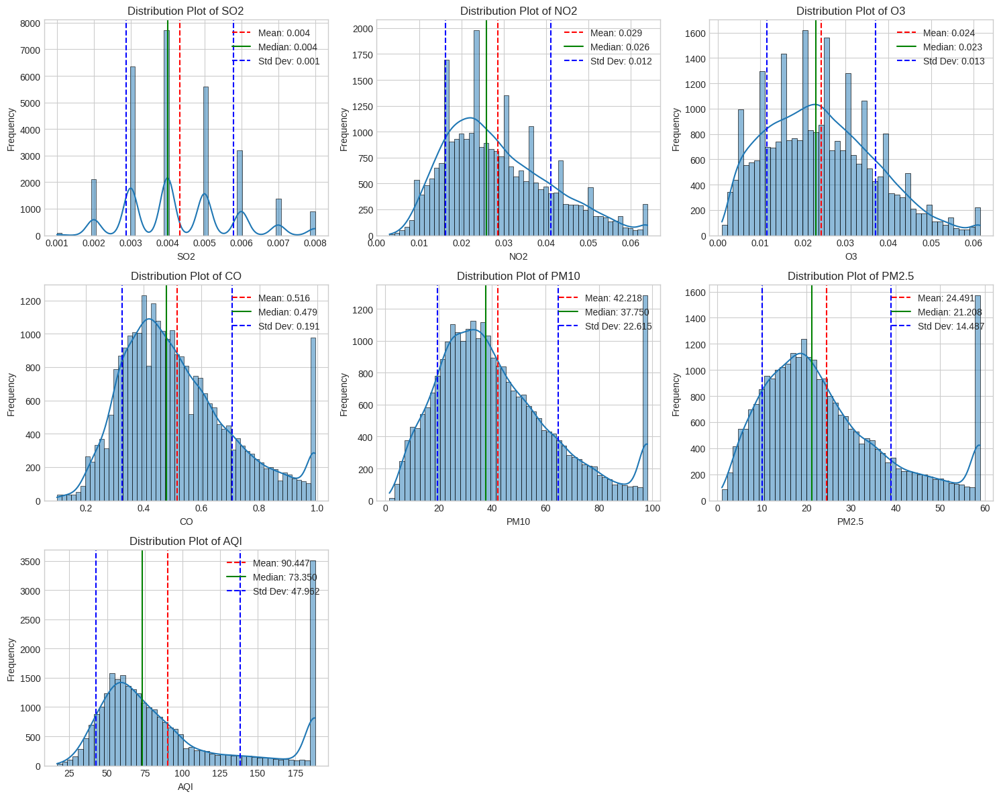

In [ ]:
plot_histograms_with_stats(df, numeric_columns)

Analisis hisplot menunjukkan distribusi frekuensi dari berbagai jenis polusi udara, sebagai berikut:
- SO2
  1. Distribusi SO2 condong ke kanan.
  2. Nilai SO2 maksimum yang diamati adalah sekitar 0.008 ppm.

- NO2
  1. Distribusi NO2 condong ke kanan.
  2. Nilai NO2 maksimum yang diamati adalah sekitar 0,06 ppm.

- O3
  1. Distribusi O3 condong ke kanan.
  2. Nilai O3 maksimum yang diamati adalah sekitar 0,06 ppm.

- CO
  1. Distribusi CO condong ke kanan.
  2. Nilai CO maksimum yang diamati adalah sekitar 1,2 ppm.

- PM10
  1. Distribusi PM10 condong ke kanan.
  2. Nilai PM10 maksimum yang diamati adalah sekitar 100 µg/m³.

- PM2.5
  1. Distribusi PM2.5 condong ke kanan.
  2. Nilai PM2.5 maksimum yang diamati adalah sekitar 60 µg/m³.

- AQI
  1. Distribusi AQI condong ke kanan.
  2. Nilai AQI maksimum yang diamati adalah sekitar 175.

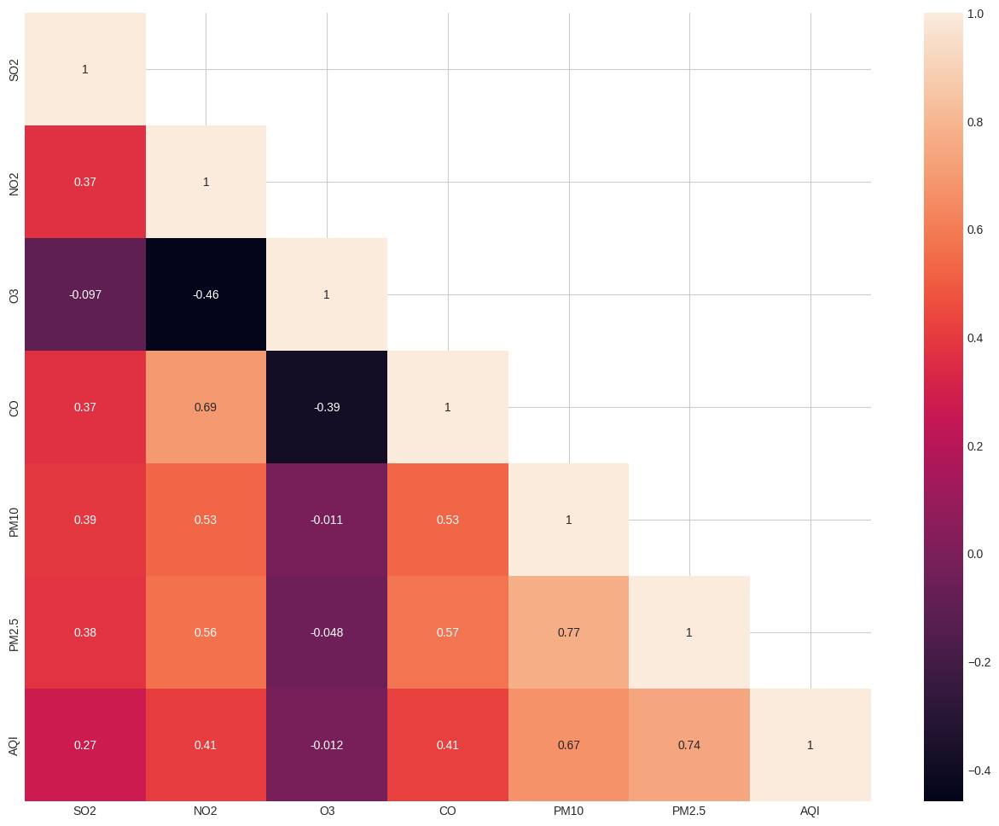

In [ ]:
# Looking at entire correlation table
plt.figure(figsize=(16,12))
correlation_matrix = numeric_columns.corr().round(3)
sns.heatmap(correlation_matrix, mask=np.triu(correlation_matrix, 1), annot=True, annot_kws={"size": 10})
plt.show()

Analisis heatmap menunjukkan hubungan antara berbagai parameter polusi udara dan AQI sebagai berikut:
1. Semua polusi udara, kecuali O3, menunjukkan korelasi positif dengan AQI. O3 memiliki korelasi negatif yang paling rendah, yaitu -0.012, artinya semakin tinggi konsentrasi O3, AQI cenderung menurun.
2. PM2.5 dan PM10 memiliki korelasi yang cukup tinggi dengan AQI, dengan nilai korelasi berturut-turut sebesar 0.74 dan 0.67. Hal ini menunjukkan bahwa peningkatan konsentrasi PM2.5 dan PM10 cenderung meningkatkan nilai AQI, yang mengindikasikan buruknya kualitas udara.
3. PM2.5 juga memiliki korelasi tinggi dengan PM10, dengan nilai korelasi sebesar 0.77. Ini menunjukkan bahwa konsentrasi PM2.5 dan PM10 cenderung bergerak bersamaan atau saling mempengaruhi secara signifikan.
4. CO memiliki korelasi tinggi dengan NO2, dengan nilai korelasi sebesar 0.69. Ini menunjukkan adanya hubungan yang kuat antara konsentrasi CO dan NO2 dalam mempengaruhi nilai AQI.
5. O3 menunjukkan korelasi negatif terhadap semua parameter polusi udara yang lain. Hal ini menunjukkan bahwa peningkatan konsentrasi O3 cenderung berdampak negatif terhadap nilai AQI dan kualitas udara secara umum.

In [ ]:
# Let's select features where the correlation with 'AQI' is higher than |0.3|
# -1 because the latest row is AQI
df_num_corr = numeric_columns.corr()["AQI"][:-1]

# Correlated features (r2 > 0.5)
high_corr_mask = abs(df_num_corr) >= 0.5
high_features_list = df_num_corr[high_corr_mask].sort_values(ascending=False)
print(f"{len(high_features_list)} strongly correlated values with AQI:\n{high_features_list}\n")

# Correlated features (0.2 < r2 < 0.5)
low_corr_mask = (abs(df_num_corr) < 0.5) & (abs(df_num_corr) >= 0.2)
low_features_list = df_num_corr[low_corr_mask].sort_values(ascending=False)
print(f"{len(low_features_list)} slightly correlated values with AQI:\n{low_features_list}")

2 strongly correlated values with AQI:
PM2.5   0.74
PM10    0.67
Name: AQI, dtype: float64

3 slightly correlated values with AQI:
CO    0.42
NO2   0.41
SO2   0.27
Name: AQI, dtype: float64


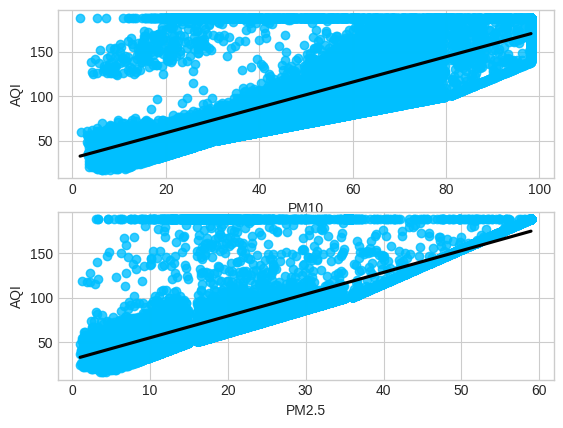

In [ ]:
# Features with high correlation (higher than 0.5)
strong_features = df_num_corr[abs(df_num_corr) >= 0.5].index.tolist()
strong_features.append("AQI")

df_strong_features = numeric_columns.loc[:, strong_features]

plt.style.use("seaborn-whitegrid")  # define figures style
fig, ax = plt.subplots(round(len(strong_features) / 2), 1)

for i, ax in enumerate(fig.axes):
    # plot the correlation of each feature with AQI
    if i < len(strong_features)-1:
        sns.regplot(
            x=strong_features[i],
            y="AQI",
            data=df_strong_features,
            ax=ax,
            scatter_kws= {"color": "deepskyblue"},
            line_kws={"color": "black"}
        )

In [ ]:
# Scatter plot menggunakan Plotly Express
fig = px.scatter(df, x='AQI', y='PM2.5', title='Scatter Plot of AQI vs PM2.5', color='AQI Category')
fig.show()

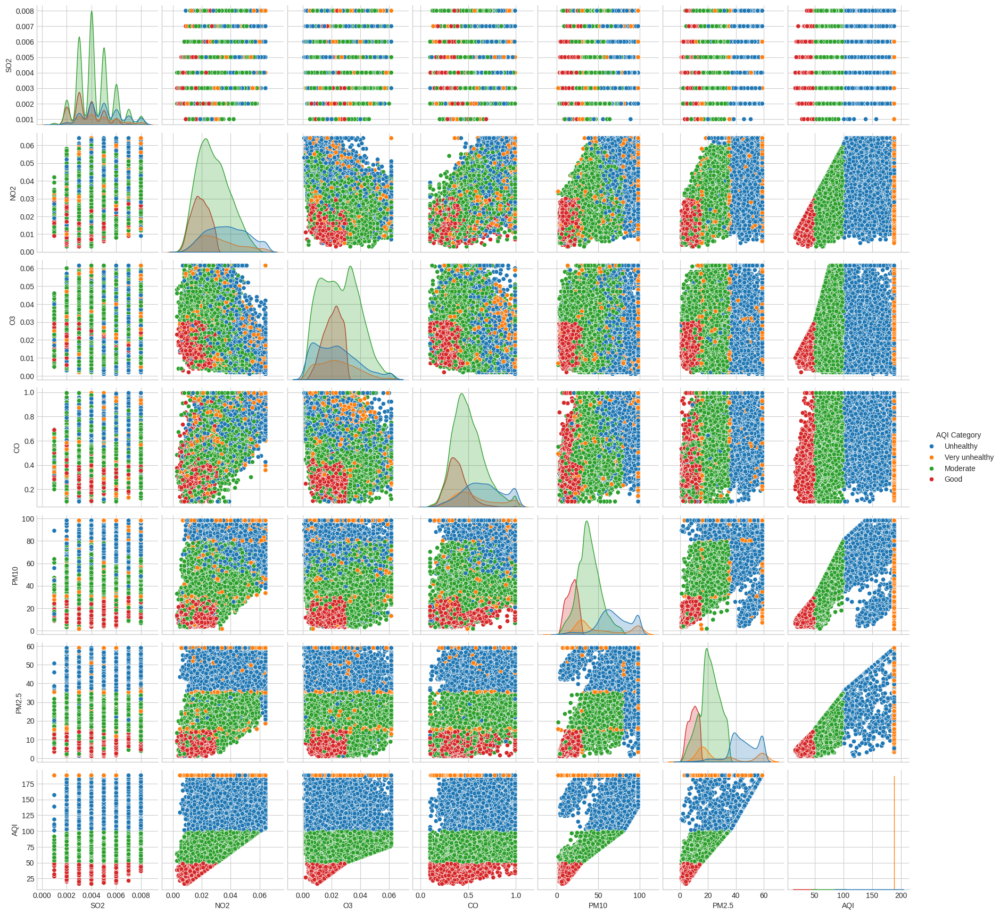

In [ ]:
# Pair plot
sns.pairplot(data=df, hue='AQI Category', vars=pollutants)

Analisis pairplot menyajikan hubungan antar variabel dalam dataset yang dikelompokkan berdasarkan kategori AQI (Air Quality Index), sebagai berikut:
1. Variabel PM10 dan PM2.5 menunjukkan distribusi yang jelas berbeda untuk setiap kategori AQI, menunjukkan bahwa partikel ini sangat berpengaruh terhadap kualitas udara. Ini mengindikasikan bahwa konsentrasi PM10 dan PM2.5 sangat memengaruhi perubahan kategori AQI, sehingga perubahan nilai kualitas udara sangat dipengaruhi oleh kedua variabel ini.
2. Variabel SO2 menunjukkan distribusi yang kurang jelas berbeda untuk setiap kategori AQI. Hal ini mungkin menunjukkan bahwa konsentrasi SO2 tidak memiliki pengaruh yang signifikan terhadap perubahan kategori AQI, atau mungkin variabel ini memiliki distribusi yang lebih seragam di berbagai kategori AQI.
3. Kategori "Unhealthy" cukup dominan dan cenderung memiliki hubungan antar polusi udara yang bernilai tinggi. Hal ini menunjukkan bahwa ketika kualitas udara mencapai tingkat "Unhealthy," hubungan antara berbagai polusi udara biasanya meningkat, yang dapat mengindikasikan situasi lingkungan yang sangat tidak sehat.
4. Kategori "Very Unhealthy" memiliki distribusi data yang sangat sedikit dan memiliki hubungan antar polusi udara yang acak. Ini menunjukkan bahwa kondisi "Very Unhealthy" mungkin merupakan situasi yang jarang terjadi dan dapat disebabkan oleh faktor-faktor lain di luar konsentrasi polusi udara.
5. Kategori "Moderate" juga cukup dominan dan memiliki hubungan antar polusi udara yang bernilai sedang. Ini mengindikasikan bahwa meskipun kategori ini menunjukkan kualitas udara yang masih dapat diterima, namun masih ada hubungan yang signifikan antara polusi udara dengan nilai AQI yang sedang.
6. Kategori "Good" terlihat cukup banyak dan memiliki hubungan antar polusi udara yang bernilai rendah. Hal ini menunjukkan bahwa ketika kualitas udara berada dalam kategori "Good," hubungan antara polusi udara biasanya tidak signifikan atau memiliki nilai korelasi yang rendah, menandakan kondisi udara yang relatif bersih dan sehat.

## Analisis Kategorikal

In [ ]:
def plot_categorical_distributions(df, cat_cols, nrows=1, ncols=2, figsize=(15, 6)):

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)

    # Flatten axes if necessary
    if nrows * ncols > 1:
        axes = axes.flatten()
    else:
        axes = [axes]

    # Plot bar plots for each categorical feature
    for i, column in enumerate(cat_cols):
        if i < len(axes):
            sns.countplot(data=df, x=column, ax=axes[i], palette='Set2')
            axes[i].set_title(f'Distribution Plot of {column}')
            axes[i].set_xlabel(column)
            axes[i].set_ylabel('Count')
            axes[i].tick_params(axis='x', rotation=45)

            # Add annotations on the bars
            for p in axes[i].patches:
                axes[i].annotate(f'{p.get_height()}',
                                 (p.get_x() + p.get_width() / 2., p.get_height()),
                                 ha='center', va='center', fontsize=10, color='black',
                                 xytext=(0, 5), textcoords='offset points')

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    # Adjust layout
    plt.tight_layout()
    plt.show()

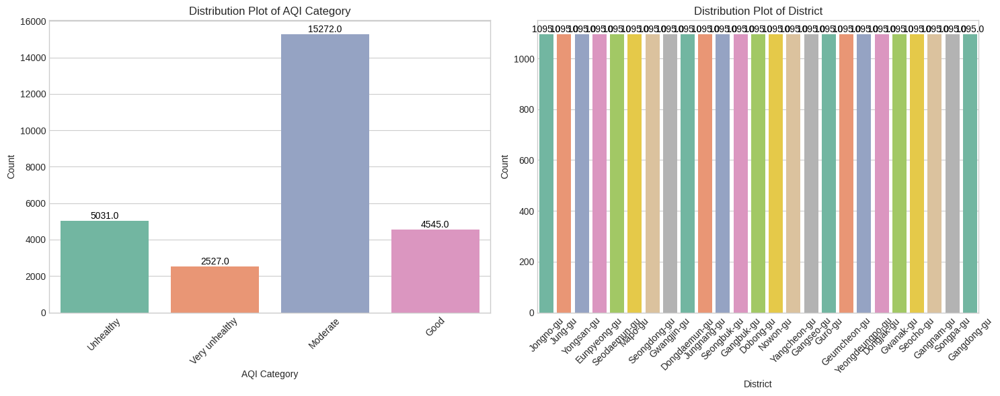

In [ ]:
categorical_columns = df_categoric.columns

plot_categorical_distributions(df, categorical_columns, nrows=1, ncols=2)

## Analisis Berdasarkan Peta Daerah

### Snippet

In [ ]:
def generate_GeoJSONSource_to_districts(my_df, column_value):
    """
    Generate GeoJSONDataSource. This is necessary to each part of GeoPlot except calculate low and high of colors
        By default must be 'District' in all df in.
    """
    with open('/content/drive/MyDrive/GreatEdu/Final Project/seoul_municipalities_geo_simple.json') as json_file:
        data = json.load(json_file)
    if(len(my_df) != 25):
        raise Exception('df with len != 25')
    if('District' not in list(my_df.columns) ):
        raise Exception('df not contains "District"')
    for i in range(25):
        city = data['features'][i]['properties']['SIG_ENG_NM']
        index = my_df.query('District == "' + city +'"').index[0]
        data['features'][i]['properties'][column_value] = my_df[column_value][index]
        data['features'][i]['properties']['District'] = my_df['District'][index]
    geo_source = GeoJSONDataSource( geojson = json.dumps(data, separators=(',', ':')) )
    return geo_source

In [ ]:
from bokeh.io import show
from bokeh.plotting import figure
from bokeh.models import LinearColorMapper, HoverTool, ColorBar
from bokeh.palettes import magma,viridis,cividis, inferno

def eda_seoul_districts_geo_plot(geosource, df_in, title, column, state_column, low = -1, high = -1, palette = -1):
    """
    Generate Bokeh Plot to Brazil States:
        geosource: GeoJSONDataSource of Bokeh
        df_in: DataSet before transformed in GeoJSONDataSource
        title: title of plot
        column: column of df_in to be placed values in geoplot
        state_column: indicate column with names of States
        low = (optional) min value of range of color spectre
        high = (optional) max values of range of color spectre
        palette: (optional) can be magma, viridis, civis, inferno e etc.. (with number os colors)
            Example: cividis(8) (8 colors to classify), cividis(256)  (256, more colors to clasify)
    """
    if high == -1:
        high = max(df_in[column])
    if low == -1:
        low = min(df_in[column])
    if palette == -1:
        palette = inferno(32)

    palette = palette[::-1]
    color_mapper = LinearColorMapper(palette = palette, low = low, high = high)

    hover = HoverTool(tooltips = [ ('District','@{'+state_column+'}'), (column, '@{'+column+'}{%.6f}')],
                  formatters={'@{'+column+'}' : 'printf'})

    color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8, width = 430, height = 20,
                         border_line_color=None, location = (0,0),  orientation = 'horizontal')

    p = figure(title = title, height = 430, width = 500, tools = [hover])

    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    p.xaxis.visible = False
    p.yaxis.visible = False

    p.patches('xs','ys', source = geosource, line_color = 'black', line_width = 0.25,
              fill_alpha = 1, fill_color = {'field' : str(column), 'transform' : color_mapper})

    p.add_layout(color_bar, 'below')
    return p

In [ ]:
from bokeh.palettes import Turbo256
from bokeh.models import ColumnDataSource
from bokeh.transform import factor_cmap
from bokeh.palettes import magma,viridis,cividis, inferno

def eda_bokeh_horiz_bar_ranked(df, column_target, title = '', int_top = 5, second_target = 'state'):
    """
    Generate Bokeh Plot ranking top fists and last value:
        df: data_frame
        column_targe: a column of df inputed
        title: title of plot
        int_top: number of the tops
        column: column of df_in to be placed values in geoplot
        second_targe = 'state'
    """
    ranked = df.sort_values(by=column_target).reset_index(drop = True)
    top_int = int_top
    top = pd.concat([ranked[:top_int], ranked[-top_int:]])
    top.index = top.index + 1
    source = ColumnDataSource(data=top)
    list_second_target = source.data[second_target].tolist()
    index_label = list_second_target[::-1] # reverse order label

    p = figure(width=650, height=430, y_range=index_label,
                toolbar_location=None, title=title)

    p.hbar(y=second_target, right=column_target, source=source, height=0.85, line_color="#000000",
          fill_color=factor_cmap(second_target, palette=inferno(16)[::-1], factors=list_second_target))
    p.x_range.start = 0  # start value of the x-axis

    p.xaxis.axis_label = "value of '" + column_target + "'"

    hover = HoverTool()  # initiate hover tool
    hover.tooltips = [("Value","@{" + column_target + "}{%.6f}" ),
                       ("Ranking","@index°")]
    hover.formatters={'@{'+column_target+'}' : 'printf'}

    hover.mode = 'hline' # set the mode of the hover tool
    p.add_tools(hover)   # add the hover tooltip to the plot

    return p # show in notebook

In [ ]:
def eda_foward_2_plots(my_df, primary_column, target_column, first_title, second_title, int_top = 5, location_column = 'District'):
    """
    Execute and show all together:
    @ primary_columns must to be a float to join to make a GeoSource
    generate_GeoJSONSource_to_districts()
    eda_seoul_districts_geo_plot()
    eda_bokeh_horiz_bar_ranked()
    """
    my_df = my_df.rename({primary_column: target_column}, axis = 1)

    geo_source = generate_GeoJSONSource_to_districts(my_df, target_column)

    geo = eda_seoul_districts_geo_plot(geo_source, my_df, first_title,
                                       target_column, location_column, palette = inferno(32))

    rank = eda_bokeh_horiz_bar_ranked(my_df, target_column, second_title,
                                      int_top = int_top, second_target = location_column)

    show(row(geo, rank))

In [ ]:
def eda_categ_feat_desc_plot(series_categorical, title=""):
    """Generate 2 plots: barplot with quantity and pieplot with percentage.
       @series_categorical: categorical series
       @title: optional
    """
    series_name = series_categorical.name
    val_counts = series_categorical.value_counts()
    val_counts.name = 'quantity'
    val_percentage = series_categorical.value_counts(normalize=True)
    val_percentage.name = "percentage"
    val_concat = pd.concat([val_counts, val_percentage], axis=1)
    val_concat.reset_index(inplace=True)
    val_concat = val_concat.rename(columns={'index': series_name})

    # Bar plot
    fig_bar = go.Figure(go.Bar(
        x=val_concat[series_name],
        y=val_concat['quantity'],
        marker_color=px.colors.qualitative.Plotly[:len(val_concat)],
        text=val_concat['quantity'],
        textposition='outside'
    ))
    fig_bar.update_layout(title=title + " - Quantity Plot", xaxis_title=series_name, yaxis_title="Quantity")

    # Pie plot
    fig_pie = go.Figure(go.Pie(
        labels=val_concat[series_name],
        values=val_concat['percentage'],
        textinfo='percent',
        hole=0.3,
        marker_colors=px.colors.qualitative.Plotly[:len(val_concat)]
    ))
    fig_pie.update_traces(textposition='inside', textinfo='label+percent')

    # Show plots
    fig_bar.show()
    fig_pie.show()

### Tingkat Polusi Tiap Daerah

In [ ]:
df_location = df.copy()
df_location = df_location.drop(columns=['AQI Category'])
df_location.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,Station code,District,Latitude,Longitude
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,101,Jongno-gu,37.57,127.01
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,101,Jongno-gu,37.57,127.01
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,101,Jongno-gu,37.57,127.01
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,101,Jongno-gu,37.57,127.01
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,101,Jongno-gu,37.57,127.01


In [ ]:
# Convert 'Station code' to float64
df_location['Station code'] = df_location['Station code'].astype('float64')
df_location.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27375 entries, 0 to 27374
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Date          27375 non-null  datetime64[ns]
 1   SO2           27375 non-null  float64       
 2   NO2           27375 non-null  float64       
 3   O3            27375 non-null  float64       
 4   CO            27375 non-null  float64       
 5   PM10          27375 non-null  float64       
 6   PM2.5         27375 non-null  float64       
 7   AQI           27375 non-null  float64       
 8   Station code  27375 non-null  float64       
 9   District      27375 non-null  object        
 10  Latitude      27375 non-null  float64       
 11  Longitude     27375 non-null  float64       
dtypes: datetime64[ns](1), float64(10), object(1)
memory usage: 2.5+ MB


In [ ]:
pollutants = ["SO2", "NO2", "O3", "CO", "PM10", "PM2.5", "AQI"]

for pollutant in pollutants:
    primary_column = pollutant
    target_column = 'total_average_' + pollutant
    df_pollutant = df_location.groupby(['District']).mean()[primary_column].reset_index()
    eda_foward_2_plots(df_pollutant, primary_column, target_column,
                       f"{pollutant} total average per district",
                       f"The first and last 5 on average for {pollutant}")

Visualisasi ini menunjukkan bahwa kualitas udara di lima kota, terutama Seocho-gu, Yeongdeungpo-gu, Guro-gu, Mapo-gu, dan Gwanak-gu, memiliki tingkat polusi yang cukup parah dengan konsentrasi AQI yang tinggi. Hal ini mengindikasikan dampak yang serius terhadap kesehatan pernapasan dan kesehatan kardiovaskular masyarakat di wilayah-wilayah tersebut, serta perlunya tindakan segera dari pihak setempat dalam mengendalikan sumber polusi, meningkatkan kesadaran masyarakat, dan meningkatkan infrastruktur hijau untuk mengurangi dampak lingkungan dan kesehatan yang merugikan.

### Peta

In [ ]:
stations_map = folium.Map(location=[37.562600, 127.024612], tiles='cartodbpositron', zoom_start=11)

# Add points to the map
for idx, row in stations.iterrows():
  marker_popup_str = 'Station Name: ' + str(row['Station name(district)'])
  Marker([row['Latitude'], row['Longitude']],
           popup=marker_popup_str).add_to(stations_map)

# Adding borders
folium.GeoJson(
    seoul_geojson,
    name='geojson'
).add_to(stations_map)

# Display the map
stations_map

In [ ]:
def show_pollutant_mean_maps(pollutants, stations, df_eda, geo_data):

    for col in pollutants:
        pollutant_map = folium.Map(location=[37.562600, 127.024612], tiles='cartodbpositron', zoom_start=11)

        # Add points to the map
        for idx, row in stations.iterrows():
            Marker([row['Latitude'], row['Longitude']], popup=row['Station name(district)']).add_to(pollutant_map)

        # Adding choropleth
        Choropleth(
            geo_data=geo_data,
            data=df_eda,
            columns=['District', col],  # Using the mean value column
            key_on="feature.properties.SIG_ENG_NM",
            fill_color='YlGnBu',
            legend_name=f'Mean concentration of {col} in Seoul'
        ).add_to(pollutant_map)

        # Display the map
        display(Markdown(f'<center><h3>{col} Mean Value</h3></center>'))
        display(pollutant_map)

In [ ]:
show_pollutant_mean_maps(pollutants, stations, df, seoul_geojson)

<center><h3>SO2 Mean Value</h3></center>

<center><h3>NO2 Mean Value</h3></center>

<center><h3>O3 Mean Value</h3></center>

<center><h3>CO Mean Value</h3></center>

<center><h3>PM10 Mean Value</h3></center>

<center><h3>PM2.5 Mean Value</h3></center>

<center><h3>AQI Mean Value</h3></center>

## Analisis Level Polusi Udara

In [ ]:
# Create dict to pollutants level
list_cols = list(df_gas_info.columns)[3:]

level_dangerous = {}
for i in range(len(df_gas_info)):
    name = df_gas_info["Item name"][i]
    level_dangerous[name] = df_gas_info[list_cols].loc[i].tolist()

level_dangerous

{'SO2': [0.02, 0.05, 0.15, 1.0],
 'NO2': [0.03, 0.06, 0.2, 2.0],
 'CO': [2.0, 9.0, 15.0, 50.0],
 'O3': [0.03, 0.09, 0.15, 0.5],
 'PM10': [30.0, 80.0, 150.0, 600.0],
 'PM2.5': [15.0, 35.0, 75.0, 500.0]}

In [ ]:
def measurement_evaluator(value, column):
    if(pd.isnull(value) or value < 0):
        return 'Error'
    elif(value <= level_dangerous[column][0]):
        return 'Good'
    elif(value <= level_dangerous[column][1]):
        return 'Normal'
    elif(value <= level_dangerous[column][2]):
        return 'Bad'
    else:
        return 'Very bad'
    return value

def generate_level_danger_gas_series(my_df, column):
    series = my_df[column].map(lambda x: measurement_evaluator(x, column))
    return series

In [ ]:
# Filter only measures columns
df_measures = df.iloc[:,1:-6]
df_measures.head()

,SO2,NO2,O3,CO,PM10,PM2.5
0,0.00,0.05,0.00,0.99,81.67,58.94
1,0.01,0.05,0.02,0.99,98.19,58.94
2,0.01,0.05,0.01,0.83,72.92,51.83
3,0.01,0.06,0.01,0.99,51.12,34.92
4,0.00,0.04,0.01,0.62,34.88,21.96


In [ ]:
# Generate level dangerous to each gas
l_level = [x+'_Level' for x in df_measures.columns.tolist()[:]]
for l in l_level:
    df_measures[l] = generate_level_danger_gas_series(df_measures, l[:-6])
df_measures = df_measures.reset_index().drop('index', axis = 1)

df_measures.head()

,SO2,NO2,O3,CO,PM10,PM2.5,SO2_Level,NO2_Level,O3_Level,CO_Level,PM10_Level,PM2.5_Level
0,0.00,0.05,0.00,0.99,81.67,58.94,Good,Normal,Good,Good,Bad,Bad
1,0.01,0.05,0.02,0.99,98.19,58.94,Good,Normal,Good,Good,Bad,Bad
2,0.01,0.05,0.01,0.83,72.92,51.83,Good,Normal,Good,Good,Normal,Bad
3,0.01,0.06,0.01,0.99,51.12,34.92,Good,Normal,Good,Good,Normal,Normal
4,0.00,0.04,0.01,0.62,34.88,21.96,Good,Normal,Good,Good,Normal,Normal


In [ ]:
# Menggabungkan DataFrame df dan df_measures
df_level = pd.concat([df, df_measures.iloc[:, -6:]], axis=1)

# Mengganti nama kolom 'AQI Category' menjadi 'AQI_Level'
df_level = df_level.rename(columns={'AQI Category': 'AQI_Level'})

# Pindahkan kolom 'AQI_Level' ke kolom terakhir
aqi_level_col = df_level.pop('AQI_Level')
df_level['AQI_Level'] = aqi_level_col

df_level.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,Station code,District,Latitude,Longitude,SO2_Level,NO2_Level,O3_Level,CO_Level,PM10_Level,PM2.5_Level,AQI_Level
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,101,Jongno-gu,37.57,127.01,Good,Normal,Good,Good,Bad,Bad,Unhealthy
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,101,Jongno-gu,37.57,127.01,Good,Normal,Good,Good,Bad,Bad,Very unhealthy
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,101,Jongno-gu,37.57,127.01,Good,Normal,Good,Good,Normal,Bad,Unhealthy
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,101,Jongno-gu,37.57,127.01,Good,Normal,Good,Good,Normal,Normal,Moderate
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,101,Jongno-gu,37.57,127.01,Good,Normal,Good,Good,Normal,Normal,Moderate


In [ ]:
def eda_categ_feat_desc_plot(series_categorical, title=""):
    """Generate a pie plot with quantity and percentage information.
       @series_categorical: categorical series
       @title: optional
    """
    # Compute value counts and percentages
    val_counts = series_categorical.value_counts()
    val_percentage = series_categorical.value_counts(normalize=True) * 100

    # Create DataFrame for plotting
    plot_data = pd.DataFrame({'Category': val_counts.index, 'Quantity': val_counts.values, 'Percentage': val_percentage.values})

    # Plot pie chart
    fig = go.Figure()

    # Add pie trace
    fig.add_trace(go.Pie(
        labels=plot_data['Category'],
        values=plot_data['Quantity'],
        hoverinfo='label+percent+value',
        hole=0.3,
        marker_colors=px.colors.qualitative.Plotly[:len(plot_data)]
    ))

    # Update layout
    fig.update_layout(
        title=title + " - Category Distribution",
        showlegend=True,
        annotations=[dict(text=f"Total: {plot_data['Quantity'].sum()}", showarrow=False)]
    )

    # Show plot
    fig.show()

In [ ]:
levels = [pollutant + '_Level' for pollutant in pollutants]

for pollutant, level in zip(pollutants, levels):
    eda_categ_feat_desc_plot(df_level[level], title=f'{pollutant} Level in All Gas Measurements')

## Analisis Deret Waktu

In [ ]:
df_time = df.copy()

# Generate columns to year, mont and weekday
df_time['Year']  = pd.DatetimeIndex(df_time['Date']).year
df_time['Month']  = pd.DatetimeIndex(df_time['Date']).month
df_time['Weekday'] = pd.DatetimeIndex(df_time['Date']).strftime('%A')

df_time.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,AQI Category,Station code,District,Latitude,Longitude,Year,Month,Weekday
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,Unhealthy,101,Jongno-gu,37.57,127.01,2017,1,Sunday
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,Very unhealthy,101,Jongno-gu,37.57,127.01,2017,1,Monday
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,Unhealthy,101,Jongno-gu,37.57,127.01,2017,1,Tuesday
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,Moderate,101,Jongno-gu,37.57,127.01,2017,1,Wednesday
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,Moderate,101,Jongno-gu,37.57,127.01,2017,1,Thursday


### Tahunan

In [ ]:
df_monthly = df_time.copy()
df_monthly = df_monthly.drop(columns=['AQI Category', 'Weekday'])
df_monthly.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,Station code,District,Latitude,Longitude,Year,Month
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,101,Jongno-gu,37.57,127.01,2017,1
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,101,Jongno-gu,37.57,127.01,2017,1
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,101,Jongno-gu,37.57,127.01,2017,1
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,101,Jongno-gu,37.57,127.01,2017,1
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,101,Jongno-gu,37.57,127.01,2017,1


In [ ]:
# Mengagregasi data untuk mendapatkan rata-rata level polutan per distrik per tahun
df_yearly = df_monthly.groupby(['Year', 'District']).mean().reset_index()

# Mendapatkan daftar tahun yang unik
years = df_yearly['Year'].unique()

# Looping untuk setiap tahun dan setiap polutan untuk membuat plot
for year in years:
    # Membuat subplot dengan 1 baris dan 3 kolom
    num_plots = len(pollutants)
    num_rows = (num_plots + 2) // 3  # Menghitung jumlah baris yang dibutuhkan
    fig = make_subplots(rows=num_rows, cols=3, subplot_titles=pollutants)

    # Mendapatkan top 5 distrik dengan level polutan tertinggi untuk setiap polutan dan setiap tahun
    for i, pollutant in enumerate(pollutants):
        df_year_pollutant = df_yearly[df_yearly['Year'] == year].nlargest(5, pollutant)
        bar = go.Bar(x=df_year_pollutant['District'], y=df_year_pollutant[pollutant], name=pollutant)
        row = (i // 3) + 1
        col = (i % 3) + 1
        fig.add_trace(bar, row=row, col=col)

    fig.update_layout(title_text=f'Top 5 Districts with Highest Pollutant Levels in {year}', height=800)
    fig.show()

Visualisasi ini menunjukkan lima daerah dengan tingkat polusi udara tertinggi pada tahun 2019. Dari hasil analisis kami, Mapo-gu secara konsisten termasuk dalam lima besar daerah dengan AQI tertinggi sejak tahun 2017-2019. Ini menunjukkan bahwa Mapo-gu mengalami masalah polusi udara yang kronis dan berkelanjutan, memerlukan perhatian khusus dan intervensi jangka panjang untuk mengurangi polusi dan meningkatkan kualitas udara di daerah tersebut.

In [ ]:
# Mengelompokkan data berdasarkan 'Year', 'Month', dan 'District' dan menghitung rata-rata untuk setiap kelompok
grouped_df = df_monthly.groupby(['Year', 'Month', 'District']).mean().reset_index()

# Mendapatkan daftar unik dari 'District'
districts = grouped_df['District'].unique()

# Membuat line chart terpisah untuk setiap District
for district in districts:
    district_data = grouped_df[grouped_df['District'] == district]

    # Membuat figure untuk setiap District
    fig = go.Figure()

    # Menambahkan garis untuk setiap polutan di figure yang sesuai
    for pollutant in pollutants:
        fig.add_trace(
            go.Scatter(x=district_data['Year'].astype(str) + '-' + district_data['Month'].astype(str),
                       y=district_data[pollutant],
                       mode='lines',
                       name=pollutant)
        )

    # Memperbarui layout untuk setiap figure
    fig.update_layout(title=f'Monthly Average of Air Pollutants in {district}',
                      xaxis_title='Year-Month',
                      yaxis_title='Concentration (µg/m³)',
                      height=400, width=1100)

    # Menampilkan plot
    fig.show()

### Bulanan

In [ ]:
def create_box_plots(df, pollutants):

    colors = px.colors.qualitative.Plotly  # Use Plotly's qualitative color scheme

    for i, pollutant in enumerate(pollutants):
        color = colors[i % len(colors)]  # Cycle through colors
        fig = px.box(
            df,
            x='Month',
            y=pollutant,
            title=f'Monthly Distribution of {pollutant} Levels',
            labels={'Month': 'Month', pollutant: 'Concentration'},
            category_orders={'Month': list(range(1, 13))},
            color_discrete_sequence=[color]  # Apply color to each plot
        )
        fig.update_layout(
            title_x=0.5,
            xaxis=dict(
                tickmode='linear',
                tick0=1,
                dtick=1
            )
        )
        fig.show()

create_box_plots(df_monthly, pollutants)

Visualisasi ini menunjukkan distribusi bulanan konsentrasi AQI sepanjang tahun, dengan penjelasan sebagai berikut
1.	Bulan Januari sampai Maret: Bulan Januari sampai Maret memiliki median AQI yang tinggi, menunjukkan bahwa polusi udara cenderung lebih buruk pada bulan-bulan ini.
2.	Bulan Agustus dan September: Bulan-bulan ini menunjukkan nilai AQI yang lebih rendah, dengan median yang lebih rendah dan distribusi yang lebih ketat, menandakan kualitas udara yang lebih baik.
3.	Variabilitas Polusi: Ada variasi yang signifikan dalam distribusi AQI setiap bulan, terlihat dari lebar kotak dan adanya outlier, menandakan bahwa tingkat polusi udara bisa sangat bervariasi dari satu bulan ke bulan lainnya.

### Harian

In [ ]:
df_weekday = df_time.copy()
df_weekday = df_weekday.drop(columns=['District', 'AQI Category'])
df_weekday.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,Station code,Latitude,Longitude,Year,Month,Weekday
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,101,37.57,127.01,2017,1,Sunday
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,101,37.57,127.01,2017,1,Monday
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,101,37.57,127.01,2017,1,Tuesday
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,101,37.57,127.01,2017,1,Wednesday
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,101,37.57,127.01,2017,1,Thursday


In [ ]:
# Define the order of the days from Monday to Sunday
weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Convert the 'Weekday' column to a categorical type with the specified order
df_weekday['Weekday'] = pd.Categorical(df_weekday['Weekday'], categories=weekday_order, ordered=True)

# Group by weekday for each pollutant
weekday_data = df_weekday.groupby("Weekday").mean().reset_index()

def create_individual_weekday_plots(data, pollutants):

    colors = px.colors.qualitative.Plotly  # Use Plotly's qualitative color scheme

    for i, pollutant in enumerate(pollutants):
        # Create a new figure for each pollutant
        fig = go.Figure()

        # Create line plot for the pollutant
        fig.add_trace(
            go.Scatter(x=data['Weekday'], y=data[pollutant], mode='lines+markers', name=pollutant,
                       line=dict(color=colors[i % len(colors)]))
        )

        fig.update_layout(
            height=400, width=1200, title_text=f'{pollutant} Concentration Across the Week',
            title_x=0.5, xaxis_title='Weekday', yaxis_title='Concentration'
        )

        fig.show()

create_individual_weekday_plots(weekday_data, pollutants)

Visualisasi ini menggambarkan pola perubahan konsentrasi AQI sepanjang minggu, dengan penjelasan sebagai berikut
1.	Senin, Selasa, Jumat dan Sabtu: Konsentrasi AQI cenderung lebih tinggi, yang bisa disebabkan oleh peningkatan aktivitas industri dan kendaraan di awal minggu dan aktivitas tambahan pada akhir pekan.
2.	Rabu dan Kamis: AQI menunjukkan penurunan konsentrasi yang signifikan, menunjukkan kualitas udara yang lebih baik di tengah minggu.
3.	Minggu: Menunjukkan penurunan AQI yang cukup signifikan, mengindikasikan bahwa aktivitas yang berkurang di akhir pekan berdampak positif pada kualitas udara.



## Analisis AQI

In [ ]:
df_aqi = pd.read_csv("/content/drive/MyDrive/GreatEdu/Final Project/dataset/df_daily_pollution_with_aqi.csv") # Gunakan df sebelum handle outlier
df_aqi['Year'] = pd.DatetimeIndex(df_aqi['Date']).year
# df_aqi = df_aqi.drop(columns=['AQI Category','Station code','Latitude','Longitude'],axis=1)
df_aqi = df_aqi[['Date','AQI','District','Year']]
df_aqi.head()

,Date,AQI,District,Year
0,2017-01-01,220.55,Jongno-gu,2017
1,2017-01-02,251.03,Jongno-gu,2017
2,2017-01-03,161.49,Jongno-gu,2017
3,2017-01-04,99.79,Jongno-gu,2017
4,2017-01-05,67.90,Jongno-gu,2017


In [ ]:
df_filtered = df_aqi[df_aqi['Year'].isin([2017, 2018, 2019])]

# Calculate the average AQI for each district for each year
avg_aqi_per_year = df_filtered.groupby(['District', 'Year'])['AQI'].mean().unstack()

# Calculate the decrease/increase in AQI from 2017 to 2019 for each district
avg_aqi_per_year['Change_2017_2019'] = avg_aqi_per_year[2019] - avg_aqi_per_year[2017]

# Identify the district with the most significant decrease and increase
most_significant_decrease = avg_aqi_per_year['Change_2017_2019'].idxmin()
most_significant_decrease_value = avg_aqi_per_year['Change_2017_2019'].min()

most_significant_increase = avg_aqi_per_year['Change_2017_2019'].idxmax()
most_significant_increase_value = avg_aqi_per_year['Change_2017_2019'].max()

# Highlighting rows for the most significant decrease and increase
def highlight_rows(row):
    if row.name == most_significant_decrease:
        return ['background-color: green']*len(row)
    elif row.name == most_significant_increase:
        return ['background-color: red']*len(row)
    else:
        return ['']*len(row)

# Display the results with highlights
styled_table = avg_aqi_per_year.style.apply(highlight_rows, axis=1)
display(styled_table)

# Insights
print(f"The district with the most significant decrease in AQI from 2017 to 2019 is {most_significant_decrease} with a decrease of {most_significant_decrease_value} AQI points.")
print(f"The district with the most significant increase in AQI from 2017 to 2019 is {most_significant_increase} with an increase of {most_significant_increase_value} AQI points.")

Year,2017,2018,2019,Change_2017_2019
District,,,,
Dobong-gu,114.989507,106.312356,124.101890,9.112384
Dongdaemun-gu,116.017014,103.271479,110.621096,-5.395918
Dongjak-gu,120.152000,104.632027,120.319945,0.167945
Eunpyeong-gu,107.436219,110.280822,110.206603,2.770384
Gangbuk-gu,108.634767,106.534082,115.169425,6.534658
Gangdong-gu,109.097479,105.615068,113.523890,4.426411
Gangnam-gu,104.518521,110.236849,117.007671,12.489151
Gangseo-gu,108.125753,107.192603,116.993452,8.867699
Geumcheon-gu,113.114110,104.156137,112.882986,-0.231123


The district with the most significant decrease in AQI from 2017 to 2019 is Nowon-gu with a decrease of -16.78958904109591 AQI points.
The district with the most significant increase in AQI from 2017 to 2019 is Gwangjin-gu with an increase of 40.303589041095876 AQI points.


In [ ]:
# Plotting perubahan AQI dari 2017 ke 2019
fig = px.bar(avg_aqi_per_year.reset_index(), x='District', y='Change_2017_2019',
             color='Change_2017_2019', color_continuous_scale=['green', 'yellow', 'red'],
             title='Change in AQI from 2017 to 2019 by District',
             labels={'Change_2017_2019': 'Change in AQI (2017-2019)'})

# Adding annotations for the most significant increase and decrease
fig.add_annotation(
    go.layout.Annotation(
        x=most_significant_decrease,
        y=most_significant_decrease_value,
        text=f"↓ {most_significant_decrease} ({most_significant_decrease_value:.2f})",
        showarrow=True,
        arrowhead=3,
        ax=-20,
        ay=20,
        arrowcolor="green",
        font=dict(color="green", size=12)
    )
)

fig.add_annotation(
    go.layout.Annotation(
        x=most_significant_increase,
        y=most_significant_increase_value,
        text=f"↑ {most_significant_increase} ({most_significant_increase_value:.2f})",
        showarrow=True,
        arrowhead=3,
        ax=20,
        ay=-20,
        arrowcolor="red",
        font=dict(color="red", size=12)
    )
)

fig.update_layout(coloraxis_colorbar=dict(title='AQI Change'), height=600, width=1200)

fig.show()

In [ ]:
# Hitung rata-rata AQI untuk setiap stasiun dan tahun
avg_aqi_per_district_year = df_filtered.groupby(['District', 'Year'])['AQI'].mean().unstack()

# Identifikasi nilai tertinggi dan terendah beserta stasiun dan tahunnya
highest_avg_aqi = avg_aqi_per_district_year.max().max()
lowest_avg_aqi = avg_aqi_per_district_year.min().min()

highest_avg_aqi_district, highest_avg_aqi_year = avg_aqi_per_district_year.stack().idxmax()
lowest_avg_aqi_district, lowest_avg_aqi_year = avg_aqi_per_district_year.stack().idxmin()

# Highlight only the highest and lowest AQI values in each district and year
def highlight_max_min(val):
    if val == highest_avg_aqi:
        return 'background-color: red'  # Color for highest
    elif val == lowest_avg_aqi:
        return 'background-color: green'  # Color for lowest
    return ''

styled_table = avg_aqi_per_district_year.style.applymap(highlight_max_min)
display(styled_table)

# Insights
print(f"The highest average AQI ({highest_avg_aqi:.2f}) occurred in District: {highest_avg_aqi_district}, Year: {highest_avg_aqi_year}")
print(f"The lowest average AQI ({lowest_avg_aqi:.2f}) occurred in District: {lowest_avg_aqi_district}, Year: {lowest_avg_aqi_year}")

Year,2017,2018,2019
District,,,
Dobong-gu,114.989507,106.312356,124.101890
Dongdaemun-gu,116.017014,103.271479,110.621096
Dongjak-gu,120.152000,104.632027,120.319945
Eunpyeong-gu,107.436219,110.280822,110.206603
Gangbuk-gu,108.634767,106.534082,115.169425
Gangdong-gu,109.097479,105.615068,113.523890
Gangnam-gu,104.518521,110.236849,117.007671
Gangseo-gu,108.125753,107.192603,116.993452
Geumcheon-gu,113.114110,104.156137,112.882986


The highest average AQI (149.67) occurred in District: Seocho-gu, Year: 2019
The lowest average AQI (93.53) occurred in District: Nowon-gu, Year: 2018


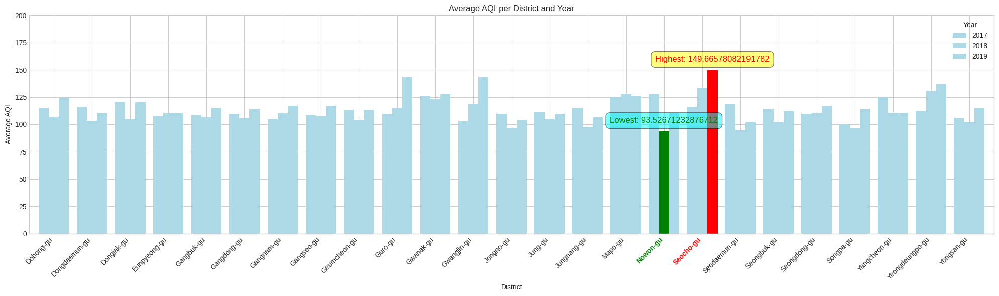

In [ ]:
# Visualization with highlighting and annotations
fig, ax = plt.subplots(figsize=(20, 6))

# Plot all bars in light blue
bars = avg_aqi_per_district_year.plot(kind='bar', ax=ax, color='lightblue', width=0.8)

# Add color only to bars corresponding to highest and lowest values
for bar in bars.patches:
    if bar.get_height() == highest_avg_aqi:
        bar.set_color('red')
    elif bar.get_height() == lowest_avg_aqi:
        bar.set_color('green')

# Add annotations for highest and lowest values
for bar in bars.patches:
    if bar.get_height() == highest_avg_aqi:
        ax.annotate(f'Highest: {highest_avg_aqi}', (bar.get_x() + bar.get_width() / 2, bar.get_height()),
                    ha='center', va='bottom', color='red', size=12, xytext=(0, 10),
                    textcoords='offset points', bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5))
    elif bar.get_height() == lowest_avg_aqi:
        ax.annotate(f'Lowest: {lowest_avg_aqi}', (bar.get_x() + bar.get_width() / 2, bar.get_height()),
                    ha='center', va='bottom', color='green', size=12, xytext=(0, 10),
                    textcoords='offset points', bbox=dict(boxstyle='round,pad=0.5', fc='cyan', alpha=0.5))

# Highlight district labels for highest and lowest values
xticks_labels = ax.get_xticklabels()
for label in xticks_labels:
    if label.get_text() == highest_avg_aqi_district:
        label.set_color('red')
        label.set_fontweight('bold')
    elif label.get_text() == lowest_avg_aqi_district:
        label.set_color('green')
        label.set_fontweight('bold')

ax.set_ylabel('Average AQI')
ax.set_title('Average AQI per District and Year')
plt.xticks(rotation=45, ha='right')
ax.set_ylim([0, 200]) # Set the y-axis range to 0-200
plt.legend(title='Year', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()

# Modelling

## Persiapan Fitur dan Target

In [33]:
df_m = pd.read_csv('/content/drive/MyDrive/GreatEdu/Final Project/dataset/df_final.csv')
df_m.head()

,Date,SO2,NO2,O3,CO,PM10,PM2.5,AQI,AQI Category,Station code,District,Latitude,Longitude
0,2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,Unhealthy,101,Jongno-gu,37.57,127.01
1,2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,Very unhealthy,101,Jongno-gu,37.57,127.01
2,2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,Unhealthy,101,Jongno-gu,37.57,127.01
3,2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,Moderate,101,Jongno-gu,37.57,127.01
4,2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,Moderate,101,Jongno-gu,37.57,127.01


In [34]:
# Hapus kolom yang tidak diinginkan
df_m = df_m.drop(columns=['Date', 'AQI', 'Station code', 'District', 'Latitude', 'Longitude'])

# Cetak nilai unik dari kolom 'AQI Category'
print(df_m['AQI Category'].unique())

# Tampilkan lima baris pertama dari dataframe yang telah dimodifikasi
df_m.head()

['Unhealthy' 'Very unhealthy' 'Moderate' 'Good']


,SO2,NO2,O3,CO,PM10,PM2.5,AQI Category
0,0.00,0.05,0.00,0.99,81.67,58.94,Unhealthy
1,0.01,0.05,0.02,0.99,98.19,58.94,Very unhealthy
2,0.01,0.05,0.01,0.83,72.92,51.83,Unhealthy
3,0.01,0.06,0.01,0.99,51.12,34.92,Moderate
4,0.00,0.04,0.01,0.62,34.88,21.96,Moderate


## Pelabelan Target

Kami menggunakan enam polusi udara (SO2, NO2, O3, CO, PM10, PM2.5) sebagai variabel predictor (X) dan mengonversi AQI Category menjadi data numerik (0 untuk Good, 1 untuk Moderate, 2 untuk Unhealthy, dan 3 untuk Very Unhealthy) dengan LabelEncoder, lalu disimpan sebagai kolom baru bernama AQI_Category_Label sebagai variable respon (Y).

In [35]:
from sklearn.preprocessing import LabelEncoder

# Inisialisasi LabelEncoder
label_encoder = LabelEncoder()

# Mengubah data kategorikal menjadi data numerik
df_m['AQI Category Label'] = label_encoder.fit_transform(df_m['AQI Category'])
df_m.head()

,SO2,NO2,O3,CO,PM10,PM2.5,AQI Category,AQI Category Label
0,0.00,0.05,0.00,0.99,81.67,58.94,Unhealthy,2
1,0.01,0.05,0.02,0.99,98.19,58.94,Very unhealthy,3
2,0.01,0.05,0.01,0.83,72.92,51.83,Unhealthy,2
3,0.01,0.06,0.01,0.99,51.12,34.92,Moderate,1
4,0.00,0.04,0.01,0.62,34.88,21.96,Moderate,1


In [36]:
# Melihat label-label yang terkait dengan setiap nilai numerik
label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print("Label Mapping:", label_mapping)

Label Mapping: {'Good': 0, 'Moderate': 1, 'Unhealthy': 2, 'Very unhealthy': 3}


## Feature Engineering

In [37]:
selected_columns = ['SO2', 'NO2', 'O3', 'CO', 'PM10', 'PM2.5', 'AQI Category Label']
df_selected = df_m.loc[:, selected_columns]
df_selected.head()

,SO2,NO2,O3,CO,PM10,PM2.5,AQI Category Label
0,0.00,0.05,0.00,0.99,81.67,58.94,2
1,0.01,0.05,0.02,0.99,98.19,58.94,3
2,0.01,0.05,0.01,0.83,72.92,51.83,2
3,0.01,0.06,0.01,0.99,51.12,34.92,1
4,0.00,0.04,0.01,0.62,34.88,21.96,1


## Pemisahan Fitur dan Target

In [38]:
X = df_selected.drop('AQI Category Label', axis=1)   # Variabel prediktor
y = df_selected['AQI Category Label']                # Variabel respon

## Penyeimbangan Kelas

In [39]:
# Melakukan resampling data untuk mengatasi ketimpangan data
from collections import Counter
from imblearn.over_sampling import SMOTE

counter_before = Counter(y)
print('Before',counter_before)

#SMOTE
oversample = SMOTE()
X, y = oversample.fit_resample(X, y)
counter_after = Counter(y)
print('After',counter_after)

Before Counter({1: 15272, 2: 5031, 0: 4545, 3: 2527})
After Counter({2: 15272, 3: 15272, 1: 15272, 0: 15272})


In [40]:
# Data untuk pie chart sebelum resampling
labels_before = list(counter_before.keys())
values_before = list(counter_before.values())

# Data untuk pie chart setelah resampling
labels_after = list(counter_after.keys())
values_after = list(counter_after.values())

# Keterangan Label Mapping
label_mapping = {'Good': 0, 'Moderate': 1, 'Unhealthy': 2, 'Very unhealthy': 3}
label_mapping_str = ', '.join([f"{k}: {v}" for k, v in label_mapping.items()])

# Membuat subplots
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]],
                    subplot_titles=['Before Resampling', 'After Resampling'])

# Pie chart sebelum resampling
fig.add_trace(go.Pie(labels=labels_before, values=values_before, name='Before Resampling'), 1, 1)
fig.update_traces(textinfo='label+percent', hoverinfo='label+value')

# Pie chart setelah resampling
fig.add_trace(go.Pie(labels=labels_after, values=values_after, name='After Resampling'), 1, 2)
fig.update_traces(textinfo='label+percent', hoverinfo='label+value')

# Layout dan tampilan
fig.update_layout(title_text='Class Distribution Before and After SMOTE Resampling',
                  annotations=[dict(text=f"Label Mapping: {label_mapping_str}", showarrow=False,
                                    x=0.5, y=-0.15, font=dict(size=10))])

fig.show()

## Pembagian Data Train dan Test

In [41]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Mengecek shape train_X, test_X, train_y, dan test_y
print("train_X (baris, kolom): ", X_train.shape)
print("test_X (baris, kolom): ", X_test.shape)
print("train_y (baris, kolom): ", y_train.shape)
print("test_y (baris, kolom): ", y_test.shape)

train_X (baris, kolom):  (48870, 6)
test_X (baris, kolom):  (12218, 6)
train_y (baris, kolom):  (48870,)
test_y (baris, kolom):  (12218,)


In [42]:
# Membuat Confussion Matriks
def plot_confusion_matrix(y_true, y_pred, classes):
    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)

    # Create a figure and axis
    plt.figure(figsize=(8, 6))

    # Plot the confusion matrix heatmap
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)

    # Add labels and title
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')

    # Show plot
    plt.show()

In [43]:
# Membuat Kurva ROC-AUC
def plot_roc_curve_multiclass(y_test, y_pred, classes):
    y_test_bin = label_binarize(y_test, classes=classes)
    y_pred_bin = label_binarize(y_pred, classes=classes)

    n_classes = len(classes)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_bin[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create traces for each class
    data = []
    for i in range(n_classes):
        trace = go.Scatter(x=fpr[i], y=tpr[i], mode='lines', name=f'Class {classes[i]} (AUC = {roc_auc[i]:0.2f})')
        data.append(trace)

    # Create layout for the plot
    layout = go.Layout(
        title='ROC Curve (Multiclass)',
        xaxis=dict(title='False Positive Rate'),
        yaxis=dict(title='True Positive Rate'),
        legend=dict(x=1, y=0, xanchor='right', yanchor='bottom'),
        plot_bgcolor='rgba(0,0,0,0)'
    )

    # Create figure and plot
    fig = go.Figure(data=data, layout=layout)
    fig.update_layout(showlegend=True)
    fig.add_shape(type='line', line=dict(dash='dash'), x0=0, x1=1, y0=0, y1=1)

    fig.show()

classes = [0, 1, 2, 3]  # Class labels

In [44]:
# Menampilkan nilai evaluasi dari model
def evaluate_model(model_name, test_y, y_pred):

    precision = precision_score(test_y, y_pred, average='weighted')  # 'weighted' for multiclass
    recall = recall_score(test_y, y_pred, average='weighted')  # 'weighted' for multiclass
    accuracy = accuracy_score(test_y, y_pred)
    f1 = f1_score(test_y, y_pred, average='weighted')  # 'weighted' for multiclass

    evaluation_data = {
        'Model': [model_name],
        'Precision': [precision],
        'Recall': [recall],
        'Accuracy': [accuracy],
        'F1 Score': [f1]
    }

    evaluation_df = pd.DataFrame(evaluation_data)

    return evaluation_df

In [45]:
# Menyimpan hasil evaluasi model
resultsDict={}

In [46]:
import pandas as pd
import plotly.graph_objects as go

def plot_feature_importance(feature_importance, feature_names, title='Feature Importance', colorscale='viridis'):
    # Create a DataFrame for better visualization
    feature_importance_df = pd.DataFrame(list(zip(feature_names, feature_importance)), columns=['Feature', 'Importance'])

    # Sort DataFrame by Importance
    feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=True)

    # Create a bar plot using Plotly with random colors
    fig = go.Figure(go.Bar(
        x=feature_importance_df['Importance'],
        y=feature_importance_df['Feature'],
        orientation='h',
        marker=dict(color=feature_importance_df['Importance'], colorscale=colorscale, cmin=0, cmax=max(feature_importance_df['Importance']), colorbar=dict(title='Importance')),
    ))

    fig.update_layout(
        title=title,
        xaxis=dict(title='Importance'),
        yaxis=dict(title='Feature'),
        height=600,
        width=1000,
    )

    fig.show()

## Model

### Logistic Regression

In [47]:
# Inisialisasi model Logistic Regression
lr = LogisticRegression(solver='liblinear',penalty='l1')
lr.fit(X_train, y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = lr.predict(X_test)

print("Analysis Model Logistic Regression")
print("")
print("Analysis Metric Eror Model Training")

# Definisikan target names sesuai dengan label Anda
target_names = ['Good', 'Moderate', 'Unhealthy', 'Very unhealthy']
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['Logistic Regression'] = evaluate_model("Logistic Regression", y_test, y_pred)

Analysis Model Logistic Regression

Analysis Metric Eror Model Training
                precision    recall  f1-score   support

          Good       0.82      0.96      0.88      3102
      Moderate       0.54      0.61      0.57      2992
     Unhealthy       0.68      0.86      0.76      3086
Very unhealthy       0.21      0.09      0.13      3038

      accuracy                           0.63     12218
     macro avg       0.56      0.63      0.59     12218
  weighted avg       0.57      0.63      0.59     12218

Confusion Matrix:
[[2972  130    0    0]
 [ 343 1816   94  739]
 [   0  124 2667  295]
 [ 314 1309 1134  281]]
Accuracy Score:  0.6331641839908332
F1 Score:  0.5888979379409179


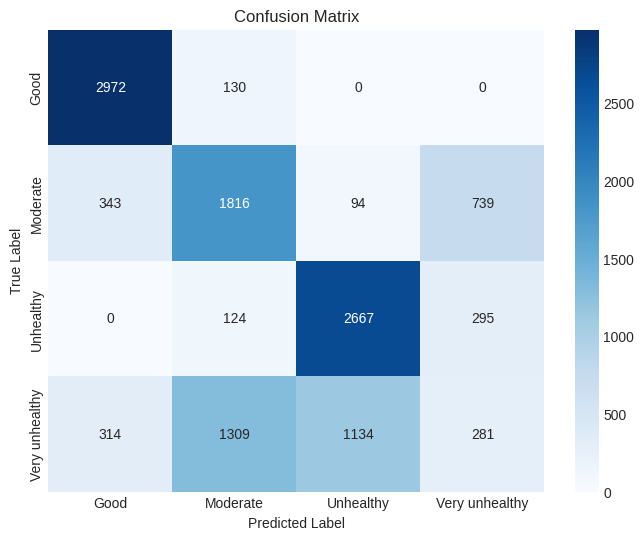

In [48]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

### KNN

In [49]:
# Inisialisasi model KNN
knn = KNeighborsClassifier(n_neighbors=5)  # Anda bisa menyesuaikan n_neighbors sesuai kebutuhan
knn.fit(X_train , y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = knn.predict(X_test)

print("Analysis Model K-Nearest Neighbors (KNN)")
print("")
print("Analysis Metric Eror Model Training")

# Definisikan target names sesuai dengan label Anda
target_names = ['Good', 'Moderate', 'Unhealthy', 'Very unhealthy']
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['K-Nearest Neighbour'] = evaluate_model("K-Nearest Neighbour", y_test, y_pred)

Analysis Model K-Nearest Neighbors (KNN)

Analysis Metric Eror Model Training
                precision    recall  f1-score   support

          Good       0.89      0.99      0.94      3102
      Moderate       0.98      0.85      0.91      2992
     Unhealthy       0.96      0.95      0.95      3086
Very unhealthy       0.93      0.95      0.94      3038

      accuracy                           0.94     12218
     macro avg       0.94      0.93      0.93     12218
  weighted avg       0.94      0.94      0.93     12218

Confusion Matrix:
[[3072   29    0    1]
 [ 385 2536    1   70]
 [   0   21 2919  146]
 [   8    7  122 2901]]
Accuracy Score:  0.9353412997217221
F1 Score:  0.9349014010433918


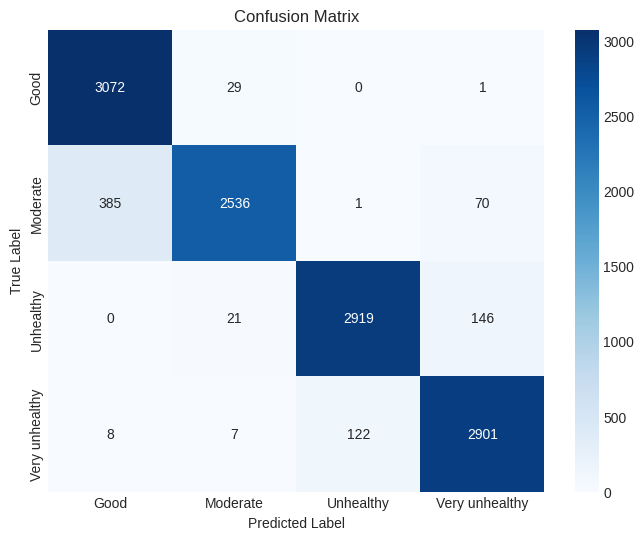

In [50]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

### Naive Bayes

In [51]:
# Inisialisasi model NB
nb = MultinomialNB()
nb.fit(X_train, y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = nb.predict(X_test)

print("Analysis Model Naive Bayes (NB)")
print("")
print("Analysis Metric Eror Model Training")

# Definisikan target names sesuai dengan label Anda
target_names = ['Good', 'Moderate', 'Unhealthy', 'Very unhealthy']
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['Naive Bayes'] = evaluate_model("Naive Bayes", y_test, y_pred)

Analysis Model Naive Bayes (NB)

Analysis Metric Eror Model Training
                precision    recall  f1-score   support

          Good       0.54      0.69      0.60      3102
      Moderate       0.39      0.25      0.30      2992
     Unhealthy       0.45      0.65      0.53      3086
Very unhealthy       0.43      0.27      0.33      3038

      accuracy                           0.47     12218
     macro avg       0.45      0.46      0.44     12218
  weighted avg       0.45      0.47      0.44     12218

Confusion Matrix:
[[2143  401  452  106]
 [ 832  739  999  422]
 [ 306  242 1995  543]
 [ 704  493 1017  824]]
Accuracy Score:  0.4666066459322311
F1 Score:  0.4444768968433482


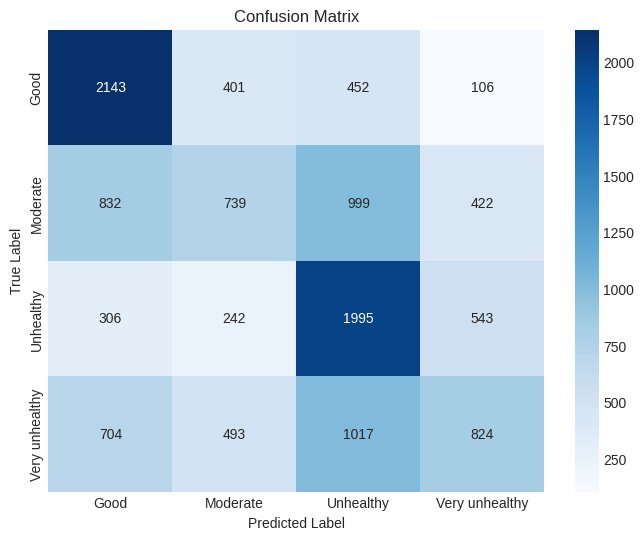

In [52]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

### Random Forest Classifier

In [53]:
# Inisialisasi model Random Forest
rfc = RandomForestClassifier(random_state=42)
rfc.fit(X_train, y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = rfc.predict(X_test)

# Evaluasi Model
print("Analysis Model Random Forest Classifier")
print("")
print("Analysis Metric Error Model Training")

target_names = label_encoder.classes_
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['Random Forest Classifier'] = evaluate_model("Random Forest Classifier", y_test, y_pred)

Analysis Model Random Forest Classifier

Analysis Metric Error Model Training
                precision    recall  f1-score   support

          Good       1.00      1.00      1.00      3102
      Moderate       1.00      1.00      1.00      2992
     Unhealthy       0.97      0.97      0.97      3086
Very unhealthy       0.97      0.96      0.97      3038

      accuracy                           0.98     12218
     macro avg       0.98      0.98      0.98     12218
  weighted avg       0.98      0.98      0.98     12218

Confusion Matrix:
[[3102    0    0    0]
 [   0 2990    0    2]
 [   0    2 2986   98]
 [   4   11   94 2929]]
Accuracy Score:  0.9827303977737764
F1 Score:  0.9827112164503301


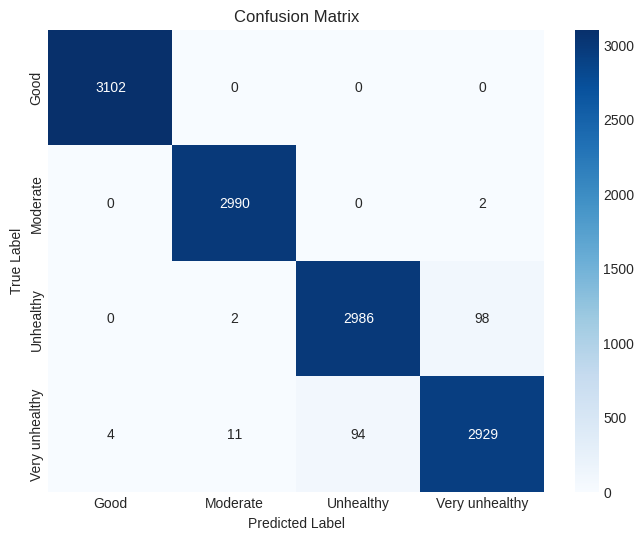

In [54]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

In [55]:
# Visualisasi Feature Importance
feature_importance = rfc.feature_importances_  # Example feature importance values
feature_names = X.columns  # Example feature names
title = "Feature Importance for Random Forest Classifier"
plot_feature_importance(feature_importance, feature_names, title=title)

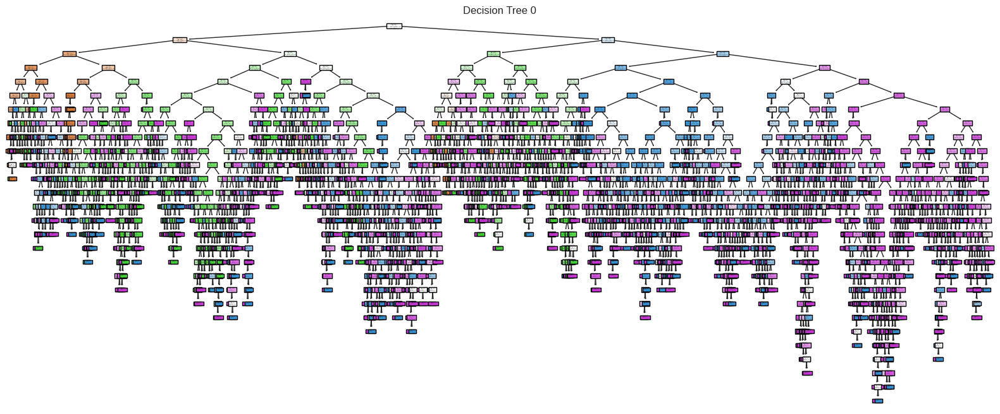

In [56]:
# Pilih salah satu pohon dari Random Forest (misalnya, pohon pertama)
tree_index = 0  # Change this index to plot a different tree
tree = rfc.estimators_[tree_index]

# Plot decision tree
plt.figure(figsize=(20, 8))
plot_tree(tree, feature_names=X_train.columns, class_names=label_encoder.classes_, filled=True)
plt.title(f'Decision Tree {tree_index}')
plt.show()

### Gradient Boosting Classifier

In [57]:
gbc = GradientBoostingClassifier(random_state=42)
gbc.fit(X_train, y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = gbc.predict(X_test)

# Evaluasi Model
print("Analysis Model Gradient Boosting Classifier")
print("")
print("Analysis Metric Error Model Training")

target_names = label_encoder.classes_
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['Gradient Boosting Classifier'] = evaluate_model("Gradient Boosting Classifier", y_test, y_pred)

Analysis Model Gradient Boosting Classifier

Analysis Metric Error Model Training
                precision    recall  f1-score   support

          Good       1.00      1.00      1.00      3102
      Moderate       0.99      1.00      1.00      2992
     Unhealthy       0.93      0.93      0.93      3086
Very unhealthy       0.93      0.93      0.93      3038

      accuracy                           0.97     12218
     macro avg       0.97      0.97      0.97     12218
  weighted avg       0.97      0.97      0.97     12218

Confusion Matrix:
[[3102    0    0    0]
 [   0 2991    0    1]
 [   0    2 2880  204]
 [   4   14  201 2819]]
Accuracy Score:  0.9651334097233589
F1 Score:  0.9650816781576516


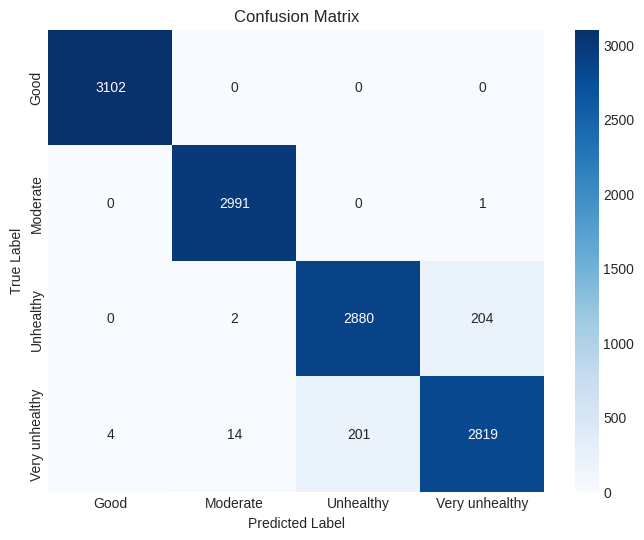

In [58]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

In [59]:
# Visualisasi Feature Importance
feature_importance = gbc.feature_importances_  # Example feature importance values
feature_names = X.columns  # Example feature names
title = "Feature Importance for Gradient Boosting Classifier"
plot_feature_importance(feature_importance, feature_names, title=title)

### XGBoost

In [60]:
# Inisialisasi model XGBoost
xgb_model = XGBClassifier(random_state=42, n_estimators=50, max_depth = 10)
xgb_model.fit(X_train, y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = xgb_model.predict(X_test)

# Evaluasi Model
print("Analysis Model XGBoost Classifier")
print("")
print("Analysis Metric Error Model Training")

target_names = label_encoder.classes_
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['XGBoost'] = evaluate_model("XGBoost", y_test, y_pred)

Analysis Model XGBoost Classifier

Analysis Metric Error Model Training
                precision    recall  f1-score   support

          Good       1.00      1.00      1.00      3102
      Moderate       0.99      0.99      0.99      2992
     Unhealthy       0.96      0.95      0.96      3086
Very unhealthy       0.95      0.96      0.95      3038

      accuracy                           0.98     12218
     macro avg       0.98      0.98      0.98     12218
  weighted avg       0.98      0.98      0.98     12218

Confusion Matrix:
[[3100    0    0    2]
 [   0 2974    0   18]
 [   0    2 2937  147]
 [   3   19  107 2909]]
Accuracy Score:  0.975609756097561
F1 Score:  0.975614096560085


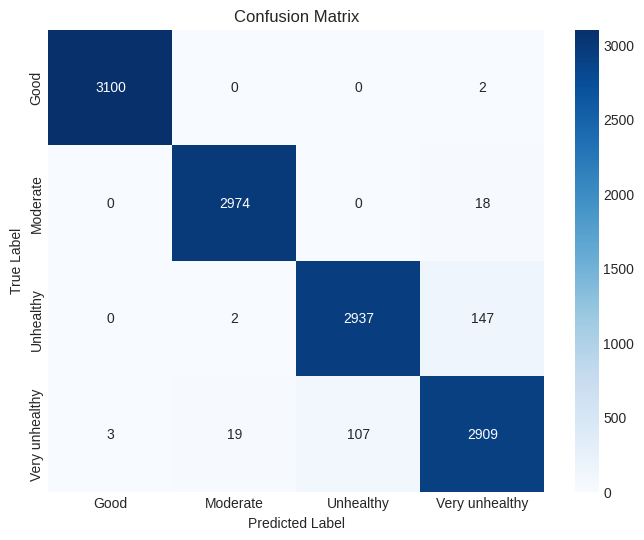

In [61]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

In [62]:
# Visualisasi Feature Importance
feature_importance = xgb_model.feature_importances_  # Example feature importance values
feature_names = X.columns  # Example feature names
title = "Feature Importance for XGBoost Classifier"
plot_feature_importance(feature_importance, feature_names, title=title)

### CatBoost

In [63]:
# Inisialisasi model catboost
cb_model = CatBoostClassifier(iterations=2000, eval_metric = "AUC",verbose=0)
cb_model.fit(X_train, y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = cb_model.predict(X_test)

# Evaluasi Model
print("Analysis Model Catboost Classifier")
print("")
print("Analysis Metric Error Model Training")

target_names = label_encoder.classes_
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['Catboost'] = evaluate_model("Catboost", y_test, y_pred)

Analysis Model Catboost Classifier

Analysis Metric Error Model Training
                precision    recall  f1-score   support

          Good       1.00      1.00      1.00      3102
      Moderate       1.00      1.00      1.00      2992
     Unhealthy       0.96      0.94      0.95      3086
Very unhealthy       0.94      0.95      0.95      3038

      accuracy                           0.97     12218
     macro avg       0.97      0.97      0.97     12218
  weighted avg       0.97      0.97      0.97     12218

Confusion Matrix:
[[3102    0    0    0]
 [   0 2987    0    5]
 [   0    2 2916  168]
 [   9   11  130 2888]]
Accuracy Score:  0.9733999017842527
F1 Score:  0.9733711814779927


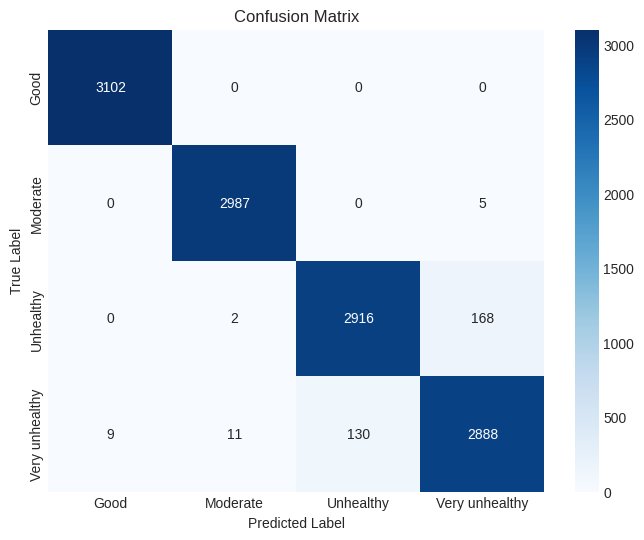

In [64]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

In [65]:
# Visualisasi Feature Importance
feature_importance = cb_model.feature_importances_  # Example feature importance values
feature_names = X.columns  # Example feature names
title = "Feature Importance for CatBoost Classifier"
plot_feature_importance(feature_importance, feature_names, title=title)

### LightGBM

In [66]:
# Inisialisasi model LightGBM
lgbm_model = LGBMClassifier(random_state=42)
lgbm_model.fit(X_train, y_train)

# Mendapatkan prediksi dari model yang telah dilatih
y_pred = lgbm_model.predict(X_test)

# Evaluasi Model
print("Analysis Model LightGBM Classifier")
print("")
print("Analysis Metric Error Model Training")

target_names = label_encoder.classes_
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['LightGBM'] = evaluate_model("LightGBM", y_test, y_pred)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002816 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1528
[LightGBM] [Info] Number of data points in the train set: 48870, number of used features: 6
[LightGBM] [Info] Start training from score -1.390190
[LightGBM] [Info] Start training from score -1.381192
[LightGBM] [Info] Start training from score -1.388876
[LightGBM] [Info] Start training from score -1.384945
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Analysis Model LightGBM Classifier

Analysis Metric Error Model Training
                precision    recall  f1-score   support

          Good       1.00      1.00      1.00      3102
      Moderate       0.99      1.00      0.99      2992
     Unhealthy       0.96      0.94      0.95      3086
Very unhealthy       0.93      0.95      0.94      3038

      accuracy                           0.97     12218
     macro

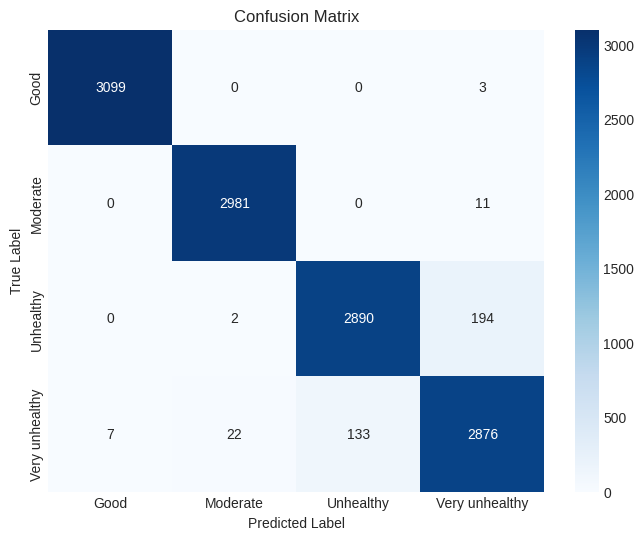

In [67]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

In [68]:
# Visualisasi Feature Importance
feature_importance = lgbm_model.feature_importances_  # Example feature importance values
feature_names = X.columns  # Example feature names
title = "Feature Importance for LightGBM Classifier"
plot_feature_importance(feature_importance, feature_names, title=title)

## Hyperparameter Tuning

In [69]:
skf = StratifiedKFold(n_splits = 3)
kf = KFold(n_splits=3)

### Random Forest With GridSearhCV

In [70]:
rf = RandomForestClassifier()

params = {
    'n_estimators': [50, 100],
    'criterion': ['log_loss', 'gini', 'entropy'],
    'max_depth': [2, 3, 4],
    'min_samples_leaf': [1,2,4,5],
    'max_leaf_nodes': [4,10],
    'max_depth': [2,4],
    'bootstrap': [True],
}

rf_grid = GridSearchCV(estimator = rf,
                       param_grid = params,
                       scoring = 'roc_auc',
                       cv = skf,
                       n_jobs = -1,
                       verbose = 1)

rf_grid.fit(X_train, y_train)

print('Best score:', rf_grid.best_score_)
print('Best param:', rf_grid.best_params_)

best_rf = rf_grid.best_estimator_
print("Best model: ",best_rf)

y_pred = best_rf.predict(X_test)

# Evaluasi Model
print("Analysis Model Random Forest GridSearch")
print("")
print("Analysis Metric Error Model Training")

target_names = label_encoder.classes_
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['Random Forest GridSearch'] = evaluate_model("Random Forest GridSearch", y_test, y_pred)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



Fitting 3 folds for each of 96 candidates, totalling 288 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



Best score: nan
Best param: {'bootstrap': True, 'criterion': 'log_loss', 'max_depth': 2, 'max_leaf_nodes': 4, 'min_samples_leaf': 1, 'n_estimators': 50}
Best model:  RandomForestClassifier(criterion='log_loss', max_depth=2, max_leaf_nodes=4,
                       n_estimators=50)
Analysis Model Random Forest GridSearch

Analysis Metric Error Model Training
                precision    recall  f1-score   support

          Good       0.72      1.00      0.84      3102
      Moderate       0.55      0.77      0.65      2992
     Unhealthy       0.72      0.86      0.78      3086
Very unhealthy       1.00      0.02      0.04      3038

      accuracy                           0.67     12218
     macro avg       0.75      0.66      0.58     12218
  weighted avg       0.75      0.67      0.58     12218

Confusion Matrix:
[[3102    0    0    0]
 [ 632 2318   42    0]
 [ 131  315 2640    0]
 [ 442 1546  985   65]]
Accuracy Score:  0.6650024553936814
F1 Score:  0.5788131735056522


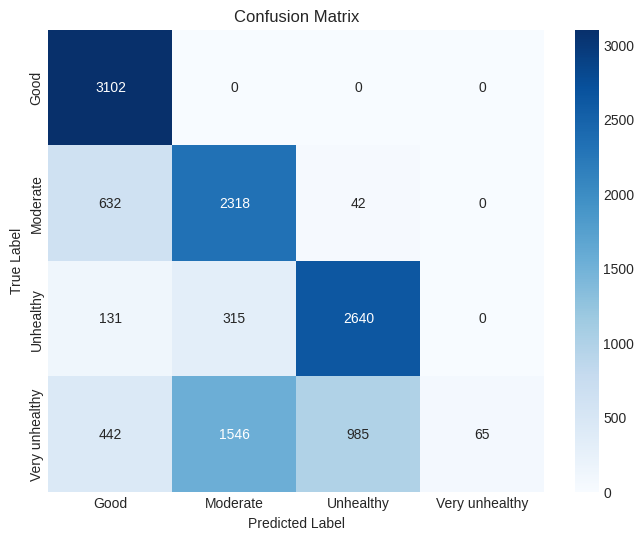

In [71]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

### XGBoost With GridSearchCV

In [ ]:
xgb = XGBClassifier()

params = {
    'n_estimators': [50, 100],
    'learning_rate': [0.01,0.05,0.1],
    'booster': ['gbtree', 'gblinear'],
    'gamma': [0, 0.5, 1],
    'reg_alpha': [0, 0.5, 1],
    'reg_lambda': [0.5, 1, 5],
    'base_score': [0.2, 0.5, 1]
}

xgb_grid = GridSearchCV(estimator = xgb,
                   param_grid = params,
                   scoring = 'roc_auc',
                   cv = skf,
                   n_jobs = -1,
                   verbose = 1)

xgb_grid.fit(X_train, y_train)

print('Best score:', xgb_grid.best_score_)
print('Best param:', xgb_grid.best_params_)

best_xgb = xgb_grid.best_estimator_
print("Best model: ",best_xgb)

y_pred = best_xgb.predict(X_test)

# Evaluasi Model
print("Analysis Model XGBoost GridSearch")
print("")
print("Analysis Metric Error Model Training")

target_names = label_encoder.classes_
print(classification_report(y_test, y_pred, target_names=target_names))

print('Confusion Matrix:')
print(confusion_matrix(y_test, y_pred))

print("Accuracy Score: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))

resultsDict['XGBoost GridSearch'] = evaluate_model("XGBoost GridSearch", y_test, y_pred)

Fitting 3 folds for each of 972 candidates, totalling 2916 fits


In [ ]:
# Visualisasi hasil kinerja model
plot_confusion_matrix(y_test, y_pred, target_names)
print("")
plot_roc_curve_multiclass(y_test, y_pred, classes)

## Evaluasi Model

In [ ]:
# Membuat DataFrame dari dictionary
results_df = pd.concat([pd.DataFrame(v).set_index('Model') for v in resultsDict.values()], axis=0)

# Define a function to highlight minimum values for MAE and RMSE, and maximum values for other columns
def highlight_min_max(col):
        is_max = col == col.max()    # Semakin besar nilainya semakin baik
        return ['background-color: #09b310' if v else '' for v in is_max]

# Apply the function to the entire DataFrame
styled_df = results_df.style.apply(highlight_min_max)

# Display the styled DataFrame
styled_df

In [ ]:
def bar_metrics(results_df):
    df = results_df.copy()

    # Definisikan palet warna
    palette = sns.color_palette("husl", n_colors=len(df.columns))

    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 15))

    # Accuracy plot
    df.sort_values(by='Accuracy').plot(kind="bar", y='Accuracy', color=palette, ax=axes[1, 1], legend=False)
    axes[0, 0].set_title("Accuracy Metric, higher is better")

    # Recall plot
    df.sort_values(by='Recall').plot(kind="bar", y='Recall', color=palette, ax=axes[1, 0], legend=False)
    axes[0, 1].set_title("Recall Metric, higher is better")

    # Precision plot
    df.sort_values(by='Precision').plot(kind="bar", y='Precision', color=palette, ax=axes[0, 1], legend=False)
    axes[1, 0].set_title("Precision Metric, higher is better")

    # F1 Score plot
    df.sort_values(by='F1 Score').plot(kind="bar", y='F1 Score', color=palette, ax=axes[0, 0], legend=False)
    axes[1, 1].set_title("F1 Score Metric, higher is better")

    plt.tight_layout()
    plt.show()

# Panggil fungsi bar_metrics dengan DataFrame hasil evaluasi model Anda
bar_metrics(results_df)

# Deployment

## Simpan Model

In [ ]:
import pickle
# Simpan model terbaik

model1 = rfc  # Model Random Forest Classifier
filename1= 'rfc.pkl'
model2 = xgb_model  # Model XGBoost Classifier
filename2= 'xgb.sav'

pickle.dump(model1, open(filename1,'wb'))
pickle.dump(model2, open(filename2,'wb'))

# Forecast Time Series (Future Development)

## Import Library dan Dataset

In [4]:
from statsmodels.tsa.seasonal import seasonal_decompose
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

import numpy as np
from numpy import array
from numpy import hstack

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error

import tensorflow as tf
from tensorflow.keras import optimizers
from keras.models import Sequential
from keras.layers import LSTM, Bidirectional, Dense, RepeatVector,TimeDistributed,Dropout
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.losses import Huber
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler

In [5]:
df_timeseries = pd.read_csv("/content/drive/MyDrive/GreatEdu/Final Project/dataset/df_final.csv")

# Konversi kolom 'date' menjadi datetime
df_timeseries['Date'] = pd.to_datetime(df_timeseries['Date'])

# Set 'Date' column as the index
df_timeseries.set_index('Date', inplace=True)

df_timeseries = df_timeseries.drop(['Latitude', 'Longitude', 'Station code', 'AQI Category'], axis = 1)

df_timeseries.head()

,SO2,NO2,O3,CO,PM10,PM2.5,AQI,District
Date,,,,,,,,
2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94,188.11,Jongno-gu
2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94,188.11,Jongno-gu
2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83,161.49,Jongno-gu
2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92,99.79,Jongno-gu
2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96,67.90,Jongno-gu


## Pemisahan Dataset Berdasarkan Daerah

In [6]:
unique_districts = df_timeseries['District'].unique()
unique_districts

array(['Jongno-gu', 'Jung-gu', 'Yongsan-gu', 'Eunpyeong-gu',
       'Seodaemun-gu', 'Mapo-gu', 'Seongdong-gu', 'Gwangjin-gu',
       'Dongdaemun-gu', 'Jungnang-gu', 'Seongbuk-gu', 'Gangbuk-gu',
       'Dobong-gu', 'Nowon-gu', 'Yangcheon-gu', 'Gangseo-gu', 'Guro-gu',
       'Geumcheon-gu', 'Yeongdeungpo-gu', 'Dongjak-gu', 'Gwanak-gu',
       'Seocho-gu', 'Gangnam-gu', 'Songpa-gu', 'Gangdong-gu'],
      dtype=object)

In [7]:
def process_station_data(df, unique_districts):
    station_dfs = {}
    for district in unique_districts:
        # Memfilter data berdasarkan kode stasiun
        station_df = df[df['District'] == district].copy()

        # Mengatur kolom 'Date' sebagai indeks dan menghapus kolom 'District'
        station_df.drop(['District', 'AQI'], axis=1, inplace=True)

        # Menyimpan DataFrame ke dalam dictionary dengan kunci sesuai dengan kode stasiun
        station_dfs[f'df_{district}'] = station_df

    return station_dfs

station_dfs = process_station_data(df_timeseries, unique_districts)

# Memanggil head() untuk setiap DataFrame di dalam dictionary dan mencetak hasilnya
for key, df in station_dfs.items():
    print(f'{key} head:\n{df.head()}\n')

df_Jongno-gu head:
            SO2  NO2   O3   CO  PM10  PM2.5
Date                                       
2017-01-01 0.00 0.05 0.00 0.99 81.67  58.94
2017-01-02 0.01 0.05 0.02 0.99 98.19  58.94
2017-01-03 0.01 0.05 0.01 0.83 72.92  51.83
2017-01-04 0.01 0.06 0.01 0.99 51.12  34.92
2017-01-05 0.00 0.04 0.01 0.62 34.88  21.96

df_Jung-gu head:
            SO2  NO2   O3   CO  PM10  PM2.5
Date                                       
2017-01-01 0.01 0.06 0.00 0.99 81.42  58.94
2017-01-02 0.01 0.04 0.02 0.89 98.19  58.94
2017-01-03 0.01 0.05 0.01 0.70 72.92  49.79
2017-01-04 0.01 0.06 0.01 0.86 50.96  34.38
2017-01-05 0.00 0.04 0.01 0.65 34.67  23.12

df_Yongsan-gu head:
            SO2  NO2   O3   CO  PM10  PM2.5
Date                                       
2017-01-01 0.01 0.04 0.00 0.99 77.38  58.94
2017-01-02 0.01 0.04 0.01 0.98 98.19  58.94
2017-01-03 0.01 0.04 0.01 0.79 64.96  54.38
2017-01-04 0.01 0.04 0.01 0.91 49.21  38.58
2017-01-05 0.00 0.03 0.01 0.63 28.79  23.08

df_Eunpyeong-gu h

## Persiapan Dataset

Kami menggunakan dataset dari daerah Jongno-gu untuk melatih model

In [8]:
df_model = station_dfs['df_Jongno-gu']
df_model.head()

,SO2,NO2,O3,CO,PM10,PM2.5
Date,,,,,,
2017-01-01,0.00,0.05,0.00,0.99,81.67,58.94
2017-01-02,0.01,0.05,0.02,0.99,98.19,58.94
2017-01-03,0.01,0.05,0.01,0.83,72.92,51.83
2017-01-04,0.01,0.06,0.01,0.99,51.12,34.92
2017-01-05,0.00,0.04,0.01,0.62,34.88,21.96


## Eksplorasi Data

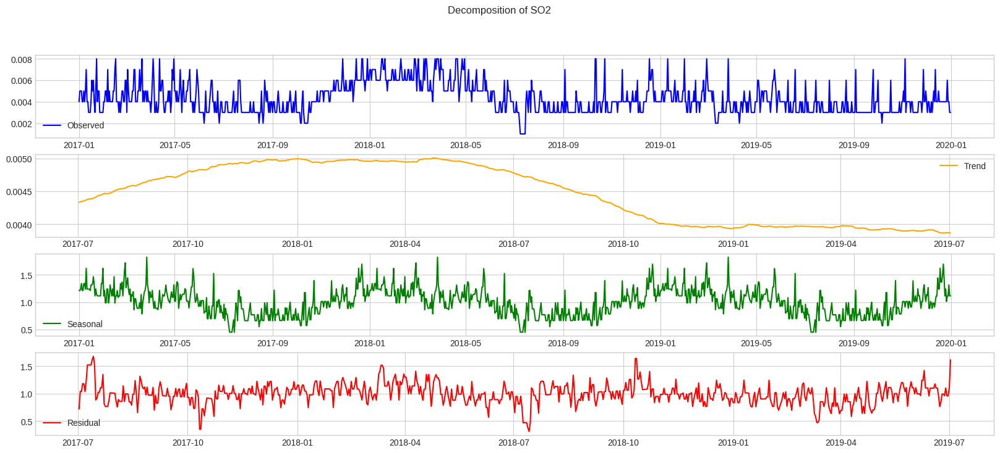

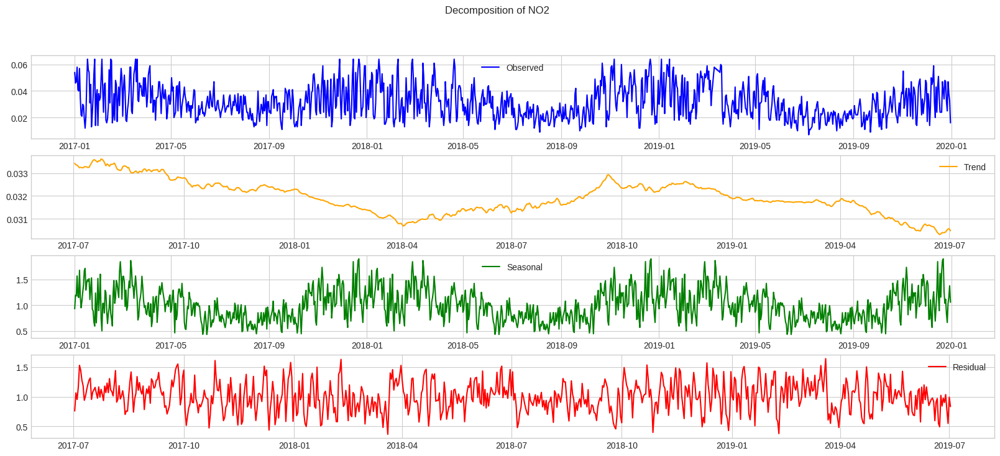

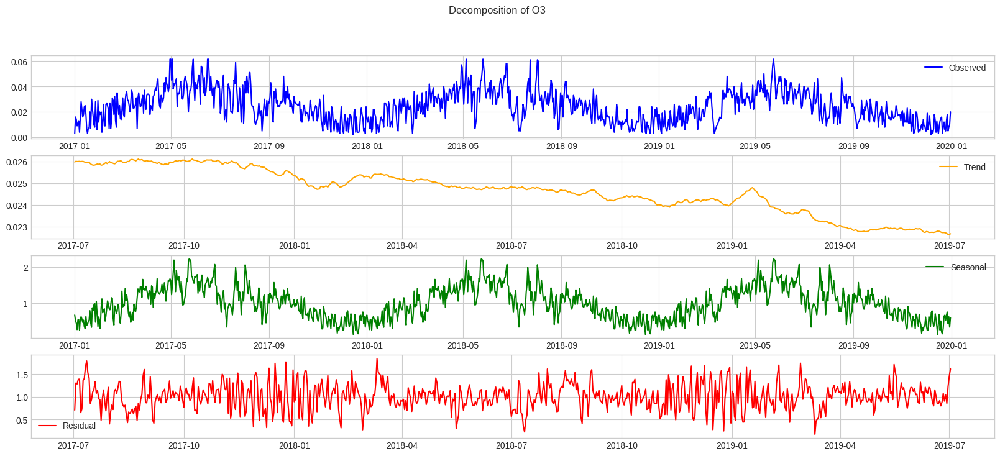

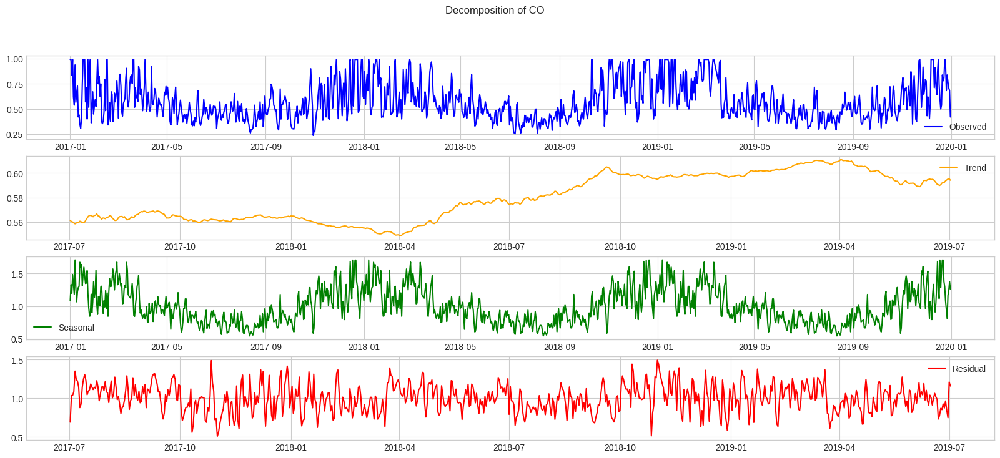

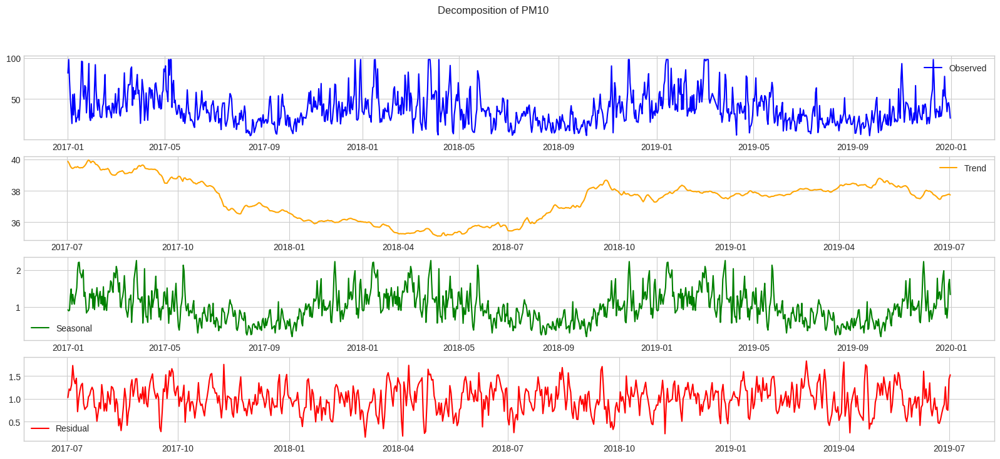

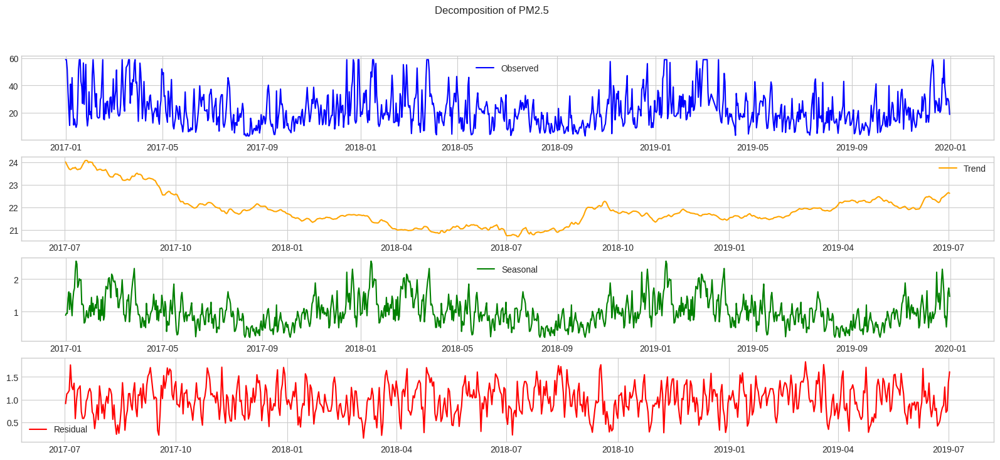

In [9]:
pollutants = ["SO2", "NO2", "O3", "CO", "PM10", "PM2.5"]

# Loop melalui setiap kolom target dan lakukan decomposing
for pollutant in pollutants:
    # Membaca data hujan dari data pelatihan
    train_column = df_model[pollutant]

    # Melakukan decomposing
    result = seasonal_decompose(train_column, model='multiplicative', period=365)  # Sesuaikan dengan periode musiman yang sesuai

    # Plot hasil decomposing
    plt.figure(figsize=(20, 8))
    plt.subplot(4, 1, 1)
    plt.plot(result.observed, label='Observed', color='blue')
    plt.legend()
    plt.subplot(4, 1, 2)
    plt.plot(result.trend, label='Trend', color='orange')
    plt.legend()
    plt.subplot(4, 1, 3)
    plt.plot(result.seasonal, label='Seasonal', color='green')
    plt.legend()
    plt.subplot(4, 1, 4)
    plt.plot(result.resid, label='Residual', color='red')
    plt.legend()
    plt.suptitle(f'Decomposition of {pollutant}')

    plt.show()

ADF Test for SO2:
ADF Statistic: -2.4304488207949166
p-value: 0.13332620293466668
Critical Values:
1%: -3.436459052172655
5%: -2.864237372528562
10%: -2.568206176974609


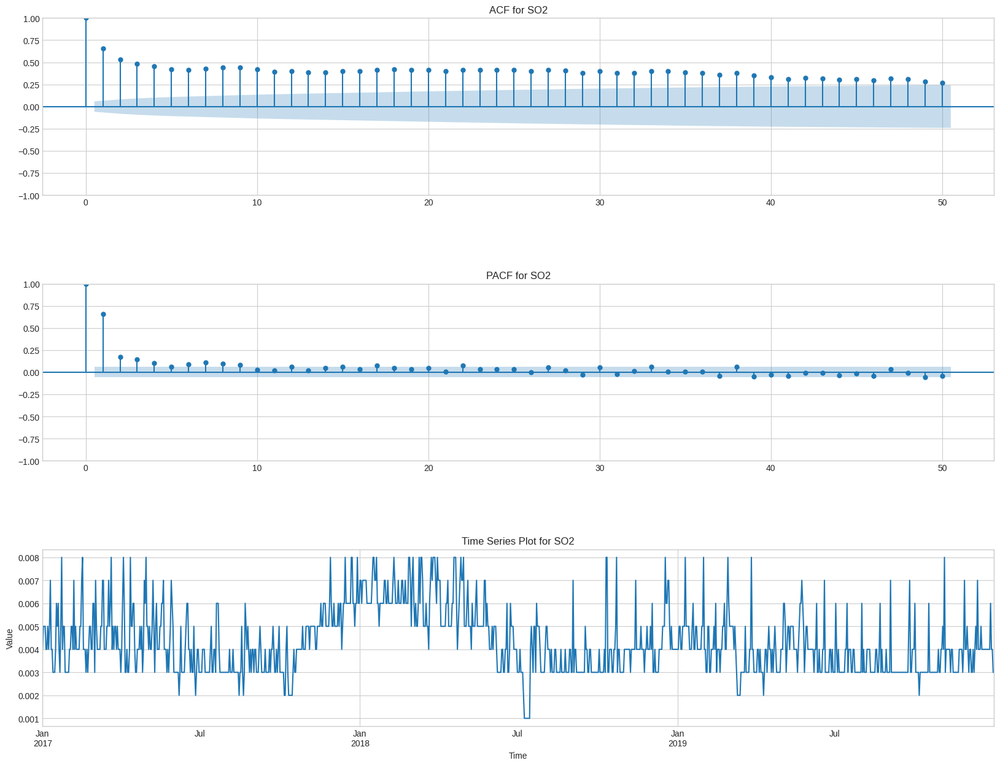

ADF Test for NO2:
ADF Statistic: -3.22164562914112
p-value: 0.018765439917265408
Critical Values:
1%: -3.4364647646486093
5%: -2.864239892228526
10%: -2.5682075189699822


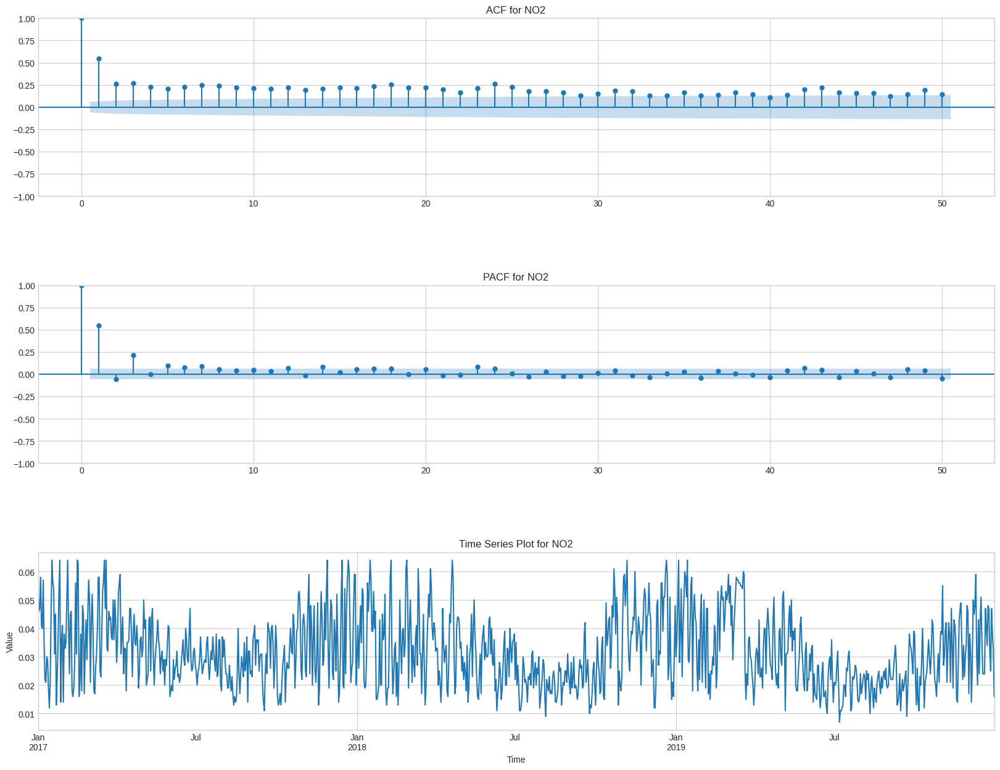

ADF Test for O3:
ADF Statistic: -4.378887858059178
p-value: 0.000323437785194526
Critical Values:
1%: -3.436380183743342
5%: -2.8642025841870655
10%: -2.568187648736553


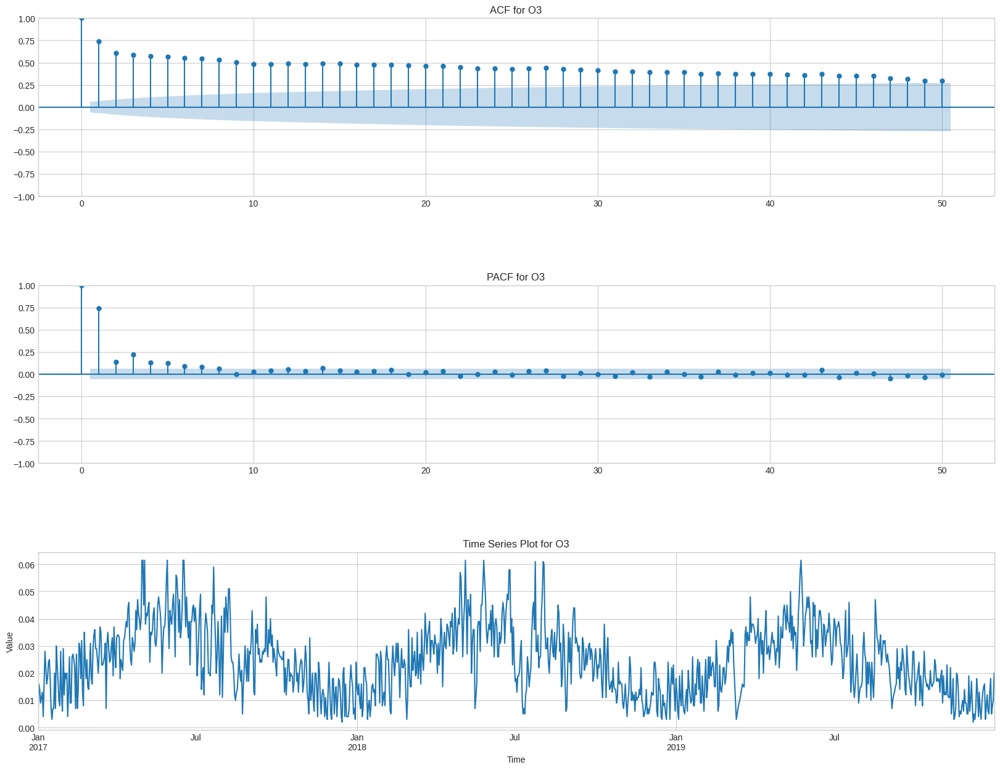

ADF Test for CO:
ADF Statistic: -2.7792194417220966
p-value: 0.061303980689863806
Critical Values:
1%: -3.4364476591811033
5%: -2.864232347211692
10%: -2.5682035004867494


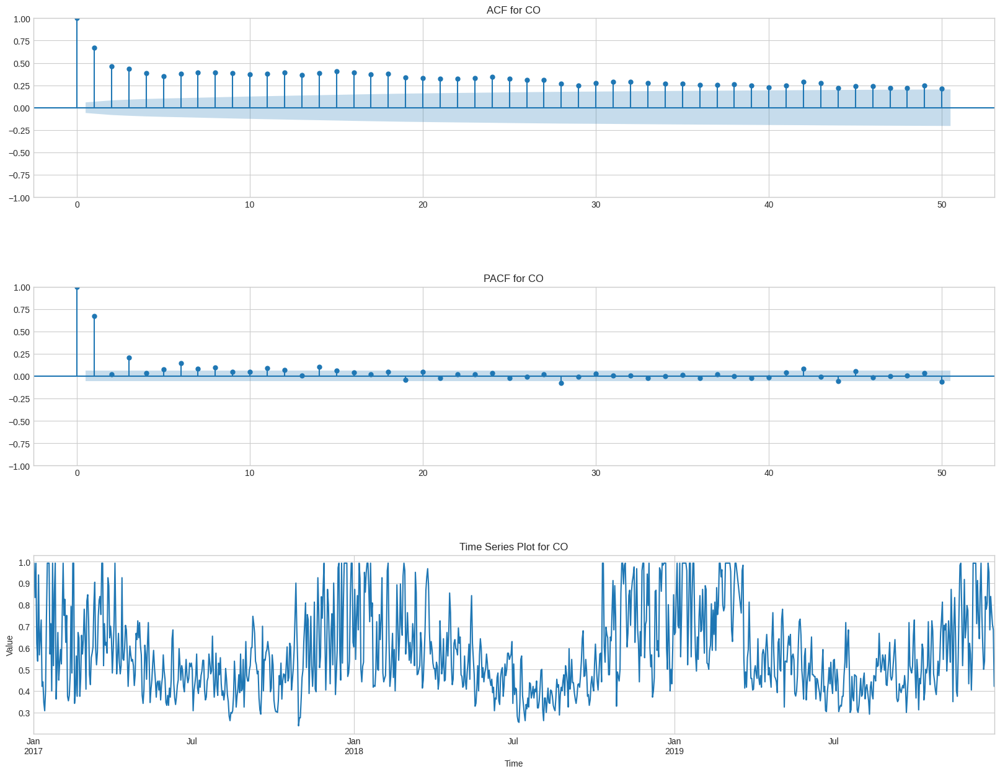

ADF Test for PM10:
ADF Statistic: -4.16398412449263
p-value: 0.000757755800415179
Critical Values:
1%: -3.436425000208065
5%: -2.864222352544219
10%: -2.5681981773275466


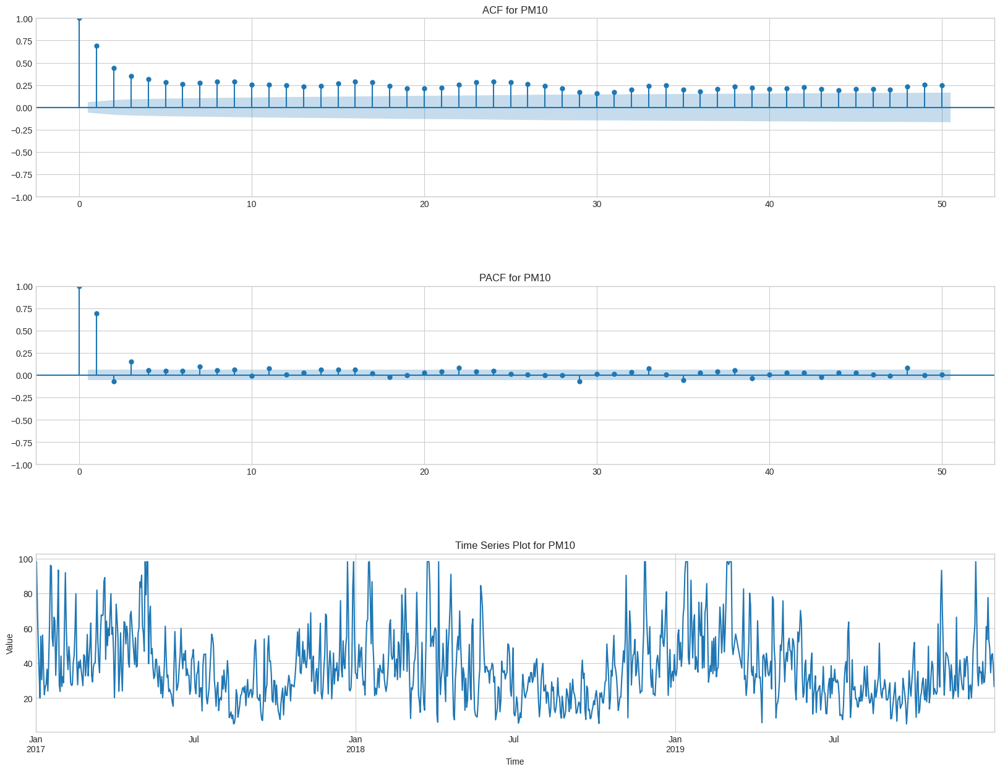

ADF Test for PM2.5:
ADF Statistic: -5.063465062217741
p-value: 1.6594790923154245e-05
Critical Values:
1%: -3.4364137337554785
5%: -2.864217382986235
10%: -2.568195530545688


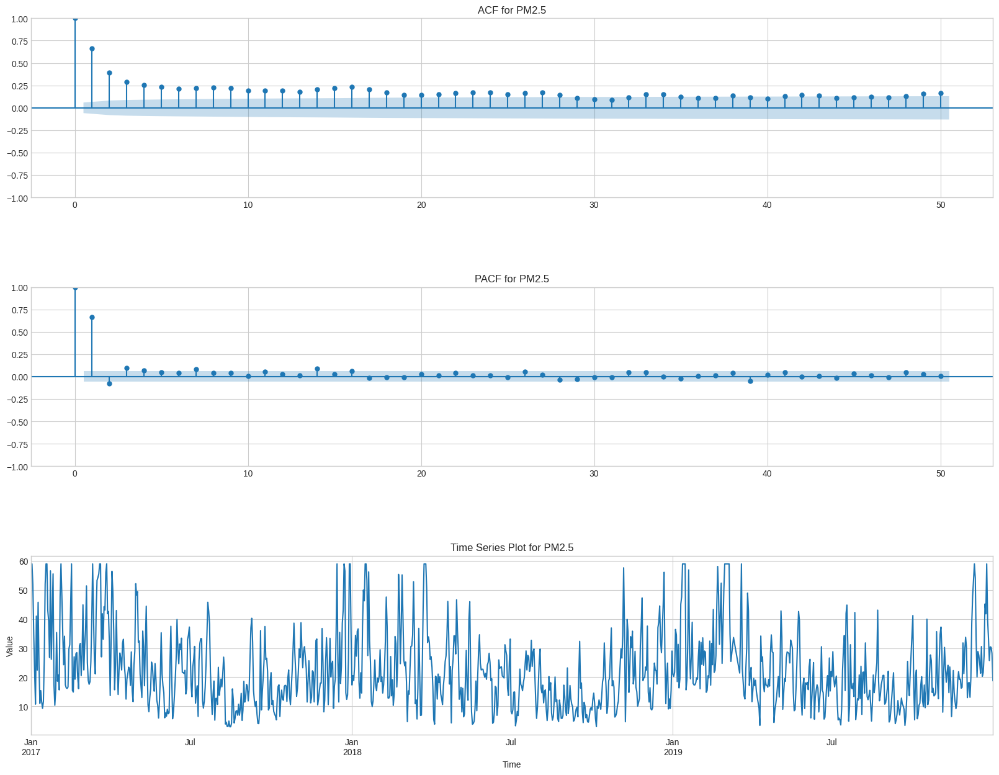

In [10]:
# Mengecek Kestasioneran Data

# Loop through each target pollutant
for pollutant in pollutants:
    # Check for stationarity using Augmented Dickey-Fuller test
    result = adfuller(df_model[pollutant], autolag='AIC')
    print(f'ADF Test for {pollutant}:')
    print(f'ADF Statistic: {result[0]}')
    print(f'p-value: {result[1]}')
    print(f'Critical Values:')
    for key, value in result[4].items():
        print(f'{key}: {value}')

    # Create subplots with space between them
    fig, axes = plt.subplots(3, 1, figsize=(20, 15))
    plt.subplots_adjust(hspace=0.5)  # Adjust the vertical space between subplots

    # Plot ACF and PACF to identify seasonality
    plot_acf(df_model[pollutant], lags=50, ax=axes[0])
    plot_pacf(df_model[pollutant], lags=50, ax=axes[1])
    axes[0].set_title(f'ACF for {pollutant}')
    axes[1].set_title(f'PACF for {pollutant}')

    # Visualize the time series to identify trends
    df_model[pollutant].plot(ax=axes[2])
    axes[2].set_title(f'Time Series Plot for {pollutant}')
    axes[2].set_xlabel('Time')
    axes[2].set_ylabel('Value')

    plt.show()

## Pemisahan Data Train dan Test serta Normalisasi Data

In [11]:
# Membagi data dengan test size 0.3 dan tanpa shuffle
df_train, df_test = train_test_split(df_model, test_size=0.3, shuffle=False)

# Scaling menggunakan MinMaxScaler secara terpisah
scaler = MinMaxScaler(feature_range=(0, 1))

# Fit dan transform data pelatihan
df_train_scaled = scaler.fit_transform(df_train)

# Transform data pengujian
df_test_scaled = scaler.transform(df_test)

print('Data scaled for train:', df_train_scaled.shape)
print('\nData scaled for test:', df_test_scaled.shape)

Data scaled for train: (766, 6)

Data scaled for test: (329, 6)


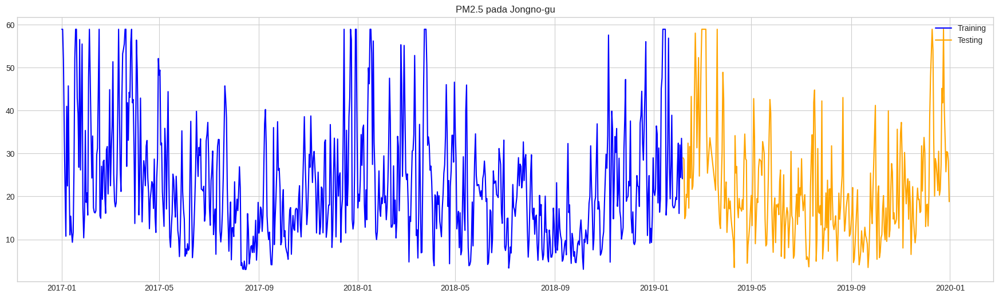

In [12]:
plt.figure(figsize=(22,6))

# Plot df_training in blue
plt.plot(df_train.index, df_train['PM2.5'], label='Training', color='blue')

# Plot df_test in orange
plt.plot(df_test.index, df_test['PM2.5'], label='Testing', color='orange')

plt.title('PM2.5 pada Jongno-gu')

plt.legend(loc='upper right')  # Add legend

## Pembuatan Sequence Window
Kami menggunakan Multivariate Time Series dengan Multi-Step Multi-Output Model

In [13]:
# Split a multivariate sequence into samples
def split_sequences(sequences, n_steps_in, n_steps_out):
	X, y = list(), list()
	for i in range(len(sequences)):
		# find the end of this pattern
		end_ix = i + n_steps_in
		out_end_ix = end_ix + n_steps_out
		# check if we are beyond the dataset
		if out_end_ix > len(sequences):
			break
		# gather input and output parts of the pattern
		seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix:out_end_ix, :]
		X.append(seq_x)
		y.append(seq_y)
	return array(X), array(y)

In [14]:
# Choose a number of time steps
# n_steps_in history data for predict n_steps_out forecast data
n_steps_in, n_steps_out = 1, 1

# Convert into input/output
X_train, y_train = split_sequences(df_train_scaled, n_steps_in, n_steps_out)
X_test, y_test = split_sequences(df_test_scaled, n_steps_in, n_steps_out)

# The dataset knows the number of features
n_features = X_train.shape[2]

print('Total features:', n_features)
print('Total train data (X_train):', X_train.shape)
print('Total validation train data (y_train):', y_train.shape)
print('Total test data (X_test):', X_test.shape)
print('Total validation test data (y_test):', y_test.shape)

Total features: 6
Total train data (X_train): (765, 1, 6)
Total validation train data (y_train): (765, 1, 6)
Total test data (X_test): (328, 1, 6)
Total validation test data (y_test): (328, 1, 6)


In [15]:
# Look at the x_train structure
print('Data input structure for training')
print(X_train[0])

print('\nData output structure for validation')
print(y_train[0])

Data input structure for training
[[0.42857143 0.81818182 0.01680672 1.         0.82263329 1.        ]]

Data output structure for validation
[[0.57142857 0.67272727 0.23529412 1.         1.         1.        ]]


## Pembuatan Model

In [16]:
n_steps_in = X_train.shape[1]
n_features = X_train.shape[2]
n_steps_out = y_train.shape[1]

# Define model
model = Sequential()
model.add(Bidirectional(LSTM(50, activation='relu'),input_shape=(n_steps_in, n_features)))
model.add(RepeatVector(n_steps_out))
model.add(Bidirectional(LSTM(50, activation='relu', return_sequences=True)))
model.add(TimeDistributed(Dense(n_features)))

optimizer = Adam(learning_rate=0.001)
model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

Epoch 1/100
24/24 - 13s - loss: 0.1977 - mae: 0.3783 - val_loss: 0.1258 - val_mae: 0.2940 - lr: 0.0010 - 13s/epoch - 539ms/step
Epoch 2/100
24/24 - 0s - loss: 0.1085 - mae: 0.2586 - val_loss: 0.0366 - val_mae: 0.1431 - lr: 0.0010 - 302ms/epoch - 13ms/step
Epoch 3/100
24/24 - 0s - loss: 0.0455 - mae: 0.1703 - val_loss: 0.0329 - val_mae: 0.1413 - lr: 0.0010 - 284ms/epoch - 12ms/step
Epoch 4/100
24/24 - 0s - loss: 0.0414 - mae: 0.1598 - val_loss: 0.0327 - val_mae: 0.1426 - lr: 0.0010 - 310ms/epoch - 13ms/step
Epoch 5/100
24/24 - 0s - loss: 0.0404 - mae: 0.1593 - val_loss: 0.0312 - val_mae: 0.1388 - lr: 0.0010 - 269ms/epoch - 11ms/step
Epoch 6/100
24/24 - 0s - loss: 0.0392 - mae: 0.1570 - val_loss: 0.0304 - val_mae: 0.1372 - lr: 0.0010 - 301ms/epoch - 13ms/step
Epoch 7/100
24/24 - 0s - loss: 0.0380 - mae: 0.1545 - val_loss: 0.0293 - val_mae: 0.1348 - lr: 0.0010 - 322ms/epoch - 13ms/step
Epoch 8/100
24/24 - 0s - loss: 0.0369 - mae: 0.1521 - val_loss: 0.0283 - val_mae: 0.1324 - lr: 0.0010 - 

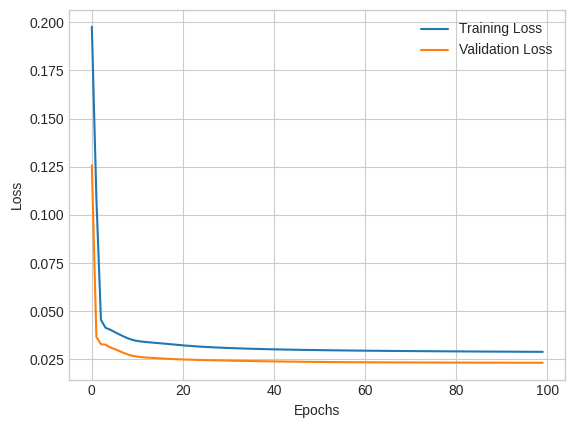

In [17]:
def scheduler(epoch, lr):
    if epoch < 10:
        return lr
    else:
        return lr * 0.99
lr_scheduler = LearningRateScheduler(scheduler)
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Melatih model
history = model.fit(
    X_train, y_train,
    epochs=100,
    batch_size=32,
    validation_data=(X_test, y_test),
    verbose=2,
    shuffle=False,
    callbacks=[lr_scheduler, early_stopping]
)

# Menampilkan ringkasan model
model.summary()
# model.save('my_model.pb')

# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [18]:
model.evaluate(X_test, y_test)

11/11 [==============================] - 0s 3ms/step - loss: 0.0232 - mae: 0.1173


[0.023225899785757065, 0.11727315932512283]

In [19]:
predictions = model.predict(X_test)
print(predictions.shape)
print(y_test.shape)

11/11 [==============================] - 1s 4ms/step
(328, 1, 6)
(328, 1, 6)


In [20]:
# Asumsikan y_test dan prediction sudah tersedia dan di-inverse transform jika diperlukan
prediction = model.predict(X_test)
prediction = prediction.reshape(prediction.shape[0], -1)  # Reshape agar sesuai dengan scaler

# Inverse transform y_test dan prediction
y_test_inverse = scaler.inverse_transform(y_test.reshape(y_test.shape[0], -1))
y_hat_inverse = scaler.inverse_transform(prediction)

predictions = pd.DataFrame(y_hat_inverse)
real = pd.DataFrame(y_test_inverse)

print(predictions.shape)
print(real.shape)

11/11 [==============================] - 0s 4ms/step
(328, 6)
(328, 6)


In [21]:
df_final = pd.DataFrame()

df_final['SO2'] = real[0]
df_final['NO2'] = real[1]
df_final['O3'] = real[2]
df_final['CO'] = real[3]
df_final['PM10'] = real[4]
df_final['PM2.5'] = real[5]

df_final['SO2_pred'] = round(predictions[0], 3)
df_final['NO2_pred'] = round(predictions[1], 3)
df_final['O3_pred'] = round(predictions[2], 3)
df_final['CO_pred'] = round(predictions[3], 3)
df_final['PM10_pred'] = round(predictions[4], 3)
df_final['PM2.5_pred'] = round(predictions[5], 3)

df_final.head(10)

,SO2,NO2,O3,CO,PM10,PM2.5,SO2_pred,NO2_pred,O3_pred,CO_pred,PM10_pred,PM2.5_pred
0,0.00,0.02,0.03,0.53,59.21,28.62,0.00,0.04,0.01,0.77,61.83,33.13
1,0.00,0.02,0.02,0.53,29.04,14.83,0.00,0.03,0.02,0.55,39.52,22.52
2,0.00,0.02,0.03,0.50,33.50,15.54,0.00,0.03,0.02,0.54,27.92,16.31
3,0.00,0.03,0.02,0.59,38.62,20.50,0.00,0.03,0.02,0.51,28.00,15.25
4,0.00,0.02,0.02,0.61,35.17,19.79,0.00,0.03,0.02,0.59,34.04,19.89
5,0.01,0.03,0.02,0.80,52.54,32.42,0.00,0.03,0.02,0.58,32.37,19.17
6,0.00,0.03,0.02,0.59,33.88,17.29,0.00,0.04,0.02,0.68,43.90,26.98
7,0.01,0.04,0.01,0.77,54.21,31.62,0.00,0.03,0.02,0.58,32.25,18.80
8,0.00,0.04,0.01,0.66,35.54,24.29,0.01,0.04,0.02,0.71,47.77,28.18
9,0.00,0.02,0.03,0.81,55.12,43.29,0.00,0.04,0.02,0.63,36.88,23.75


## Evaluasi Metriks

In [22]:
def calculate_metrics(y_true, y_pred, pollutants):
    metrics = {
        'Pollutant': [],
        'MAE': [],
        'RMSE': [],
        'MAPE': []
    }

    for i, pollutant in enumerate(pollutants):
        actual = y_true[:, i].flatten()
        predicted = y_pred[:, i].flatten()

        mae = mean_absolute_error(actual, predicted)
        rmse = np.sqrt(mean_squared_error(actual, predicted))
        mape = np.mean(np.abs((actual - predicted) / actual)) * 100

        metrics['Pollutant'].append(pollutant)
        metrics['MAE'].append(mae)
        metrics['RMSE'].append(rmse)
        metrics['MAPE'].append(mape)

    return pd.DataFrame(metrics)

# Menghitung metrik
metrics_df = calculate_metrics(y_test_inverse, y_hat_inverse, pollutants)

# Tampilkan hasilnya sebagai DataFrame
metrics_df

,Pollutant,MAE,RMSE,MAPE
0,SO2,0.00,0.00,21.04
1,NO2,0.01,0.01,35.18
2,O3,0.01,0.01,39.00
3,CO,0.10,0.13,18.19
4,PM10,9.59,13.02,34.52
5,PM2.5,6.55,8.74,40.19


## Hasil Forecast

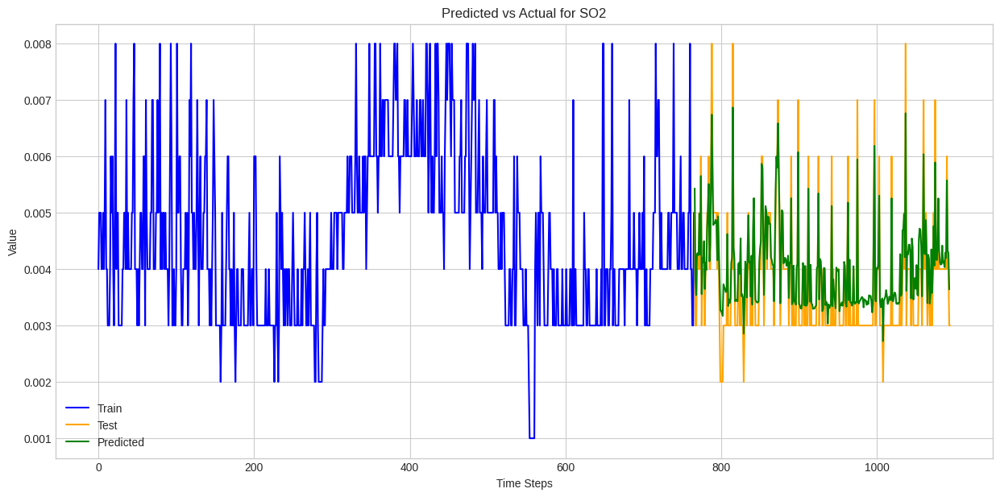

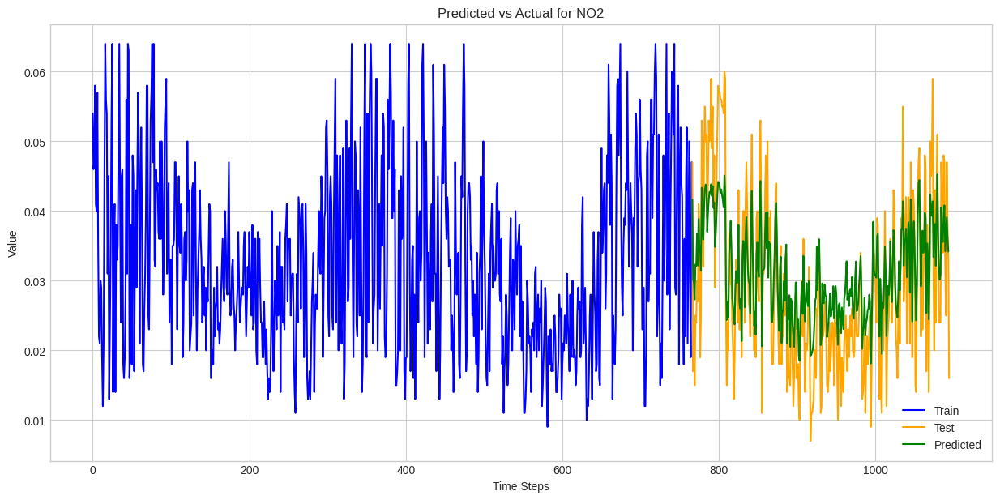

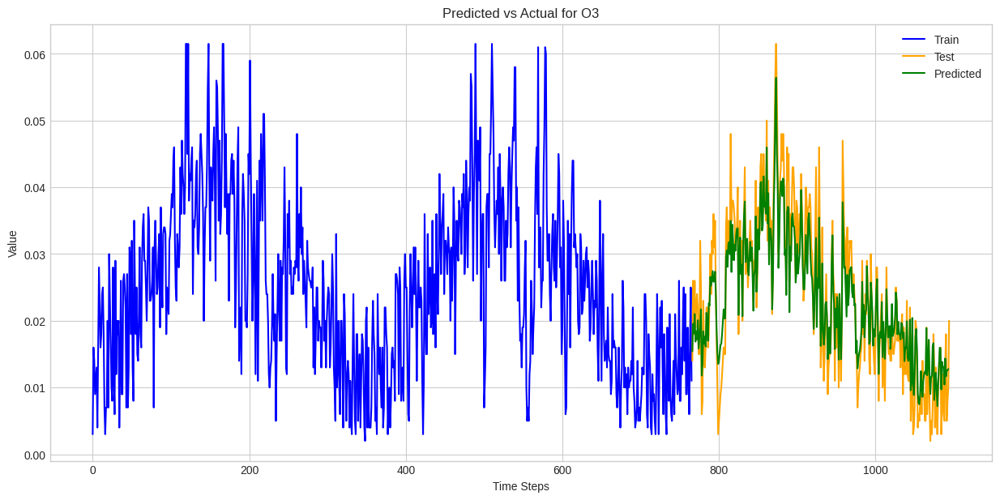

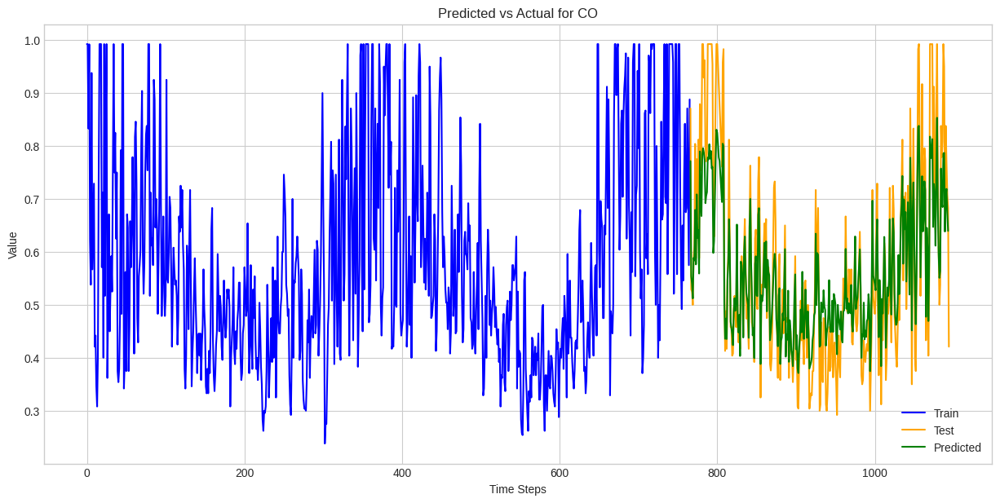

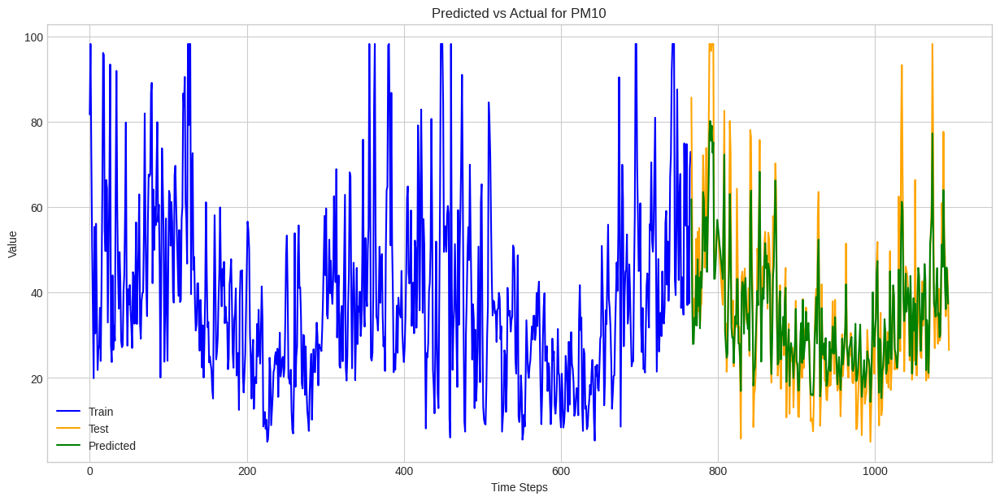

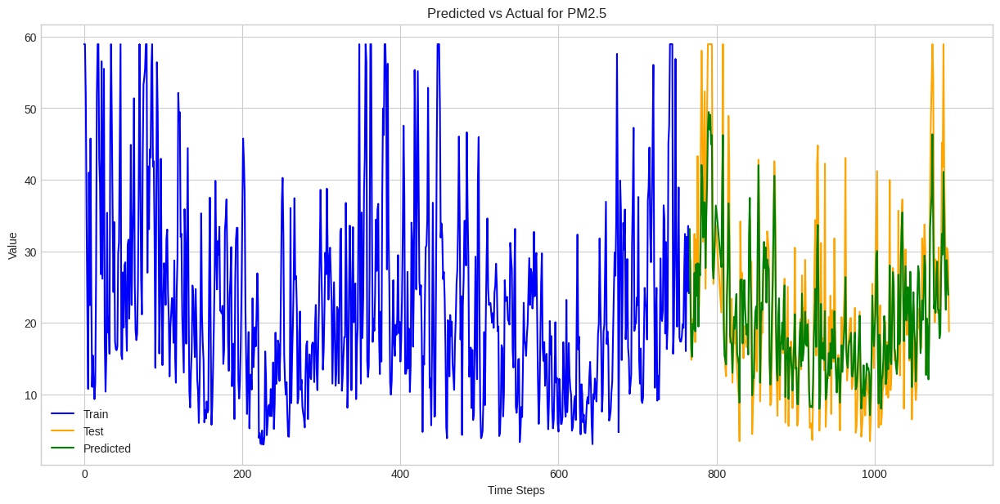

In [23]:
# Lakukan inverse transform pada data yang telah di-scale
df_train_inverse = scaler.inverse_transform(df_train_scaled)
df_test_inverse = scaler.inverse_transform(df_test_scaled)

# Plot training, test, dan predicted data
for i, pollutant in enumerate(pollutants):
    plt.figure(figsize=(15, 7))

    # Plot train data
    train_length = len(df_train)
    plt.plot(range(train_length), df_train_inverse[:, i], label='Train', color='blue')

    # Plot test data
    test_length = len(df_test)
    plt.plot(range(train_length, train_length + test_length), df_test_inverse[:, i], label='Test', color='orange')

    # Plot predicted data
    predicted_length = len(prediction)
    plt.plot(range(train_length, train_length + predicted_length), y_hat_inverse[:, i], label='Predicted', color='green')

    plt.xlabel('Time Steps')
    plt.ylabel('Value')
    plt.title(f'Predicted vs Actual for {pollutant}')
    plt.legend()
    plt.grid(True)
    plt.show()

## Simpan Model

In [24]:
import os
import pickle
from keras.models import load_model

# Fungsi untuk menyimpan model ke dalam file pickle
def save_model_to_pickle(model, filename):
    model.save(filename)  # Menggunakan metode save dari Keras untuk menyimpan model ke file HDF5

# Inisialisasi folder untuk menyimpan model
model_folder = 'models_train/'

# Membuat folder jika belum ada
os.makedirs(model_folder, exist_ok=True)

# Asumsikan model LSTM telah dilatih sebelumnya dan disimpan dalam variabel model

# Menyimpan model ke dalam file HDF5
model_filename = os.path.join(model_folder, 'my_model.h5')
save_model_to_pickle(model, model_filename)
print(f'Model saved to {model_filename}')

Model saved to models_train/my_model.h5


## Load Model

In [25]:
import joblib
model_filename = "/content/models_train/my_model.h5"

# Jika ingin memuat kembali model LSTM dari file HDF5
def load_model_from_file(filename):
    return load_model(filename)

# # Contoh penggunaan untuk memuat model
loaded_model = load_model_from_file(model_filename)
print('Model loaded successfully')
loaded_model.summary()

Model loaded successfully
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirection  (None, 100)               22800     
 al)                                                             
                                                                 
 repeat_vector (RepeatVecto  (None, 1, 100)            0         
 r)                                                              
                                                                 
 bidirectional_1 (Bidirecti  (None, 1, 100)            60400     
 onal)                                                           
                                                                 
 time_distributed (TimeDist  (None, 1, 6)              606       
 ributed)                                                        
                                                                 
Total params: 83806 (327.37 KB

## Prediksi Hari Kedepan

In [26]:
from keras.models import load_model
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Load model LSTM yang telah disimpan sebelumnya
model_filename = "/content/models_train/my_model.h5"
loaded_model = load_model(model_filename)

# Data uji (pastikan data uji sudah diinisialisasi sebelumnya)
test_data = df_model  # Gantilah dengan data uji Anda

# Inisialisasi scaler dan inverse transform data uji jika diperlukan
# scaler = MinMaxScaler()
test_data_scaled = scaler.transform(test_data)

# Inisialisasi jumlah langkah masukan dan keluaran yang sesuai dengan model LSTM Anda
n_steps_in = 1  # Jumlah langkah masukan
n_steps_out = 1  # Jumlah langkah keluaran

# Memanggil split_sequences untuk membagi data uji
test_data_sequences, _ = split_sequences(test_data_scaled, n_steps_in, n_steps_out)

# Prediksi dengan model LSTM
forecast = []

# Melakukan prediksi untuk n hari ke depan
n_forecast_days = 30 # Jumlah hari yang ingin diprediksi
for seq in test_data_sequences[:n_forecast_days]:
    # Reshape data sesuai dengan input shape yang diharapkan oleh model LSTM
    input_data_reshaped = seq.reshape((1, n_steps_in, test_data.shape[1]))

    # Prediksi hari berikutnya
    predicted = loaded_model.predict(input_data_reshaped)

    # Simpan hasil prediksi
    forecast.append(predicted[0])

# Reshape forecast array to 2 dimensions before inverse transform
forecast_reshaped = np.array(forecast).reshape(-1, test_data.shape[1])

# Inverse transform hasil prediksi agar kembali ke skala aslinya
forecast_inverse = scaler.inverse_transform(forecast_reshaped)

1/1 [==============================] - 0s 24ms/step


In [27]:
# Membuat DataFrame untuk hasil peramalan
forecast_df = pd.DataFrame(forecast_inverse, columns=test_data.columns)
forecast_df = forecast_df.round(3)

# Mengatur indeks DataFrame ke data terakhir pada test_data
start_date = df_test.index[-1] + pd.DateOffset(days=1)
date_range = pd.date_range(start=start_date, periods=len(forecast_df))
forecast_df.index = date_range

# Tampilkan hasil peramalan
forecast_df

,SO2,NO2,O3,CO,PM10,PM2.5
2020-01-01,0.00,0.04,0.01,0.80,67.91,43.06
2020-01-02,0.00,0.04,0.02,0.78,72.02,43.15
2020-01-03,0.00,0.04,0.02,0.72,60.19,37.76
2020-01-04,0.00,0.05,0.01,0.84,55.83,35.60
2020-01-05,0.00,0.04,0.02,0.64,37.85,23.50
2020-01-06,0.00,0.03,0.02,0.58,29.59,17.63
2020-01-07,0.00,0.04,0.01,0.81,56.75,36.12
2020-01-08,0.00,0.03,0.02,0.59,34.08,21.51
2020-01-09,0.00,0.03,0.02,0.60,43.62,27.98
2020-01-10,0.01,0.03,0.01,0.66,35.35,19.94


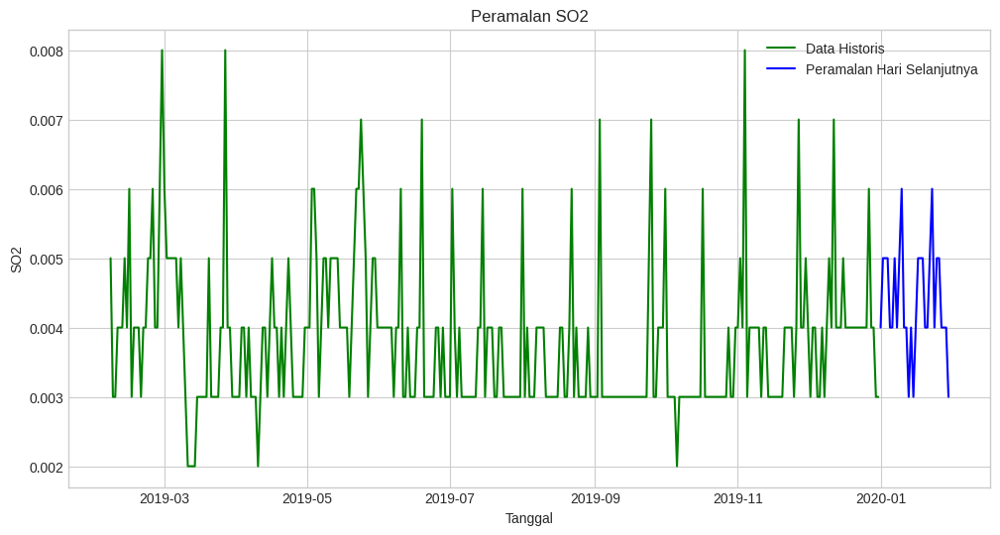

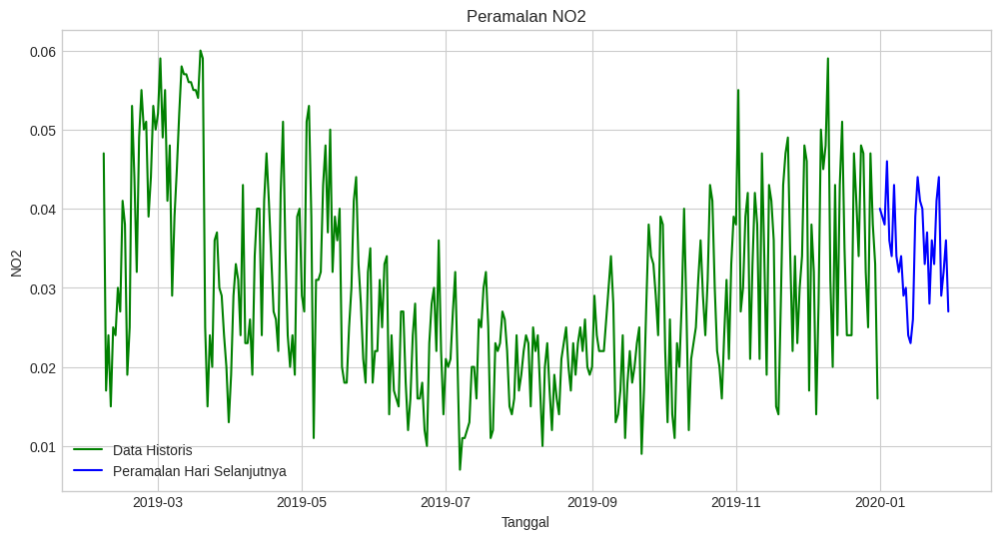

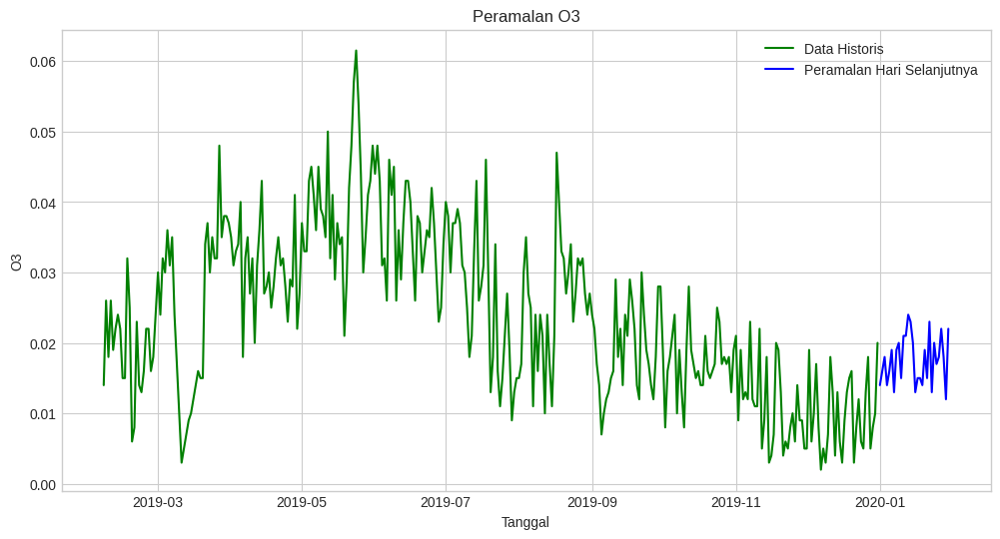

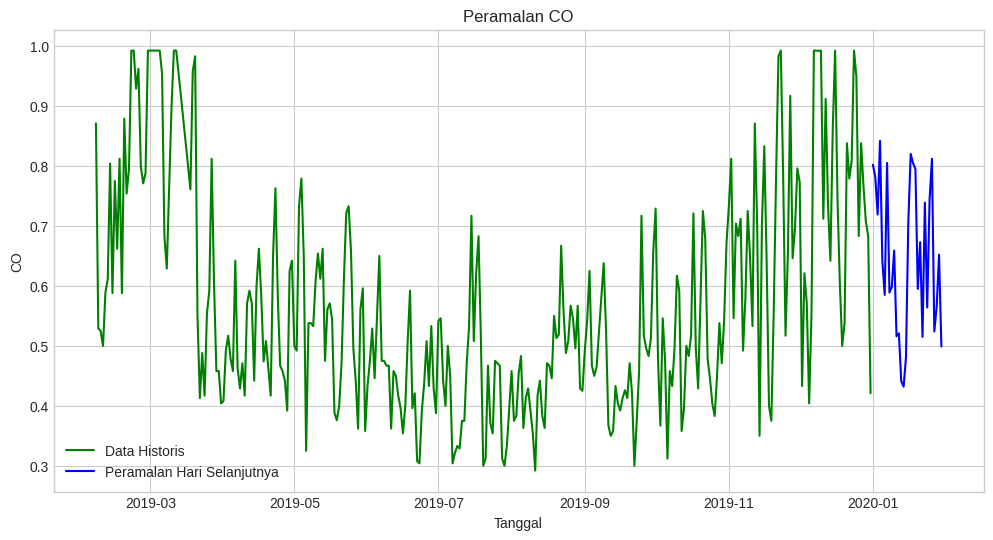

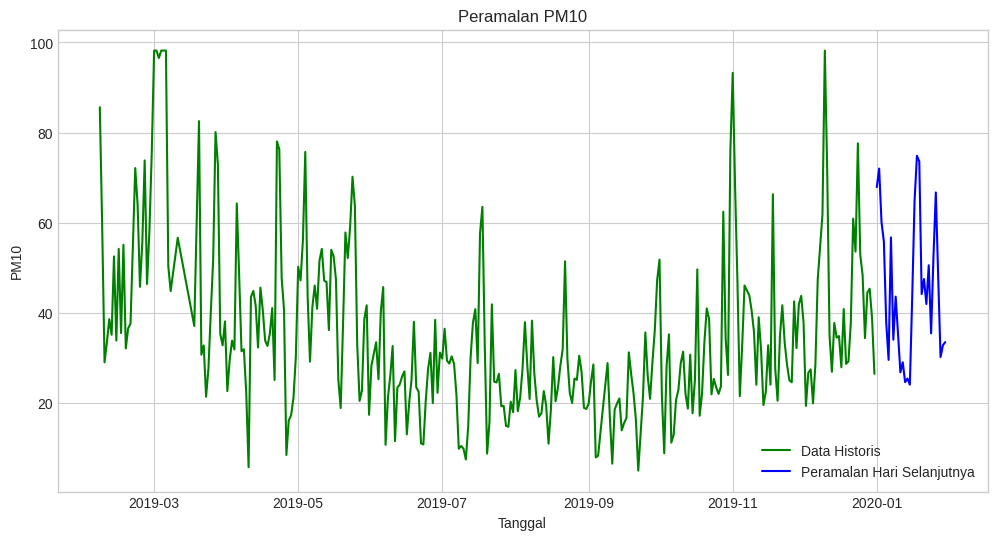

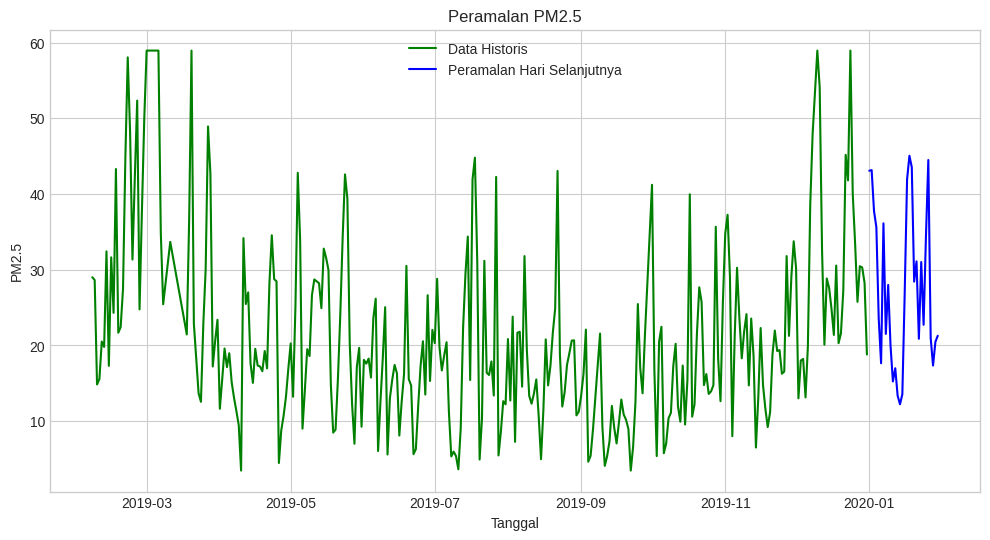

In [28]:
for pollutant in pollutants:
    plt.figure(figsize=(12, 6))
    plt.plot(df_test.index, df_test[pollutant], label='Data Historis', color='green')
    plt.plot(forecast_df.index, forecast_df[pollutant], label='Peramalan Hari Selanjutnya', color='blue')
    plt.title(f'Peramalan {pollutant}')
    plt.xlabel('Tanggal')
    plt.ylabel(pollutant)
    plt.legend()
    plt.show()

## Hyperparameter Tuning

In [29]:
%pip install optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 380.1/380.1 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 9.8 MB/s eta 0:00:00


In [30]:
import optuna

# Define the objective function for Optuna
def objective(trial):
    # Suggest hyperparameters
    lstm_units = trial.suggest_int('lstm_units', 10, 200)
    dense_units = trial.suggest_int('dense_units', 10, 200)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.0, 0.5)
    recurrent_dropout_rate = trial.suggest_uniform('recurrent_dropout_rate', 0.0, 0.5)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    epochs = trial.suggest_int('epochs', 20, 100)
    batch_size = trial.suggest_int('batch_size', 16, 128)

    # Define the model
    model = Sequential()
    model.add(Bidirectional(LSTM(lstm_units, activation='relu', dropout=dropout_rate, recurrent_dropout=recurrent_dropout_rate), input_shape=(n_steps_in, n_features)))
    model.add(RepeatVector(n_steps_out))
    model.add(Bidirectional(LSTM(lstm_units, activation='relu', return_sequences=True, dropout=dropout_rate, recurrent_dropout=recurrent_dropout_rate)))
    model.add(TimeDistributed(Dense(dense_units, activation='relu')))
    model.add(TimeDistributed(Dense(n_features)))

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='mean_squared_error')

    # Early stopping to prevent overfitting
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    # Train the model
    model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_data=(X_test, y_test), callbacks=[early_stopping], verbose=0, shuffle=False)

    # Evaluate the model
    loss = model.evaluate(X_test, y_test, verbose=0)
    return loss

# Create an Optuna study
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)  # Number of trials can be adjusted

# Print the best hyperparameters
print("Best hyperparameters: ", study.best_params)

# Train the final model with the best hyperparameters
best_params = study.best_params

model = Sequential()
model.add(Bidirectional(LSTM(best_params['lstm_units'], activation='relu', dropout=best_params['dropout_rate'], recurrent_dropout=best_params['recurrent_dropout_rate']), input_shape=(n_steps_in, n_features)))
model.add(RepeatVector(n_steps_out))
model.add(Bidirectional(LSTM(best_params['lstm_units'], activation='relu', return_sequences=True, dropout=best_params['dropout_rate'], recurrent_dropout=best_params['recurrent_dropout_rate'])))
model.add(TimeDistributed(Dense(best_params['dense_units'], activation='relu')))
model.add(TimeDistributed(Dense(n_features)))

# Compile the model
optimizer = Adam(learning_rate=best_params['learning_rate'])
model.compile(optimizer=optimizer, loss='mean_squared_error')

# Train the model
model.fit(X_train, y_train, epochs=best_params['epochs'], batch_size=best_params['batch_size'], validation_data=(X_test, y_test), callbacks=[early_stopping], shuffle=False)

# Evaluate the model
test_loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {test_loss}')

[I 2024-05-28 08:49:50,874] A new study created in memory with name: no-name-35864601-65b6-4b27-97d9-f3309fd4f088
[I 2024-05-28 08:50:39,019] Trial 0 finished with value: 0.025038521736860275 and parameters: {'lstm_units': 98, 'dense_units': 55, 'dropout_rate': 0.1251517144975024, 'recurrent_dropout_rate': 0.1244298288882259, 'learning_rate': 0.0017656020934092745, 'epochs': 41, 'batch_size': 101}. Best is trial 0 with value: 0.025038521736860275.
[I 2024-05-28 08:51:32,522] Trial 1 finished with value: 0.027664033696055412 and parameters: {'lstm_units': 178, 'dense_units': 131, 'dropout_rate': 0.10825267032541092, 'recurrent_dropout_rate': 0.0393787753650115, 'learning_rate': 0.0014856330359585682, 'epochs': 42, 'batch_size': 21}. Best is trial 0 with value: 0.025038521736860275.
[I 2024-05-28 08:51:51,893] Trial 2 finished with value: 0.03174704313278198 and parameters: {'lstm_units': 22, 'dense_units': 145, 'dropout_rate': 0.38902837853798, 'recurrent_dropout_rate': 0.04778545127628

Best hyperparameters:  {'lstm_units': 86, 'dense_units': 170, 'dropout_rate': 0.005381371821967962, 'recurrent_dropout_rate': 0.4715348346397896, 'learning_rate': 0.0002703321364078362, 'epochs': 94, 'batch_size': 51}


Epoch 1/94
15/15 [==============================] - 9s 80ms/step - loss: 0.2183 - val_loss: 0.1662
Epoch 2/94
15/15 [==============================] - 0s 16ms/step - loss: 0.1960 - val_loss: 0.1428
Epoch 3/94
15/15 [==============================] - 0s 18ms/step - loss: 0.1625 - val_loss: 0.1079
Epoch 4/94
15/15 [==============================] - 0s 17ms/step - loss: 0.1135 - val_loss: 0.0627
Epoch 5/94
15/15 [==============================] - 0s 14ms/step - loss: 0.0610 - val_loss: 0.0346
Epoch 6/94
15/15 [==============================] - 0s 18ms/step - loss: 0.0425 - val_loss: 0.0365
Epoch 7/94
15/15 [==============================] - 0s 14ms/step - loss: 0.0416 - val_loss: 0.0332
Epoch 8/94
15/15 [==============================] - 0s 14ms/step - loss: 0.0409 - val_loss: 0.0328
Epoch 9/94
15/15 [==============================] - 0s 17ms/step - loss: 0.0407 - val_loss: 0.0329
Epoch 10/94
15/15 [==============================] - 0s 17ms/step - loss: 0.0404 - val_loss: 0.0327
Epoch 11/

In [31]:
# Asumsikan y_test dan prediction sudah tersedia dan di-inverse transform jika diperlukan
prediction = model.predict(X_test)
prediction = prediction.reshape(prediction.shape[0], -1)  # Reshape agar sesuai dengan scaler

# Inverse transform y_test dan prediction
y_test_inverse = scaler.inverse_transform(y_test.reshape(y_test.shape[0], -1))
y_hat_inverse = scaler.inverse_transform(prediction)

# Menghitung metrik
metrics_df = calculate_metrics(y_test_inverse, y_hat_inverse, pollutants)

# Tampilkan hasilnya sebagai DataFrame
metrics_df

11/11 [==============================] - 1s 7ms/step


,Pollutant,MAE,RMSE,MAPE
0,SO2,0.00,0.00,22.85
1,NO2,0.01,0.01,35.13
2,O3,0.01,0.01,39.20
3,CO,0.10,0.13,18.15
4,PM10,9.65,13.07,35.11
5,PM2.5,6.52,8.75,40.10


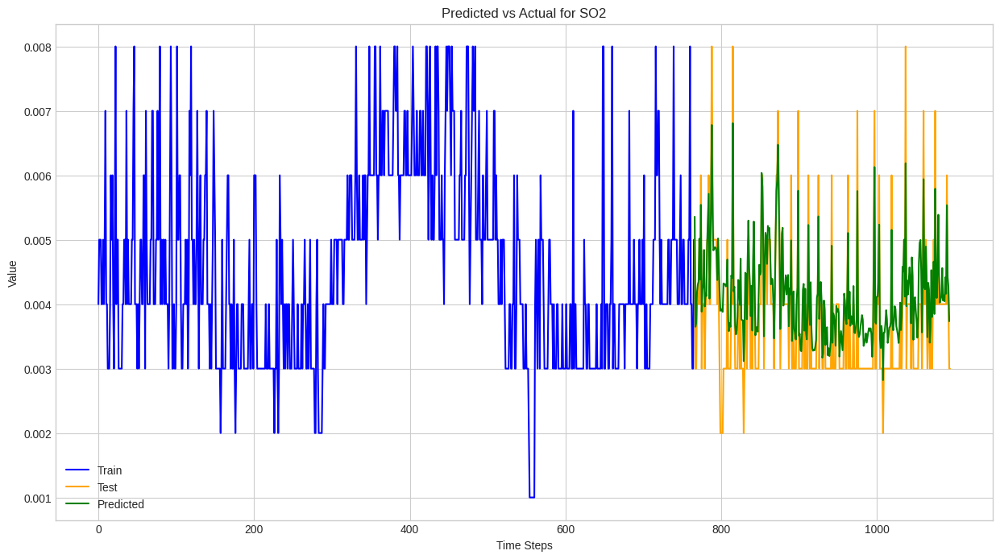

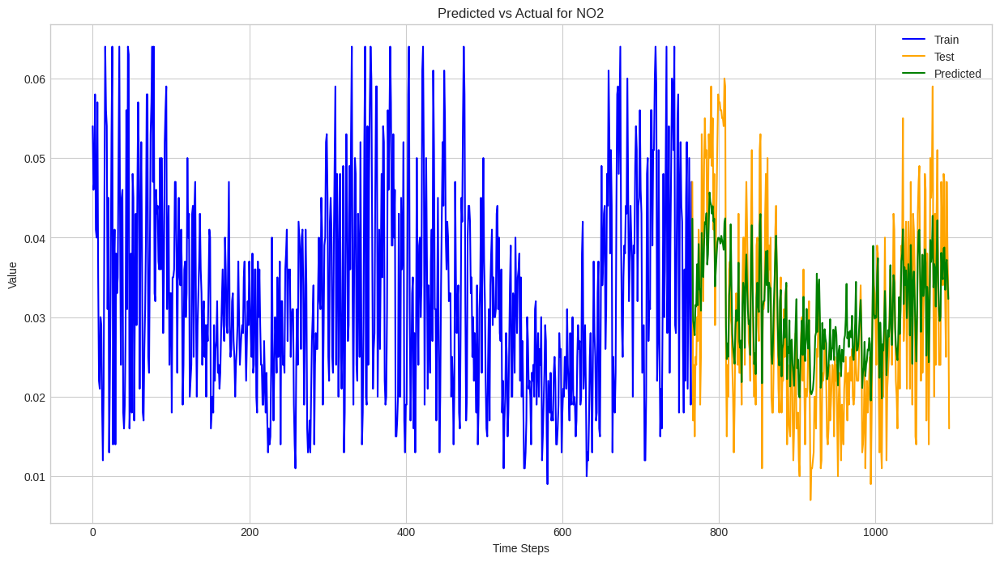

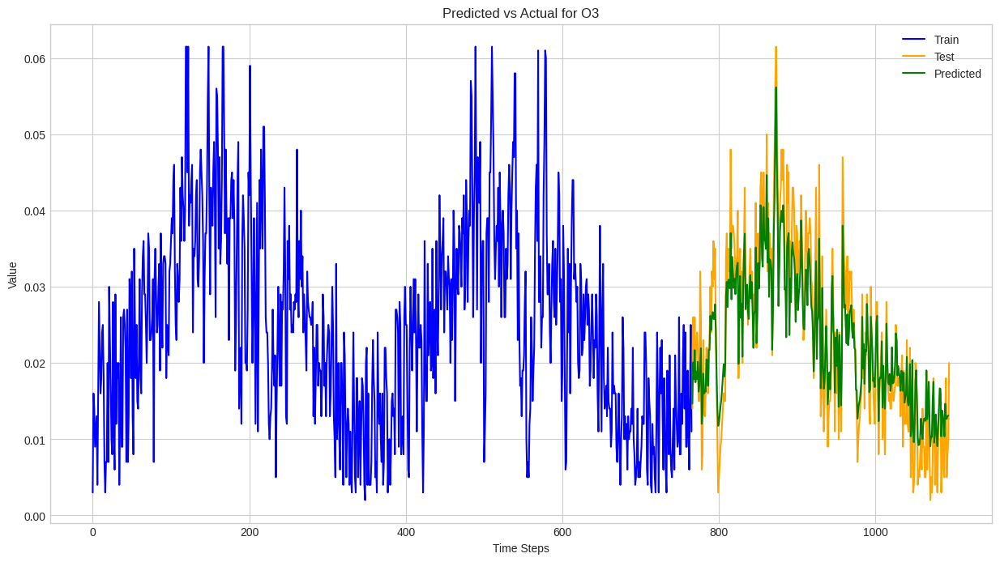

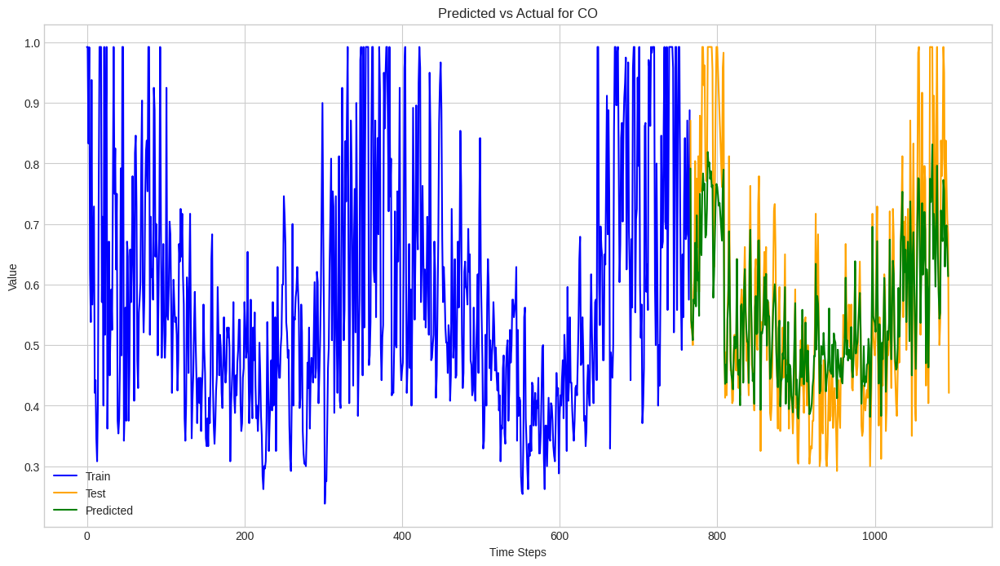

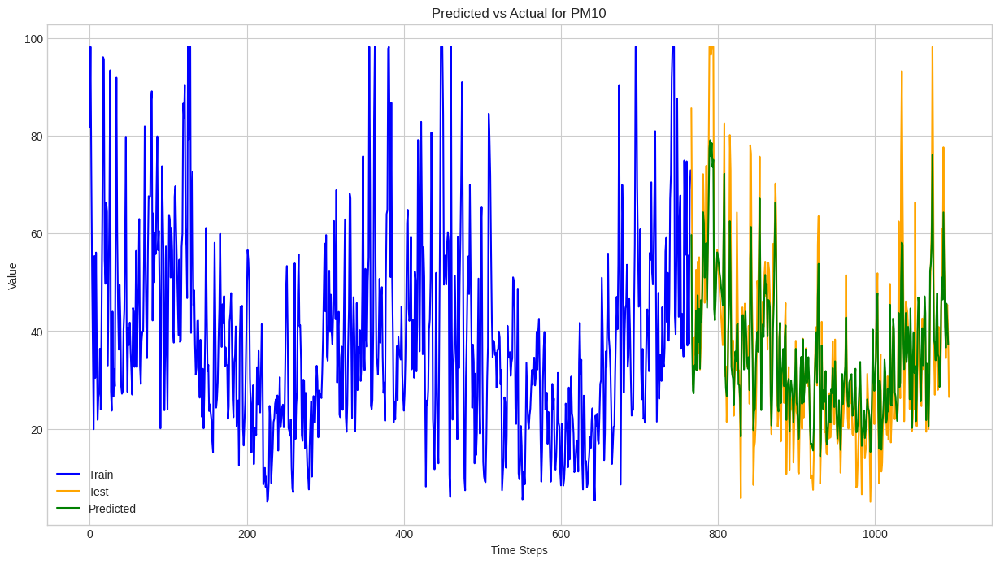

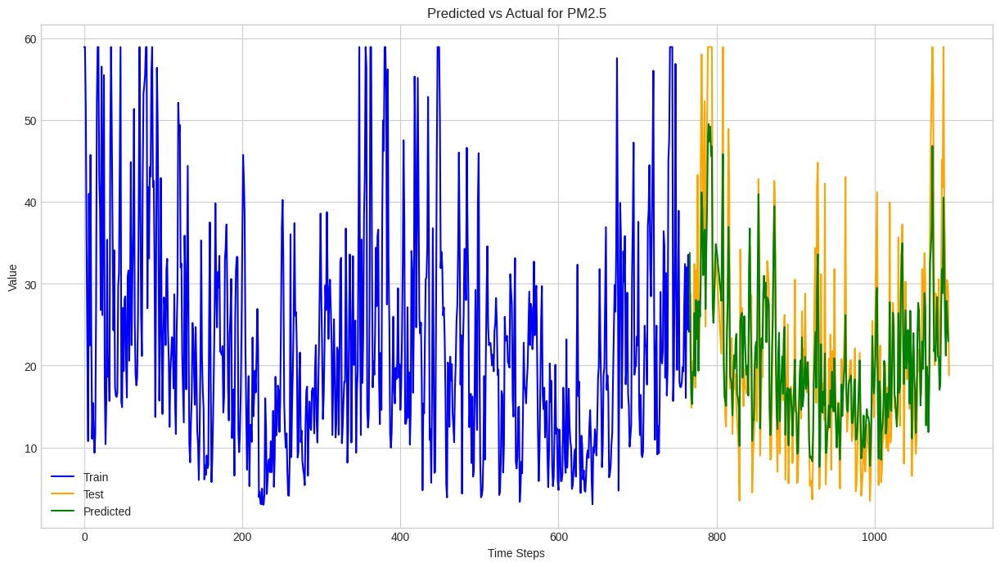

In [32]:
# Lakukan inverse transform pada data yang telah di-scale
df_train_inverse = scaler.inverse_transform(df_train_scaled)
df_test_inverse = scaler.inverse_transform(df_test_scaled)

# Plot training, test, dan predicted data
for i, pollutant in enumerate(pollutants):
    plt.figure(figsize=(15, 8))

    # Plot train data
    train_length = len(df_train)
    plt.plot(range(train_length), df_train_inverse[:, i], label='Train', color='blue')

    # Plot test data
    test_length = len(df_test)
    plt.plot(range(train_length, train_length + test_length), df_test_inverse[:, i], label='Test', color='orange')

    # Plot predicted data
    predicted_length = len(prediction)
    plt.plot(range(train_length, train_length + predicted_length), y_hat_inverse[:, i], label='Predicted', color='green')

    plt.xlabel('Time Steps')
    plt.ylabel('Value')
    plt.title(f'Predicted vs Actual for {pollutant}')
    plt.legend()
    plt.grid(True)
    plt.show()